# Final Project Notebook- Diamonds Data 

### Importing the Required Libraries and Our Data

In [2]:
# Load the required libraries

import numpy as np
import pandas as pd 
pd.set_option("display.max_columns", None)
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px
from scipy import stats
from scipy.stats import mode
from sklearn.preprocessing import StandardScaler
from sklearn.ensemble import RandomForestRegressor
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
import pickle 

In [3]:
# Load the data

df = pd.read_csv("../Data/Raw/diamonds.csv")

df

,Unnamed: 0,carat,cut,color,clarity,depth,table,price,x,y,z
0,1,0.23,Ideal,E,SI2,61.5,55.0,326,3.95,3.98,2.43
1,2,0.21,Premium,E,SI1,59.8,61.0,326,3.89,3.84,2.31
2,3,0.23,Good,E,VS1,56.9,65.0,327,4.05,4.07,2.31
3,4,0.29,Premium,I,VS2,62.4,58.0,334,4.20,4.23,2.63
4,5,0.31,Good,J,SI2,63.3,58.0,335,4.34,4.35,2.75
...,...,...,...,...,...,...,...,...,...,...,...
53935,53936,0.72,Ideal,D,SI1,60.8,57.0,2757,5.75,5.76,3.50
53936,53937,0.72,Good,D,SI1,63.1,55.0,2757,5.69,5.75,3.61
53937,53938,0.70,Very Good,D,SI1,62.8,60.0,2757,5.66,5.68,3.56
53938,53939,0.86,Premium,H,SI2,61.0,58.0,2757,6.15,6.12,3.74


### Cleaning and Initial Exploration of Data

In [4]:
df.columns

Index(['Unnamed: 0', 'carat', 'cut', 'color', 'clarity', 'depth', 'table',
       'price', 'x', 'y', 'z'],
      dtype='object')

In [5]:
df = df.drop(['Unnamed: 0'], axis=1)

df

,carat,cut,color,clarity,depth,table,price,x,y,z
0,0.23,Ideal,E,SI2,61.5,55.0,326,3.95,3.98,2.43
1,0.21,Premium,E,SI1,59.8,61.0,326,3.89,3.84,2.31
2,0.23,Good,E,VS1,56.9,65.0,327,4.05,4.07,2.31
3,0.29,Premium,I,VS2,62.4,58.0,334,4.20,4.23,2.63
4,0.31,Good,J,SI2,63.3,58.0,335,4.34,4.35,2.75
...,...,...,...,...,...,...,...,...,...,...
53935,0.72,Ideal,D,SI1,60.8,57.0,2757,5.75,5.76,3.50
53936,0.72,Good,D,SI1,63.1,55.0,2757,5.69,5.75,3.61
53937,0.70,Very Good,D,SI1,62.8,60.0,2757,5.66,5.68,3.56
53938,0.86,Premium,H,SI2,61.0,58.0,2757,6.15,6.12,3.74


In [6]:
df.isna().sum()

carat      0
cut        0
color      0
clarity    0
depth      0
table      0
price      0
x          0
y          0
z          0
dtype: int64

In [7]:
# Clean the data- create and apply a function that converts the ordinal categorical values to numerical values corresponding to the hierarchy of values

def clean(df):
    cut_map = {'Ideal': 5, 'Premium': 4, 'Very Good': 3, 'Good': 2, 'Fair': 1}
    color_map = {'D': 7, 'E': 6, 'F': 5, 'G': 4, 'H': 3, 'I': 2, 'J': 1}
    clarity_map = {'IF': 5, 'VVS1': 4, 'VVS2': 4, 'VS1': 3, 'VS2': 3, 'SI1': 2, 'SI2': 2, 'I1': 1}
    
    df['cut'] = df['cut'].map(cut_map)
    df['color'] = df['color'].map(color_map)
    df['clarity'] = df['clarity'].map(clarity_map)
    
    return df

In [8]:
df = clean(df)

In [9]:
df['cut'].value_counts()

5    21551
4    13791
3    12082
2     4906
1     1610
Name: cut, dtype: int64

In [10]:
df['color'].value_counts()

4    11292
6     9797
5     9542
3     8304
7     6775
2     5422
1     2808
Name: color, dtype: int64

In [11]:
df['clarity'].value_counts()

2    22259
3    20429
4     8721
5     1790
1      741
Name: clarity, dtype: int64

In [12]:
df.isna().sum()

carat      0
cut        0
color      0
clarity    0
depth      0
table      0
price      0
x          0
y          0
z          0
dtype: int64

In [13]:
df.columns

Index(['carat', 'cut', 'color', 'clarity', 'depth', 'table', 'price', 'x', 'y',
       'z'],
      dtype='object')

In [14]:
# Save the cleaned data

df.to_csv("../Data/Clean/clean_diamond_data.csv", index=False)

### Visualising our Data and Examining Relationships

In [15]:
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px

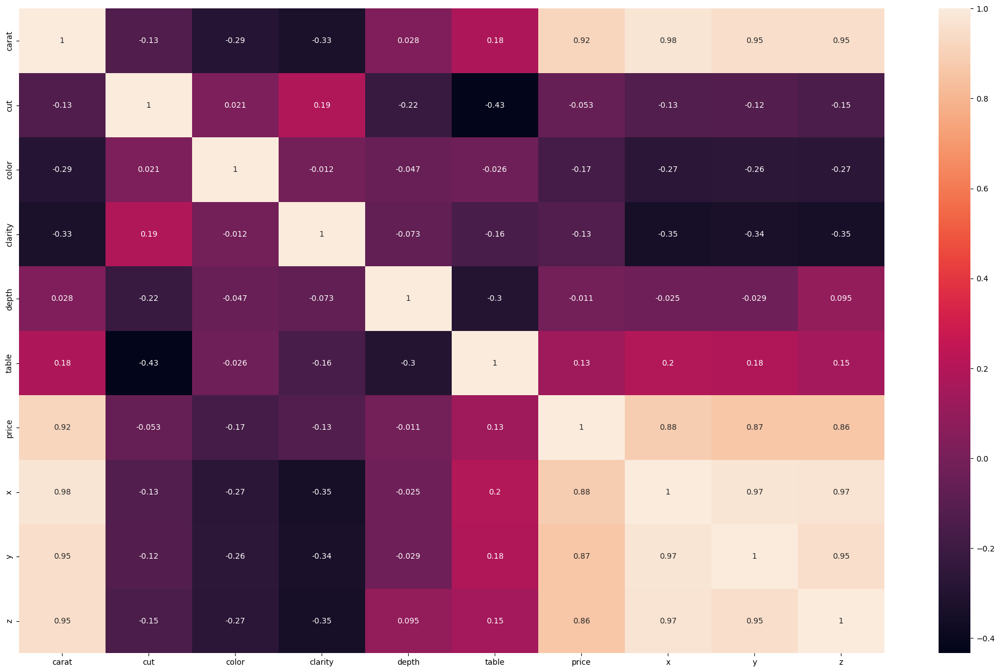

In [16]:
# Plotting a Correlation Matrix to detect any correlations or relationships

plt.figure(figsize=(25,15))
corr = df.corr()
sns.heatmap(corr, annot=True)
plt.show()

## Distribution Plot for Each Feature, Line and Scatter Plots Examining the Relationship Between a Feature and "Price"

### Distribution Plot for Carat

<Figure size 4000x1000 with 0 Axes>

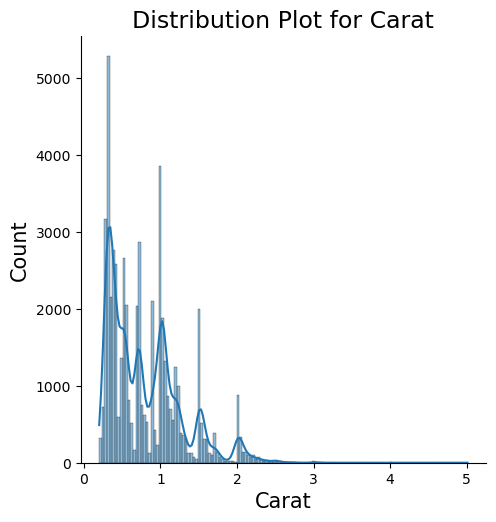

In [17]:
plt.figure(figsize=(40,10))
sns.displot(data=df, x="carat", kde=True)
plt.xlabel('Carat', fontsize=15)
plt.ylabel('Count', fontsize=15)
plt.title('Distribution Plot for Carat', fontsize=17)
plt.show()

### Line and Scatter Plots for Price and Carat

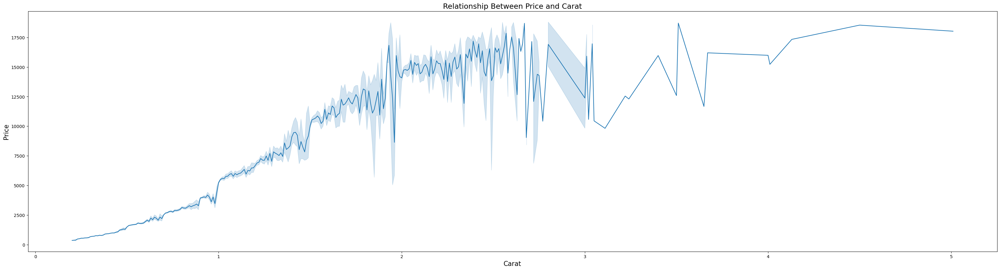

In [18]:
plt.figure(figsize=(40,10))
sns.lineplot(x='carat', y='price', data=df)
plt.xlabel('Carat', fontsize=15)
plt.ylabel('Price', fontsize=15)
plt.title('Relationship Between Price and Carat', fontsize=17)
plt.show()

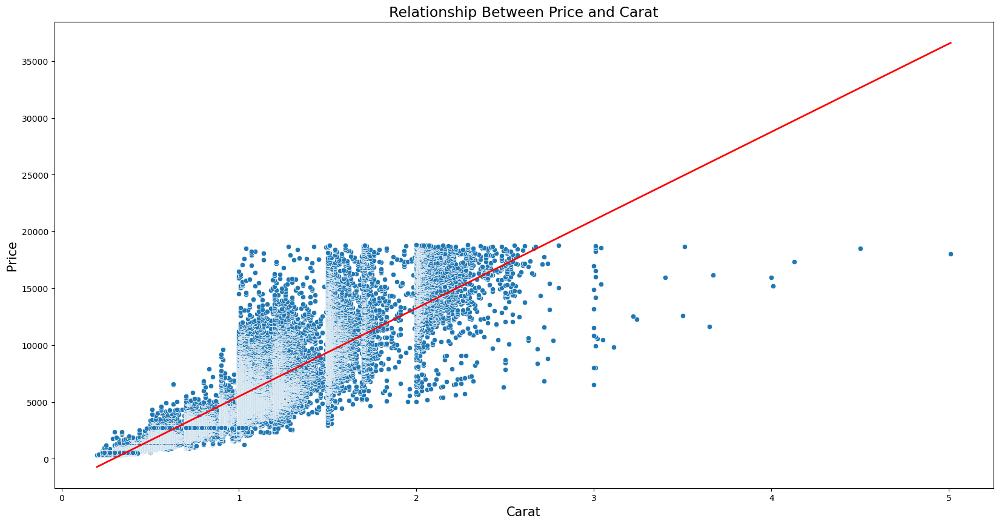

In [19]:
fig, ax = plt.subplots(figsize=(20,10))
sns.scatterplot(x='carat', y='price', data=df)

x = df['carat']
y = df['price']

slope, intercept = np.polyfit(x, y, 1)

reg_x = np.array([min(x), max(x)])
reg_y = slope * reg_x + intercept

ax.plot(reg_x,reg_y,color='red', linestyle='-', linewidth=2)

ax.set_xlabel('Carat', fontsize=15)
ax.set_ylabel('Price', fontsize=15)
ax.set_title('Relationship Between Price and Carat', fontsize=17)
plt.show()

### Distribution Plot for Cut

<Figure size 4000x1000 with 0 Axes>

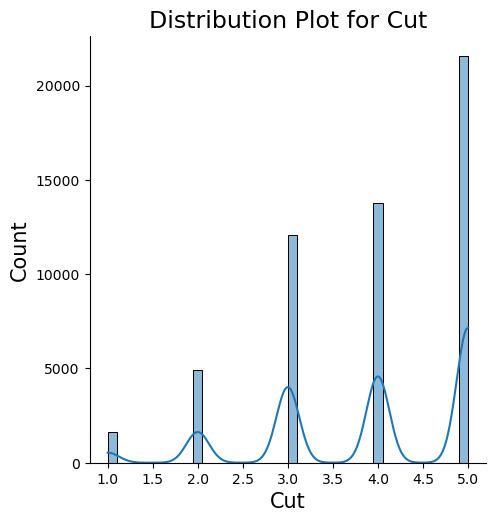

In [20]:
plt.figure(figsize=(40,10))
sns.displot(data=df, x="cut", kde=True)
plt.xlabel('Cut', fontsize=15)
plt.ylabel('Count', fontsize=15)
plt.title('Distribution Plot for Cut', fontsize=17)
plt.show()

### Line and Scatter Plots for Price and Cut

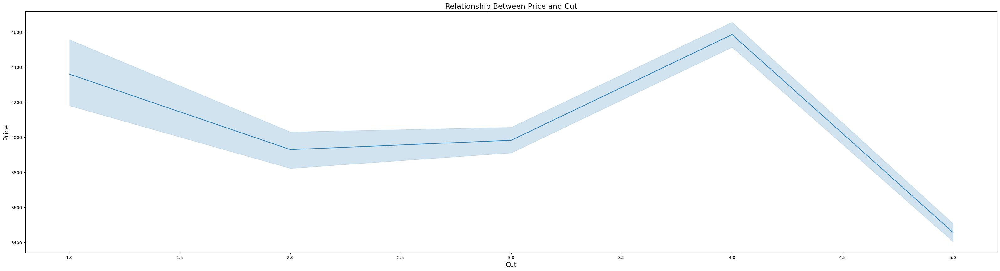

In [21]:
plt.figure(figsize=(40,10))
sns.lineplot(x='cut', y='price', data=df)
plt.xlabel('Cut', fontsize=15)
plt.ylabel('Price', fontsize=15)
plt.title('Relationship Between Price and Cut', fontsize=17)
plt.show()
plt.show()

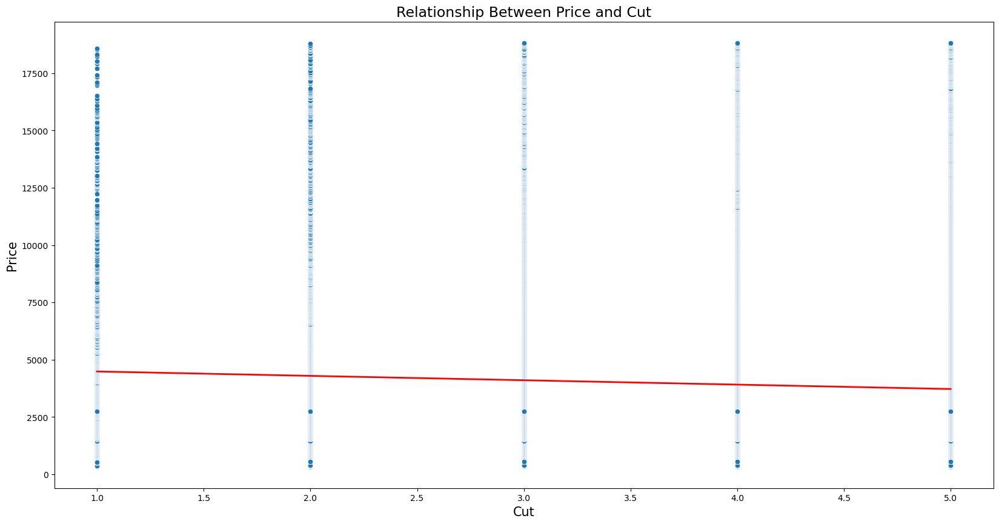

In [22]:
fig, ax = plt.subplots(figsize=(20,10))
sns.scatterplot(x='cut', y='price', data=df)

x = df['cut']
y = df['price']

slope, intercept = np.polyfit(x, y, 1)

reg_x = np.array([min(x), max(x)])
reg_y = slope * reg_x + intercept

ax.plot(reg_x,reg_y,color='red', linestyle='-', linewidth=2)

ax.set_xlabel('Cut', fontsize=15)
ax.set_ylabel('Price', fontsize=15)
ax.set_title('Relationship Between Price and Cut', fontsize=17)
plt.show()

### Distribution Plot for Color

<Figure size 4000x1000 with 0 Axes>

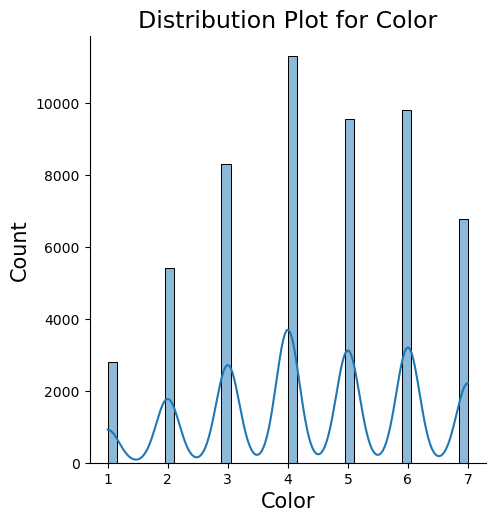

In [23]:
plt.figure(figsize=(40,10))
sns.displot(data=df, x="color", kde=True)
plt.xlabel('Color', fontsize=15)
plt.ylabel('Count', fontsize=15)
plt.title('Distribution Plot for Color', fontsize=17)
plt.show()

### Line and Scatter Plots for Price and Color

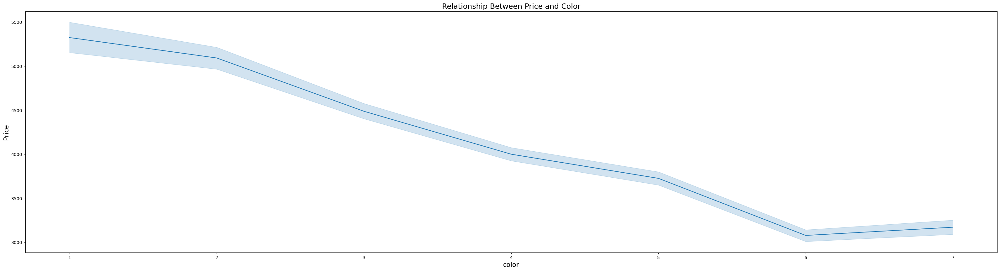

In [24]:
plt.figure(figsize=(40,10))
sns.lineplot(x='color', y='price', data=df)
plt.xlabel('color', fontsize=15)
plt.ylabel('Price', fontsize=15)
plt.title('Relationship Between Price and Color', fontsize=17)
plt.show()
plt.show()

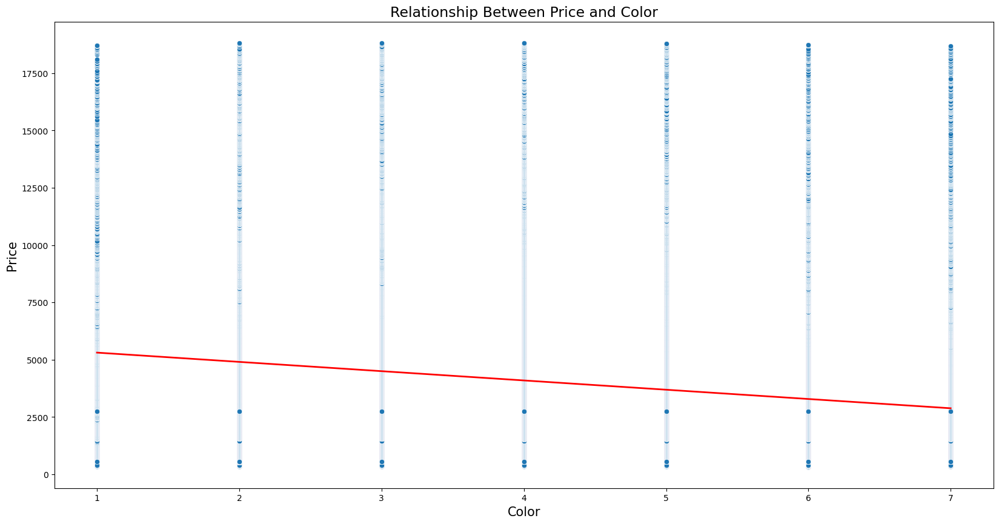

In [25]:
fig, ax = plt.subplots(figsize=(20,10))
sns.scatterplot(x='color', y='price', data=df)

x = df['color']
y = df['price']

slope, intercept = np.polyfit(x, y, 1)

reg_x = np.array([min(x), max(x)])
reg_y = slope * reg_x + intercept

ax.plot(reg_x,reg_y,color='red', linestyle='-', linewidth=2)

ax.set_xlabel('Color', fontsize=15)
ax.set_ylabel('Price', fontsize=15)
ax.set_title('Relationship Between Price and Color', fontsize=17)
plt.show()

### Distribution Plot for Clarity

<Figure size 4000x1000 with 0 Axes>

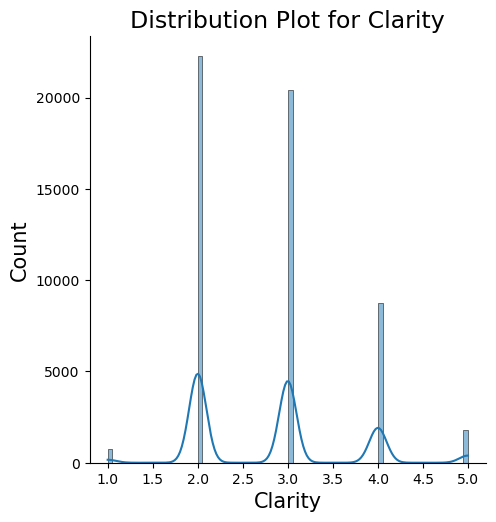

In [26]:
plt.figure(figsize=(40,10))
sns.displot(data=df, x="clarity", kde=True)
plt.xlabel('Clarity', fontsize=15)
plt.ylabel('Count', fontsize=15)
plt.title('Distribution Plot for Clarity', fontsize=17)
plt.show()

### Line and Scatter Plots for Price and Clarity

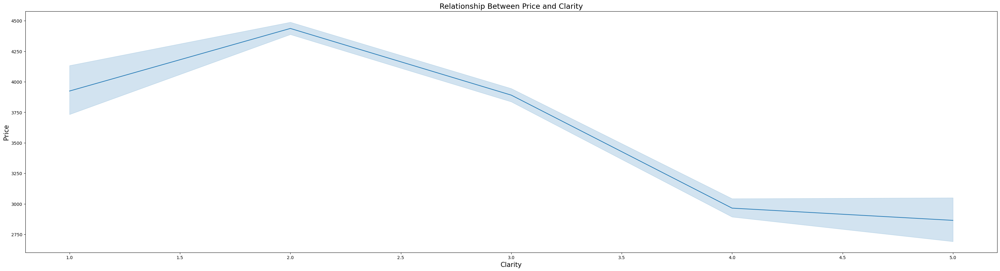

In [27]:
plt.figure(figsize=(40,10))
sns.lineplot(x='clarity', y='price', data=df)
plt.xlabel('Clarity', fontsize=15)
plt.ylabel('Price', fontsize=15)
plt.title('Relationship Between Price and Clarity', fontsize=17)
plt.show()
plt.show()

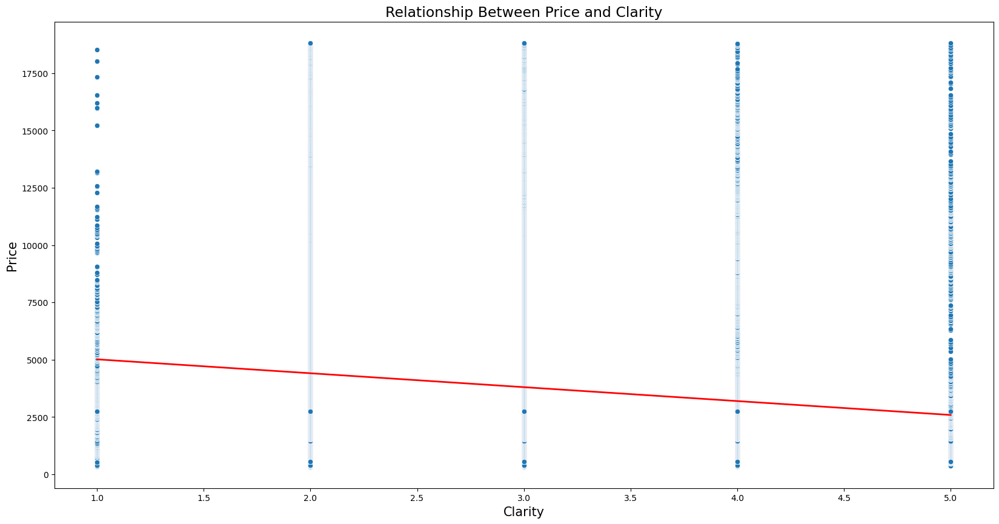

In [28]:
fig, ax = plt.subplots(figsize=(20,10))
sns.scatterplot(x='clarity', y='price', data=df)

x = df['clarity']
y = df['price']

slope, intercept = np.polyfit(x, y, 1)

reg_x = np.array([min(x), max(x)])
reg_y = slope * reg_x + intercept

ax.plot(reg_x,reg_y,color='red', linestyle='-', linewidth=2)

ax.set_xlabel('Clarity', fontsize=15)
ax.set_ylabel('Price', fontsize=15)
ax.set_title('Relationship Between Price and Clarity', fontsize=17)
plt.show()

### Distribution Plot for Depth

<Figure size 4000x1000 with 0 Axes>

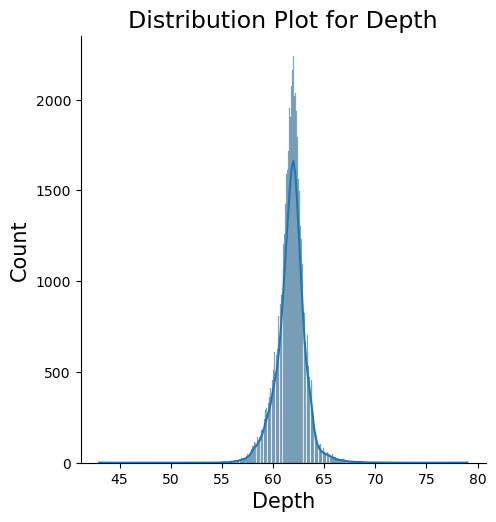

In [29]:
plt.figure(figsize=(40,10))
sns.displot(data=df, x="depth", kde=True)
plt.xlabel('Depth', fontsize=15)
plt.ylabel('Count', fontsize=15)
plt.title('Distribution Plot for Depth', fontsize=17)
plt.show()

### Line and Scatter Plots for Price and Depth

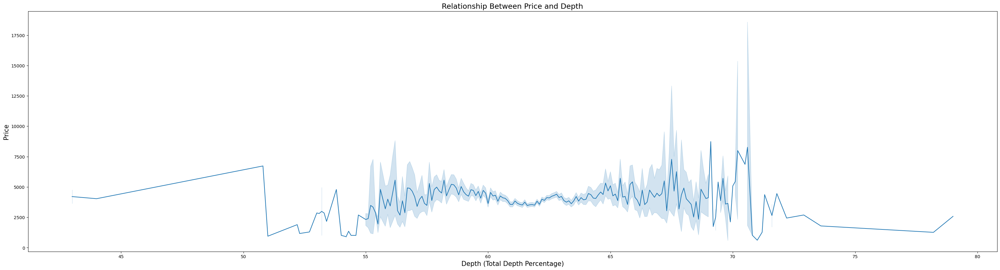

In [30]:
plt.figure(figsize=(40,10))
sns.lineplot(x='depth', y='price', data=df)
plt.xlabel('Depth (Total Depth Percentage)', fontsize=15)
plt.ylabel('Price', fontsize=15)
plt.title('Relationship Between Price and Depth', fontsize=17)
plt.show()

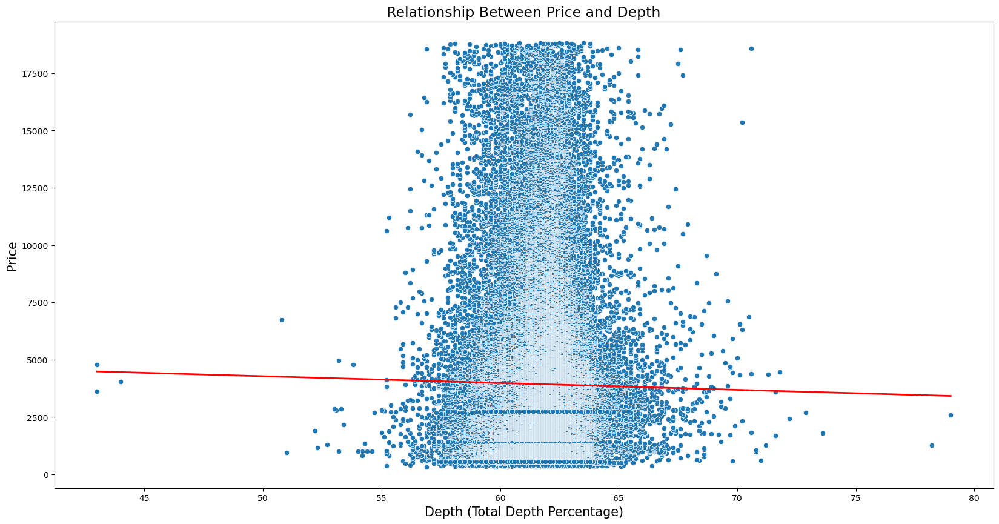

In [31]:
fig, ax = plt.subplots(figsize=(20,10))
sns.scatterplot(x='depth', y='price', data=df)

x = df['depth']
y = df['price']

slope, intercept = np.polyfit(x, y, 1)

reg_x = np.array([min(x), max(x)])
reg_y = slope * reg_x + intercept

ax.plot(reg_x,reg_y,color='red', linestyle='-', linewidth=2)

ax.set_xlabel('Depth (Total Depth Percentage)', fontsize=15)
ax.set_ylabel('Price', fontsize=15)
ax.set_title('Relationship Between Price and Depth', fontsize=17)
plt.show()

### Distribution Plot for Table

<Figure size 4000x1000 with 0 Axes>

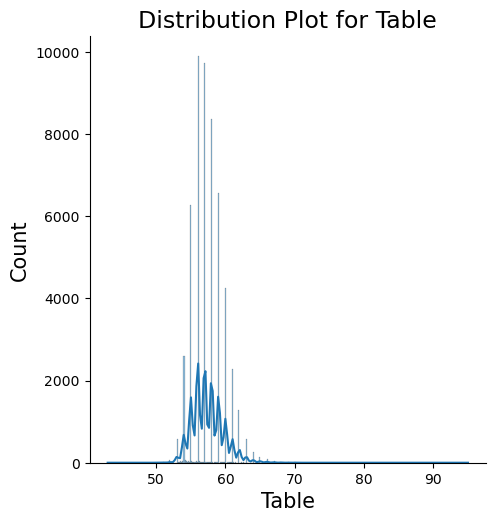

In [32]:
plt.figure(figsize=(40,10))
sns.displot(data=df, x="table", kde=True)
plt.xlabel('Table', fontsize=15)
plt.ylabel('Count', fontsize=15)
plt.title('Distribution Plot for Table', fontsize=17)
plt.show()

### Line and Scatter Plots for Price and Table 

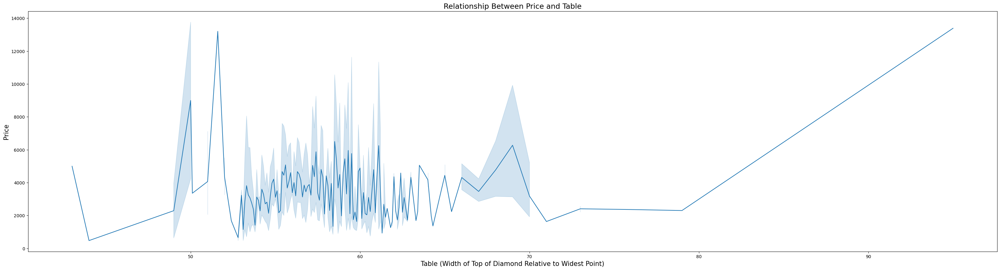

In [33]:
plt.figure(figsize=(40,10))
sns.lineplot(x='table', y='price', data=df)
plt.xlabel('Table (Width of Top of Diamond Relative to Widest Point)', fontsize=15)
plt.ylabel('Price', fontsize=15)
plt.title('Relationship Between Price and Table', fontsize=17)
plt.show()

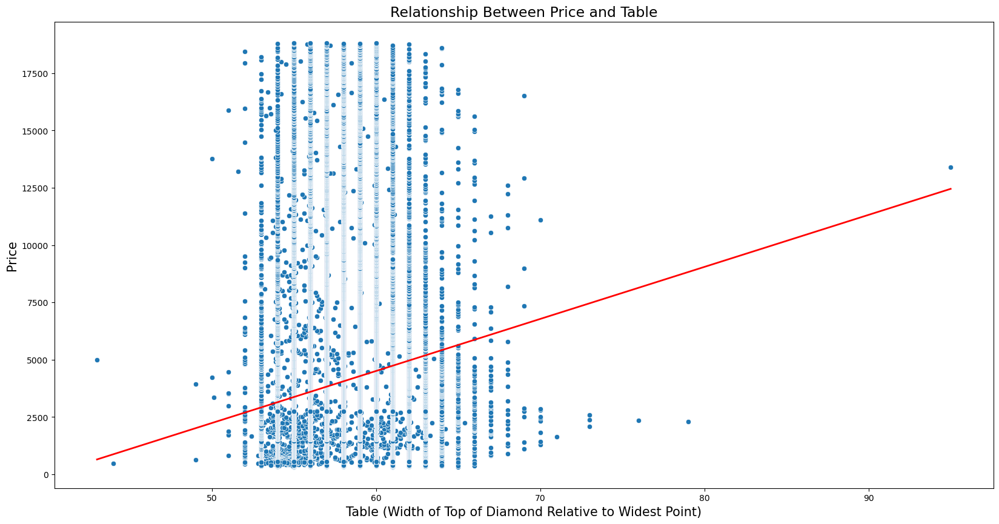

In [34]:
fig, ax = plt.subplots(figsize=(20,10))
sns.scatterplot(x='table', y='price', data=df)

x = df['table']
y = df['price']

slope, intercept = np.polyfit(x, y, 1)

reg_x = np.array([min(x), max(x)])
reg_y = slope * reg_x + intercept

ax.plot(reg_x,reg_y,color='red', linestyle='-', linewidth=2)

ax.set_xlabel('Table (Width of Top of Diamond Relative to Widest Point)', fontsize=15)
ax.set_ylabel('Price', fontsize=15)
ax.set_title('Relationship Between Price and Table', fontsize=17)
plt.show()

### Distribution Plot for Length

<Figure size 4000x1000 with 0 Axes>

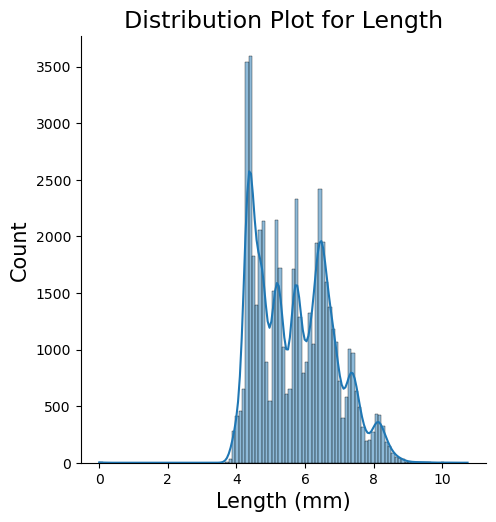

In [35]:
plt.figure(figsize=(40,10))
sns.displot(data=df, x="x", kde=True)
plt.xlabel('Length (mm)', fontsize=15)
plt.ylabel('Count', fontsize=15)
plt.title('Distribution Plot for Length', fontsize=17)
plt.show()

### Line and Scatter Plots for Price and Length

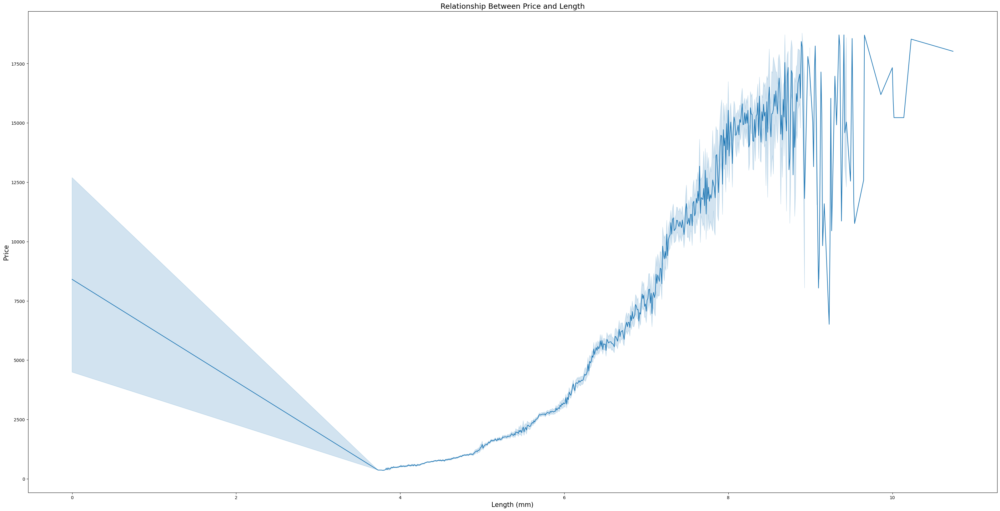

In [36]:
plt.figure(figsize=(40,20))
sns.lineplot(x='x', y='price', data=df)
plt.xlabel('Length (mm)', fontsize=15)
plt.ylabel('Price', fontsize=15)
plt.title('Relationship Between Price and Length', fontsize=17)
plt.show()

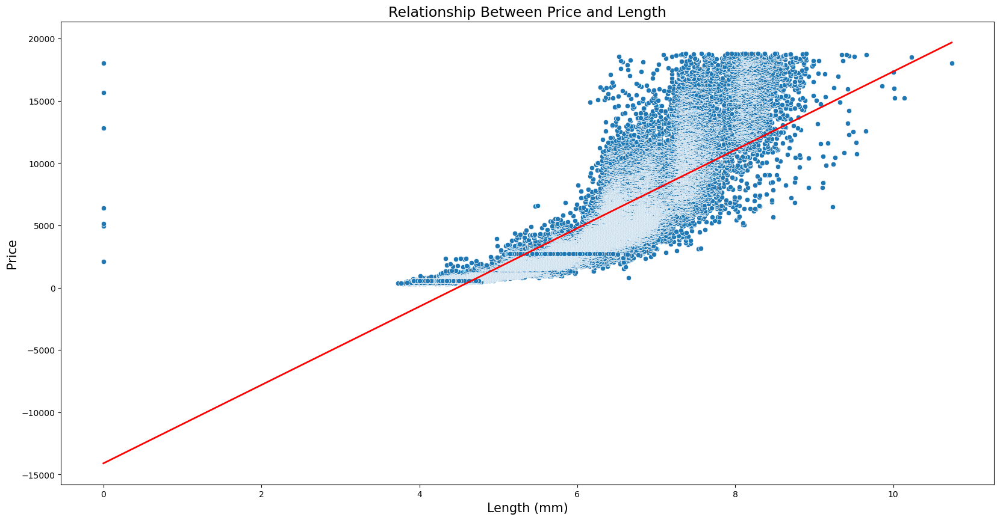

In [37]:
fig, ax = plt.subplots(figsize=(20,10))
sns.scatterplot(x='x', y='price', data=df)

x = df['x']
y = df['price']

slope, intercept = np.polyfit(x, y, 1)

reg_x = np.array([min(x), max(x)])
reg_y = slope * reg_x + intercept

ax.plot(reg_x,reg_y,color='red', linestyle='-', linewidth=2)

ax.set_xlabel('Length (mm)', fontsize=15)
ax.set_ylabel('Price', fontsize=15)
ax.set_title('Relationship Between Price and Length', fontsize=17)
plt.show()

### Distribution Plot for Width

<Figure size 4000x1000 with 0 Axes>

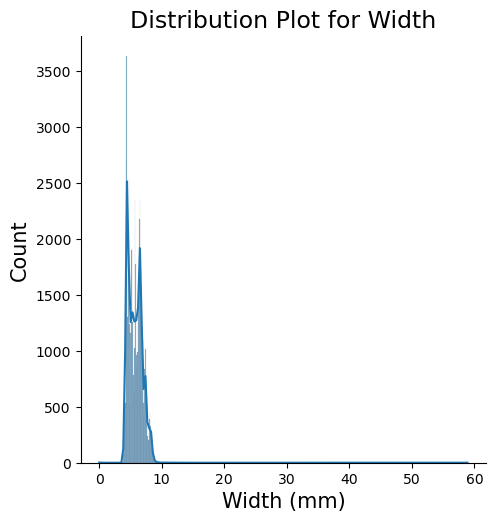

In [38]:
plt.figure(figsize=(40,10))
sns.displot(data=df, x="y", kde=True)
plt.xlabel('Width (mm)', fontsize=15)
plt.ylabel('Count', fontsize=15)
plt.title('Distribution Plot for Width', fontsize=17)
plt.show()

### Line and Scatter Plots for Price and Width

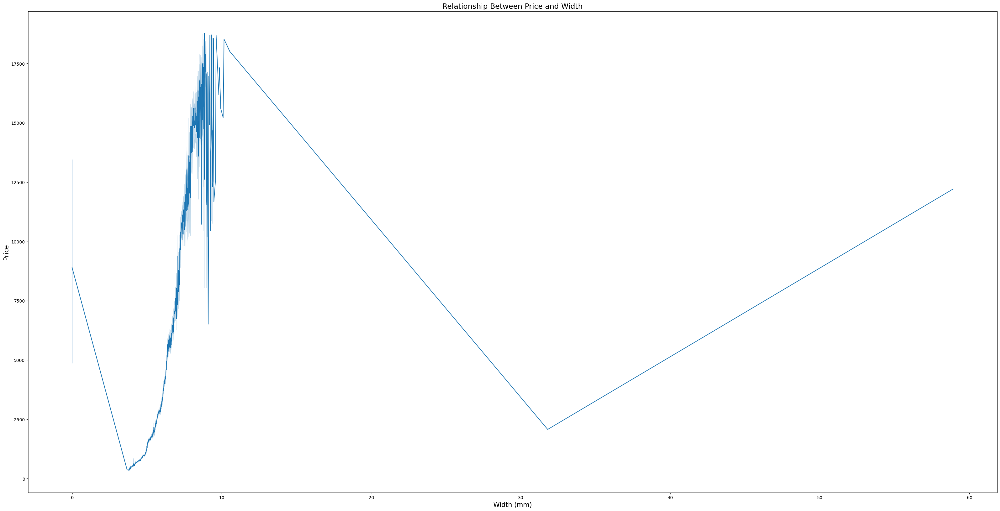

In [39]:
plt.figure(figsize=(40,20))
sns.lineplot(x='y', y='price', data=df)
plt.xlabel('Width (mm)', fontsize=15)
plt.ylabel('Price', fontsize=15)
plt.title('Relationship Between Price and Width', fontsize=17)
plt.show()

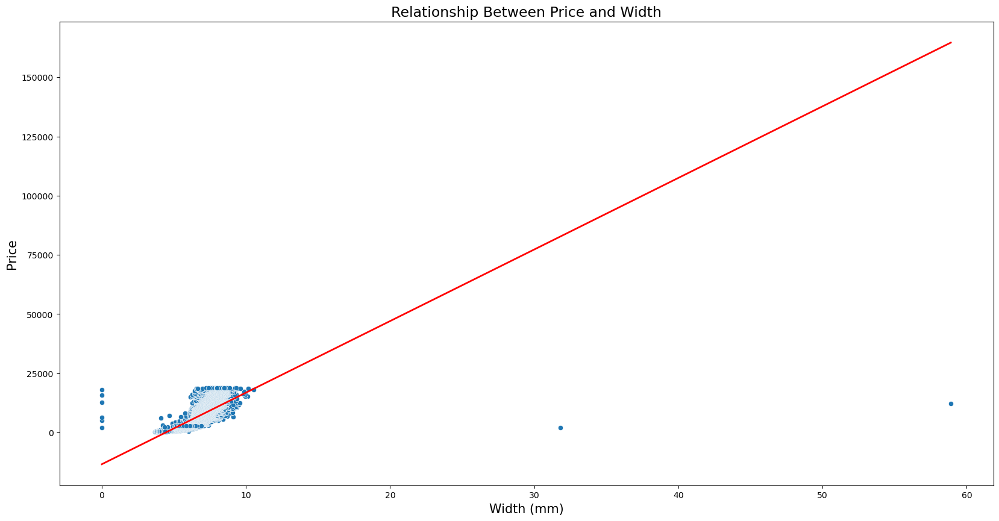

In [40]:
fig, ax = plt.subplots(figsize=(20,10))
sns.scatterplot(x='y', y='price', data=df)

x = df['y']
y = df['price']

slope, intercept = np.polyfit(x, y, 1)

reg_x = np.array([min(x), max(x)])
reg_y = slope * reg_x + intercept

ax.plot(reg_x,reg_y,color='red', linestyle='-', linewidth=2)

ax.set_xlabel('Width (mm)', fontsize=15)
ax.set_ylabel('Price', fontsize=15)
ax.set_title('Relationship Between Price and Width', fontsize=17)
plt.show()

### Distribution Plot for Depth

<Figure size 1000x1000 with 0 Axes>

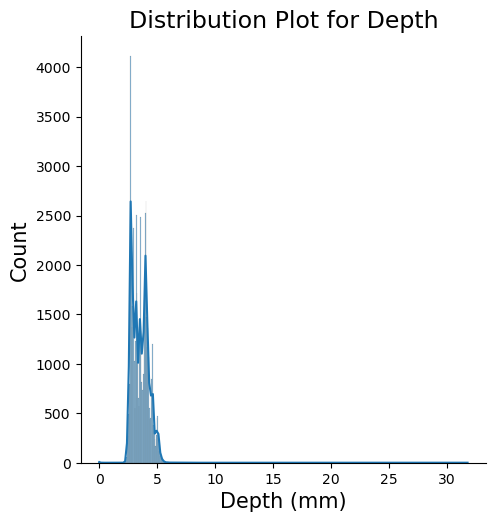

In [41]:
plt.figure(figsize=(10,10))
sns.displot(data=df, x="z", kde=True)
plt.xlabel('Depth (mm)', fontsize=15)
plt.ylabel('Count', fontsize=15)
plt.title('Distribution Plot for Depth', fontsize=17)
plt.show()

### Line and Scatter Plots for Price and Depth

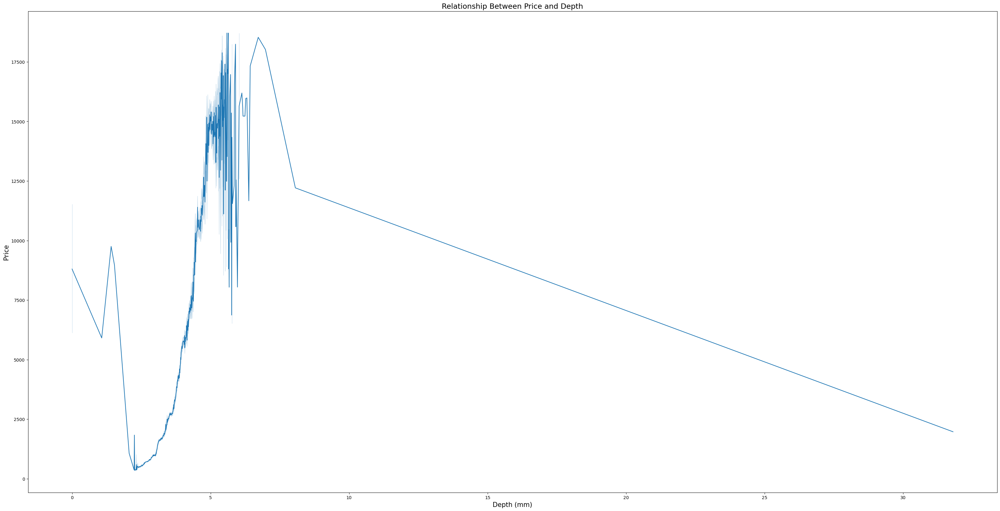

In [42]:
plt.figure(figsize=(40,20))
sns.lineplot(x='z', y='price', data=df)
plt.xlabel('Depth (mm)', fontsize=15)
plt.ylabel('Price', fontsize=15)
plt.title('Relationship Between Price and Depth', fontsize=17)
plt.show()

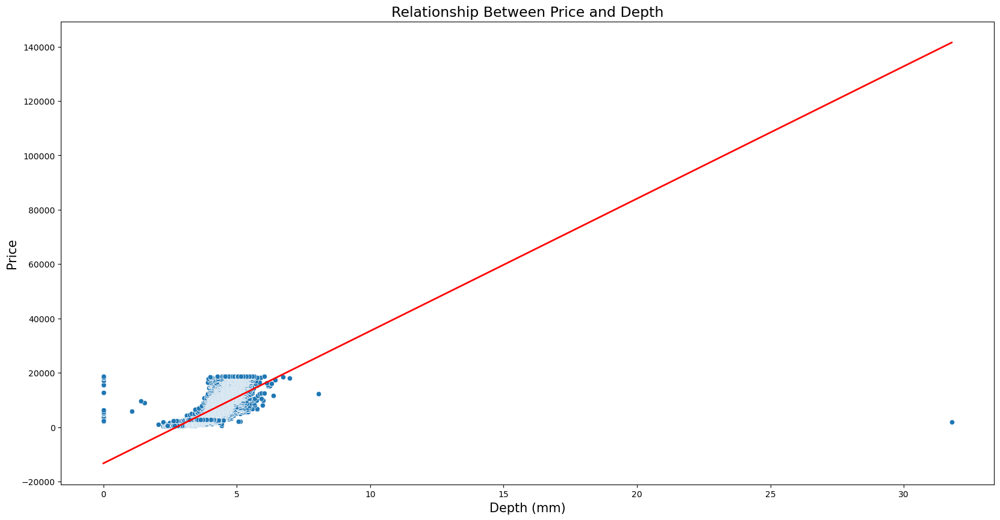

In [43]:
fig, ax = plt.subplots(figsize=(20,10))
sns.scatterplot(x='z', y='price', data=df)

x = df['z']
y = df['price']

slope, intercept = np.polyfit(x, y, 1)

reg_x = np.array([min(x), max(x)])
reg_y = slope * reg_x + intercept

ax.plot(reg_x,reg_y,color='red', linestyle='-', linewidth=2)

ax.set_xlabel('Depth (mm)', fontsize=15)
ax.set_ylabel('Price', fontsize=15)
ax.set_title('Relationship Between Price and Depth', fontsize=17)
plt.show()

### Examining Relationships of the Diamond Dimensions

### Line and Scatter Plots for Length and Width

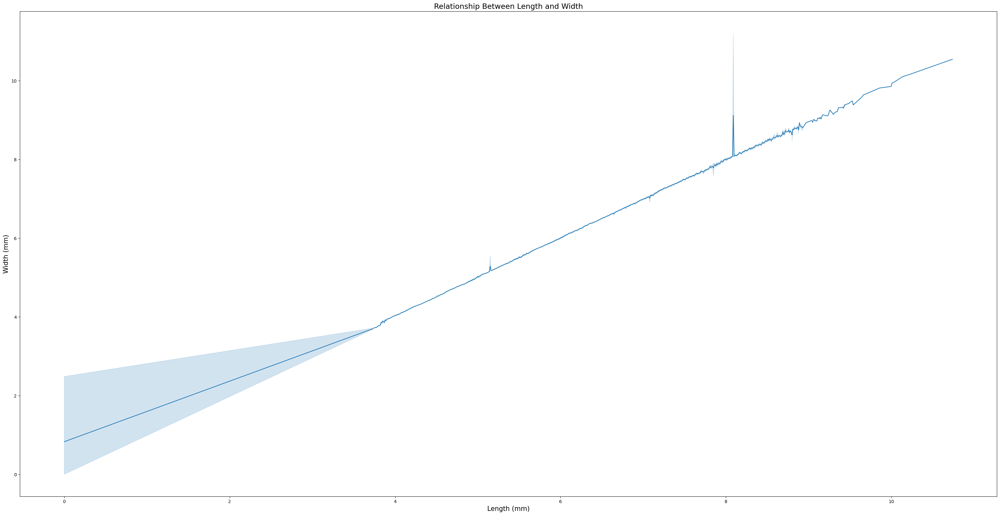

In [44]:
plt.figure(figsize=(40,20))
sns.lineplot(x='x', y='y', data=df)
plt.xlabel('Length (mm)', fontsize=15)
plt.ylabel('Width (mm)', fontsize=15)
plt.title('Relationship Between Length and Width', fontsize=17)
plt.show()

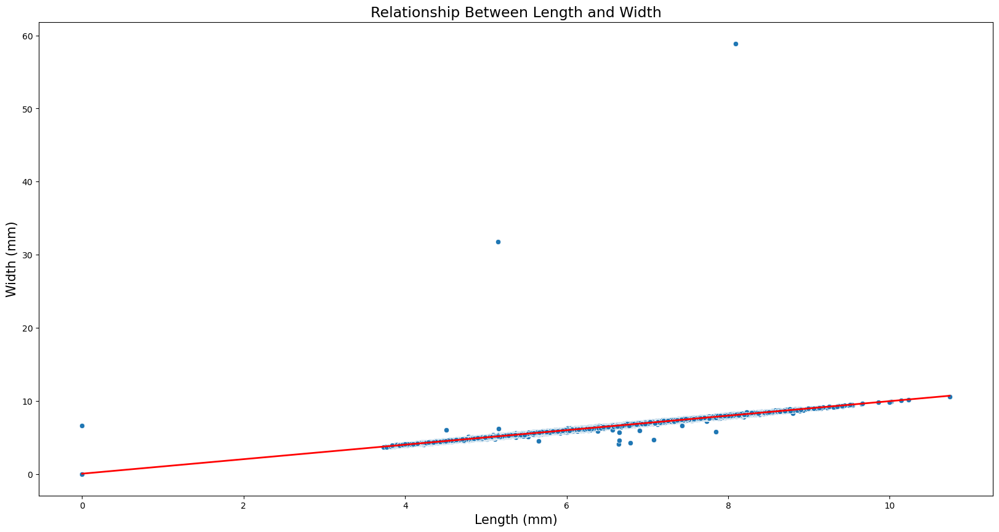

In [45]:
fig, ax = plt.subplots(figsize=(20,10))
sns.scatterplot(x='x', y='y', data=df)

x = df['x']
y = df['y']

slope, intercept = np.polyfit(x, y, 1)

reg_x = np.array([min(x), max(x)])
reg_y = slope * reg_x + intercept

ax.plot(reg_x,reg_y,color='red', linestyle='-', linewidth=2)

ax.set_xlabel('Length (mm)', fontsize=15)
ax.set_ylabel('Width (mm)', fontsize=15)
ax.set_title('Relationship Between Length and Width', fontsize=17)
plt.show()

### Line and Scatter Plots for Length and Depth

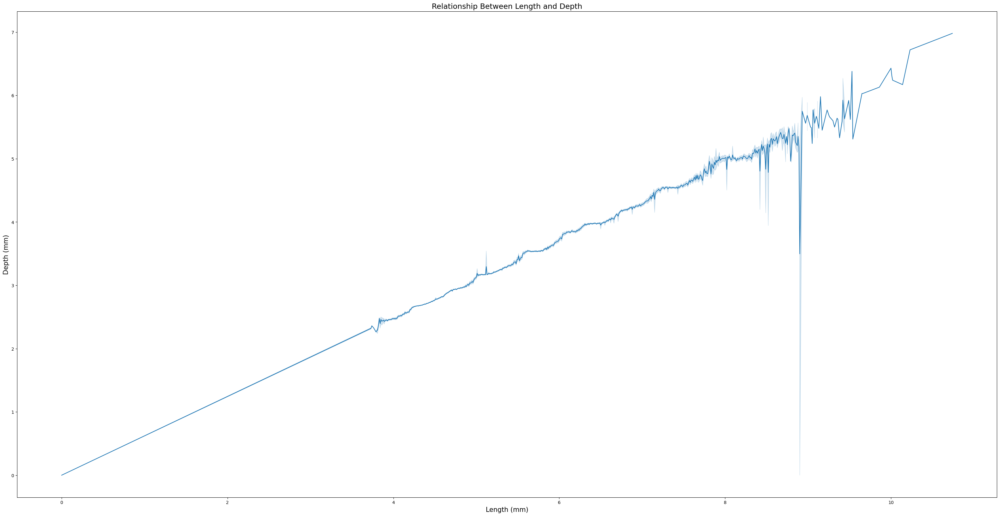

In [46]:
plt.figure(figsize=(40,20))
sns.lineplot(x='x', y='z', data=df)
plt.xlabel('Length (mm)', fontsize=15)
plt.ylabel('Depth (mm)', fontsize=15)
plt.title('Relationship Between Length and Depth', fontsize=17)
plt.show()

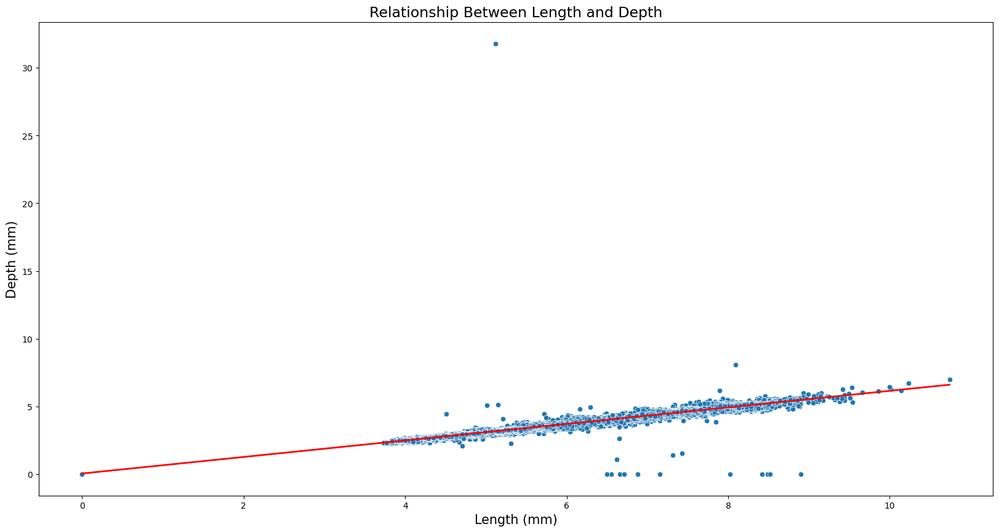

In [47]:
fig, ax = plt.subplots(figsize=(20,10))
sns.scatterplot(x='x', y='z', data=df)

x = df['x']
y = df['z']

slope, intercept = np.polyfit(x, y, 1)

reg_x = np.array([min(x), max(x)])
reg_y = slope * reg_x + intercept

ax.plot(reg_x,reg_y,color='red', linestyle='-', linewidth=2)

ax.set_xlabel('Length (mm)', fontsize=15)
ax.set_ylabel('Depth (mm)', fontsize=15)
ax.set_title('Relationship Between Length and Depth', fontsize=17)
plt.show()

### Scatter and Line Plots for Width and Length

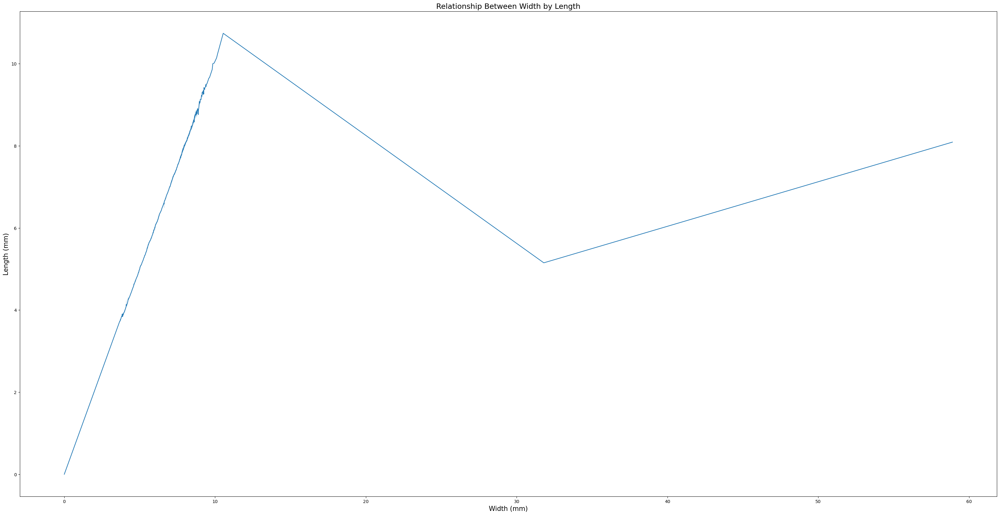

In [48]:
plt.figure(figsize=(40,20))
sns.lineplot(x='y', y='x', data=df)
plt.xlabel('Width (mm)', fontsize=15)
plt.ylabel('Length (mm)', fontsize=15)
plt.title('Relationship Between Width by Length', fontsize=17)
plt.show()

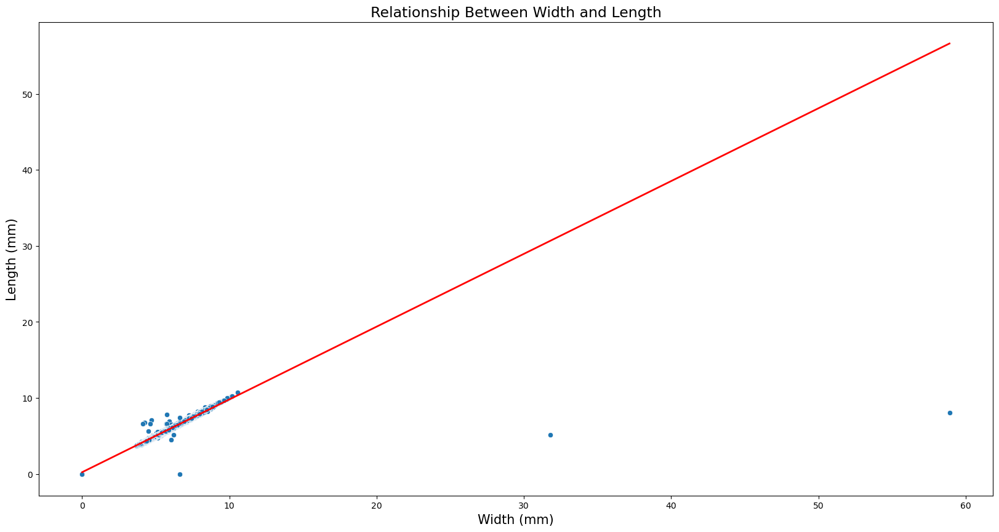

In [49]:
fig, ax = plt.subplots(figsize=(20,10))
sns.scatterplot(x='y', y='x', data=df)

x = df['y']
y = df['x']

slope, intercept = np.polyfit(x, y, 1)

reg_x = np.array([min(x), max(x)])
reg_y = slope * reg_x + intercept

ax.plot(reg_x,reg_y,color='red', linestyle='-', linewidth=2)

ax.set_xlabel('Width (mm)', fontsize=15)
ax.set_ylabel('Length (mm)', fontsize=15)
ax.set_title('Relationship Between Width and Length', fontsize=17)
plt.show()

### Line and Scatter Plots for Width by Depth

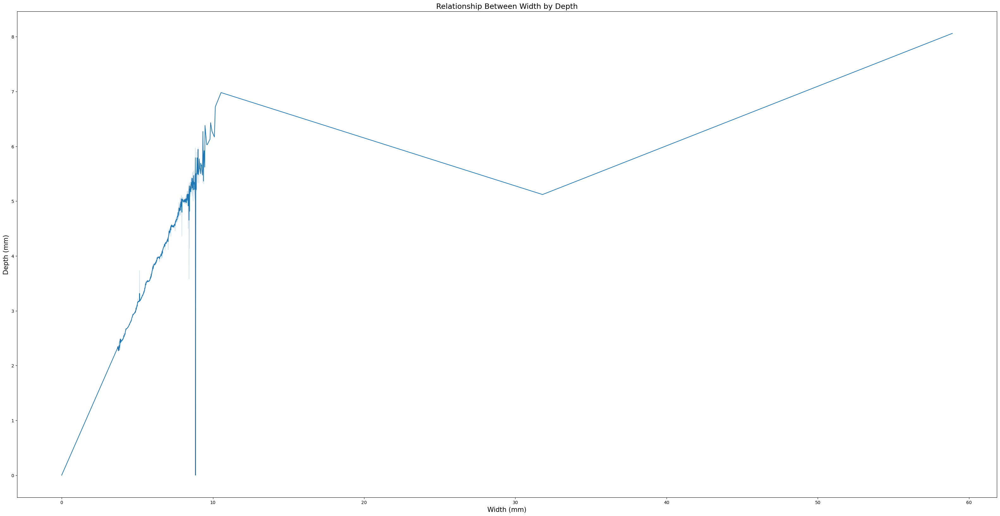

In [50]:
plt.figure(figsize=(40,20))
sns.lineplot(x='y', y='z', data=df)
plt.xlabel('Width (mm)', fontsize=15)
plt.ylabel('Depth (mm)', fontsize=15)
plt.title('Relationship Between Width by Depth', fontsize=17)
plt.show()

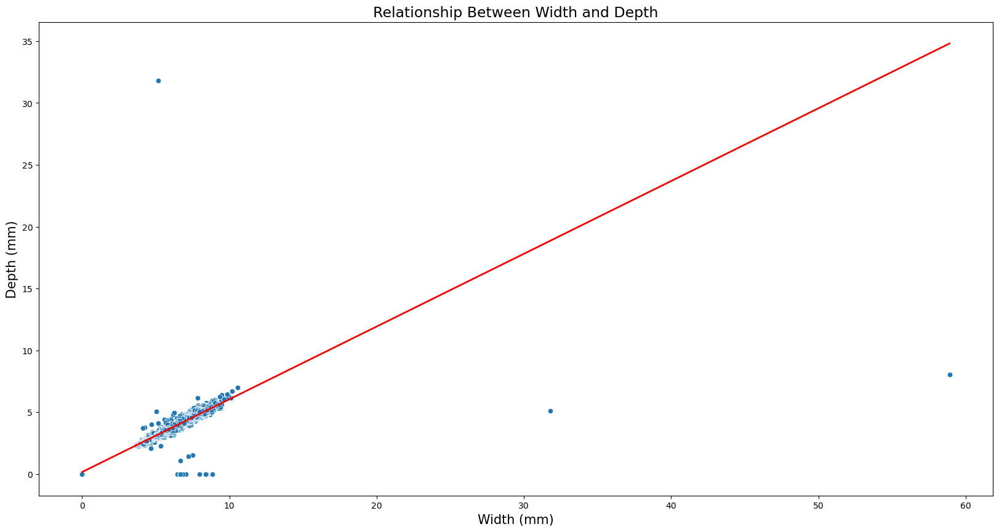

In [51]:
fig, ax = plt.subplots(figsize=(20,10))
sns.scatterplot(x='y', y='z', data=df)

x = df['y']
y = df['z']

slope, intercept = np.polyfit(x, y, 1)

reg_x = np.array([min(x), max(x)])
reg_y = slope * reg_x + intercept

ax.plot(reg_x,reg_y,color='red', linestyle='-', linewidth=2)

ax.set_xlabel('Width (mm)', fontsize=15)
ax.set_ylabel('Depth (mm)', fontsize=15)
ax.set_title('Relationship Between Width and Depth', fontsize=17)
plt.show()

### Line and Scatter Plots for Table and Length

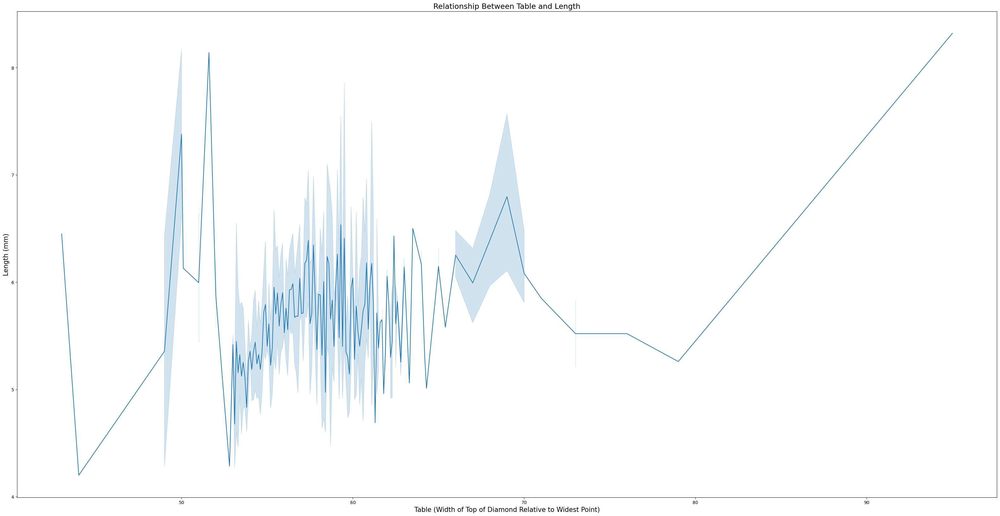

In [52]:
plt.figure(figsize=(40,20))
sns.lineplot(x='table', y='x', data=df)
plt.xlabel('Table (Width of Top of Diamond Relative to Widest Point)', fontsize=15)
plt.ylabel('Length (mm)', fontsize=15)
plt.title('Relationship Between Table and Length', fontsize=17)
plt.show()

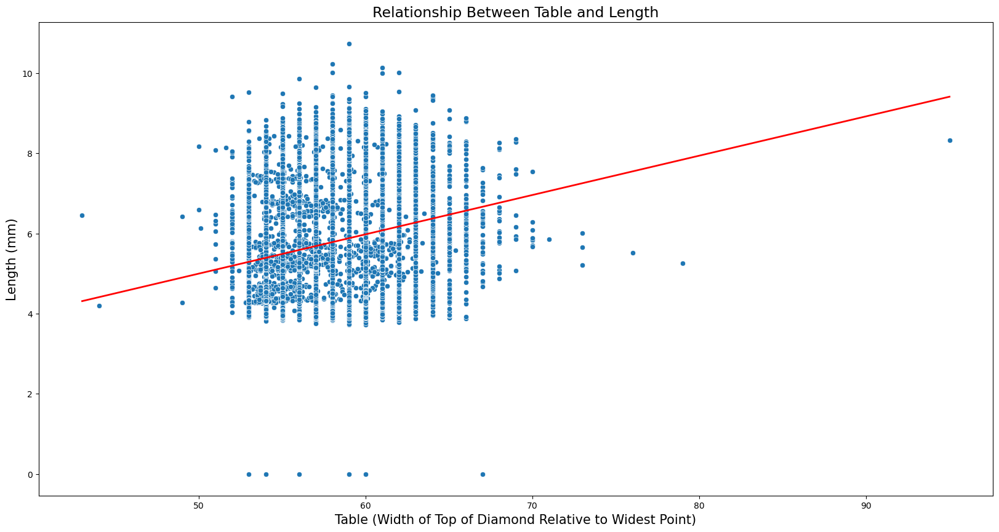

In [53]:
fig, ax = plt.subplots(figsize=(20,10))
sns.scatterplot(x='table', y='x', data=df)

x = df['table']
y = df['x']

slope, intercept = np.polyfit(x, y, 1)

reg_x = np.array([min(x), max(x)])
reg_y = slope * reg_x + intercept

ax.plot(reg_x,reg_y,color='red', linestyle='-', linewidth=2)

ax.set_xlabel('Table (Width of Top of Diamond Relative to Widest Point)', fontsize=15)
ax.set_ylabel('Length (mm)', fontsize=15)
ax.set_title('Relationship Between Table and Length', fontsize=17)
plt.show()

### Line and Scatter Plots for Table and Width

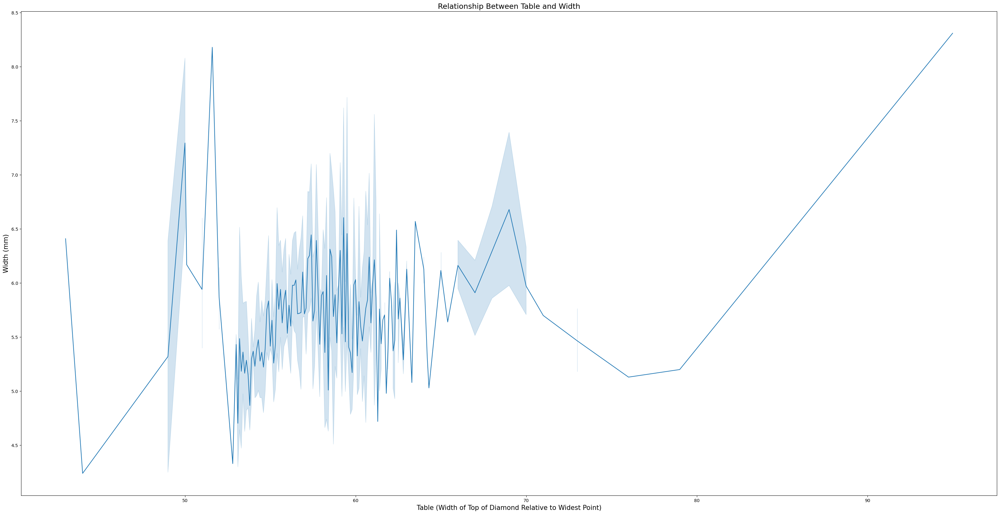

In [54]:
plt.figure(figsize=(40,20))
sns.lineplot(x='table', y='y', data=df)
plt.xlabel('Table (Width of Top of Diamond Relative to Widest Point)', fontsize=15)
plt.ylabel('Width (mm)', fontsize=15)
plt.title('Relationship Between Table and Width', fontsize=17)
plt.show()

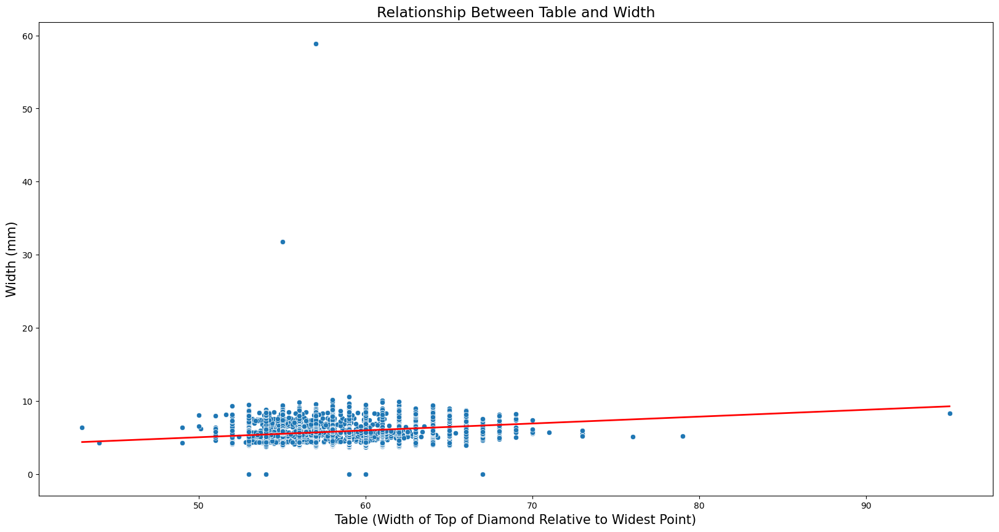

In [55]:
fig, ax = plt.subplots(figsize=(20,10))
sns.scatterplot(x='table', y='y', data=df)

x = df['table']
y = df['y']

slope, intercept = np.polyfit(x, y, 1)

reg_x = np.array([min(x), max(x)])
reg_y = slope * reg_x + intercept

ax.plot(reg_x,reg_y,color='red', linestyle='-', linewidth=2)

ax.set_xlabel('Table (Width of Top of Diamond Relative to Widest Point)', fontsize=15)
ax.set_ylabel('Width (mm)', fontsize=15)
ax.set_title('Relationship Between Table and Width', fontsize=17)
plt.show()

### Line and Scatter Plots for Table and Depth

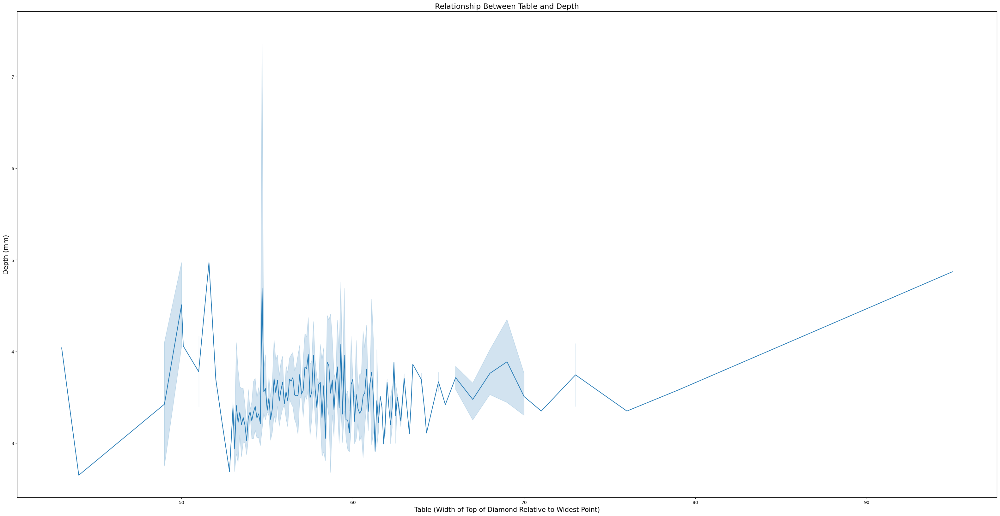

In [56]:
plt.figure(figsize=(40,20))
sns.lineplot(x='table', y='z', data=df)
plt.xlabel('Table (Width of Top of Diamond Relative to Widest Point)', fontsize=15)
plt.ylabel('Depth (mm)', fontsize=15)
plt.title('Relationship Between Table and Depth', fontsize=17)
plt.show()

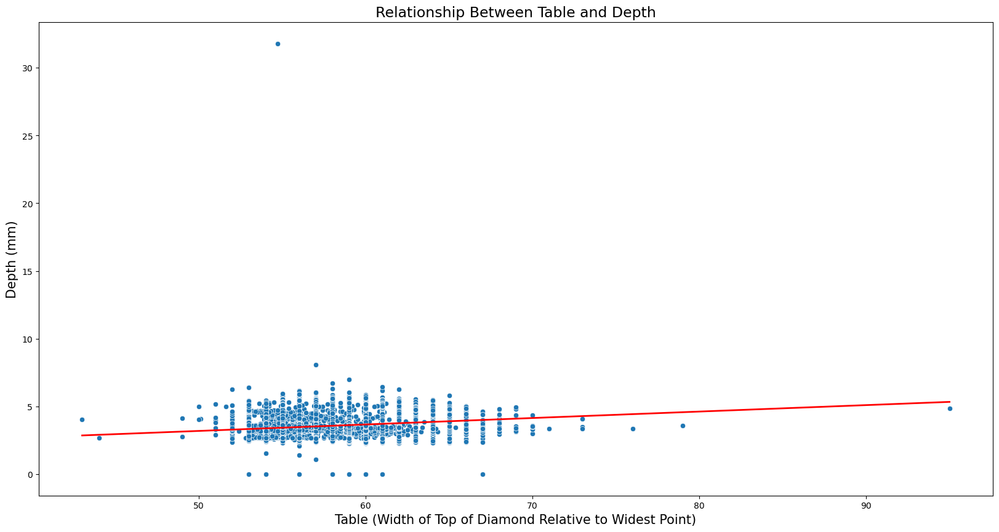

In [57]:
fig, ax = plt.subplots(figsize=(20,10))
sns.scatterplot(x='table', y='z', data=df)

x = df['table']
y = df['z']

slope, intercept = np.polyfit(x, y, 1)

reg_x = np.array([min(x), max(x)])
reg_y = slope * reg_x + intercept

ax.plot(reg_x,reg_y,color='red', linestyle='-', linewidth=2)

ax.set_xlabel('Table (Width of Top of Diamond Relative to Widest Point)', fontsize=15)
ax.set_ylabel('Depth (mm)', fontsize=15)
ax.set_title('Relationship Between Table and Depth', fontsize=17)
plt.show()

### Plotting Box Plots and Getting Descriptive Statistics From Our Data 

In [58]:
# Create a copy of the dataset to continue exploring it further

df2 = df.copy()

df2

,carat,cut,color,clarity,depth,table,price,x,y,z
0,0.23,5,6,2,61.5,55.0,326,3.95,3.98,2.43
1,0.21,4,6,2,59.8,61.0,326,3.89,3.84,2.31
2,0.23,2,6,3,56.9,65.0,327,4.05,4.07,2.31
3,0.29,4,2,3,62.4,58.0,334,4.20,4.23,2.63
4,0.31,2,1,2,63.3,58.0,335,4.34,4.35,2.75
...,...,...,...,...,...,...,...,...,...,...
53935,0.72,5,7,2,60.8,57.0,2757,5.75,5.76,3.50
53936,0.72,2,7,2,63.1,55.0,2757,5.69,5.75,3.61
53937,0.70,3,7,2,62.8,60.0,2757,5.66,5.68,3.56
53938,0.86,4,3,2,61.0,58.0,2757,6.15,6.12,3.74


In [59]:
# Create and apply a function that will print some relevant descriptive statistics for the data

def compute_stats(df):
    stats_list = []
    for column in df.columns:
        q1 = df[column].quantile(0.25)
        q2 = df[column].quantile(0.5)
        q3 = df[column].quantile(0.75)
        
        mean = df[column].mean()
        median = df[column].median()
        mode = stats.mode((df[column]), keepdims=True)[0][0]
        
        std_dev = df[column].std()
        
        stats_list.append([column, q1, q2, q3, mean, median, mode, std_dev])
    
    return stats_list


In [60]:
df_stats = pd.DataFrame(compute_stats(df2), columns=['Column', 'Q1', 'Q2', 'Q3', 'Mean', 'Median', 'Mode', 'Standard Deviation'])

df_stats

,Column,Q1,Q2,Q3,Mean,Median,Mode,Standard Deviation
0,carat,0.40,0.70,1.04,0.797940,0.70,0.30,0.474011
1,cut,3.00,4.00,5.00,3.904097,4.00,5.00,1.116600
2,color,3.00,4.00,6.00,4.405803,4.00,4.00,1.701105
3,clarity,2.00,3.00,3.00,2.787912,3.00,2.00,0.846796
4,depth,61.00,61.80,62.50,61.749405,61.80,62.00,1.432621
5,table,56.00,57.00,59.00,57.457184,57.00,56.00,2.234491
6,price,950.00,2401.00,5324.25,3932.799722,2401.00,605.00,3989.439738
7,x,4.71,5.70,6.54,5.731157,5.70,4.37,1.121761
8,y,4.72,5.71,6.54,5.734526,5.71,4.34,1.142135
9,z,2.91,3.53,4.04,3.538734,3.53,2.70,0.705699


In [61]:
# Flip the data 

df_transposed = df_stats.T

In [62]:
transposed_df = pd.DataFrame(df_transposed)
transposed_df.columns = transposed_df.iloc[0]
transposed_df = transposed_df.drop('Column')
stats_df = transposed_df

stats_df

Column,carat,cut,color,clarity,depth,table,price,x,y,z
Q1,0.4,3.0,3.0,2.0,61.0,56.0,950.0,4.71,4.72,2.91
Q2,0.7,4.0,4.0,3.0,61.8,57.0,2401.0,5.7,5.71,3.53
Q3,1.04,5.0,6.0,3.0,62.5,59.0,5324.25,6.54,6.54,4.04
Mean,0.79794,3.904097,4.405803,2.787912,61.749405,57.457184,3932.799722,5.731157,5.734526,3.538734
Median,0.7,4.0,4.0,3.0,61.8,57.0,2401.0,5.7,5.71,3.53
Mode,0.3,5.0,4.0,2.0,62.0,56.0,605.0,4.37,4.34,2.7
Standard Deviation,0.474011,1.1166,1.701105,0.846796,1.432621,2.234491,3989.439738,1.121761,1.142135,0.705699


In [63]:
# Create and apply a function that will plot box-and-whisker plots for all of the features and the Interquartile Range to the right 

def plot_boxplots_iqr(dataframe):
    for column in dataframe.columns:
        fig, ax = plt.subplots(figsize=(8, 5))
        sns.boxplot(x=dataframe[column], ax=ax)
        
        q1 = dataframe[column].quantile(0.25)
        q3 = dataframe[column].quantile(0.75)
        iqr = q3 - q1
        
        ax.text(1.05, 0.5, f"IQR = {iqr:.2f}", transform=ax.transAxes, fontsize=12,
                verticalalignment='center', bbox=dict(boxstyle='round', facecolor='white', alpha=0.8))
        
        title = column.title() + " Box Plot"
        ax.set_title(title)
        ax.set_xlabel("Value")
        
    plt.show()

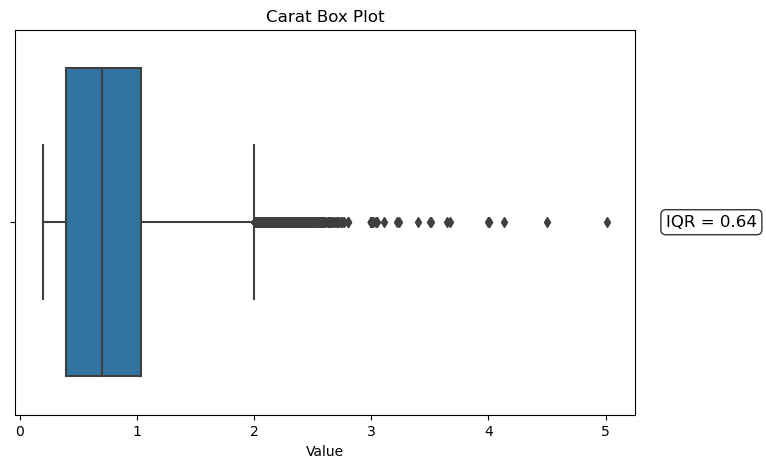

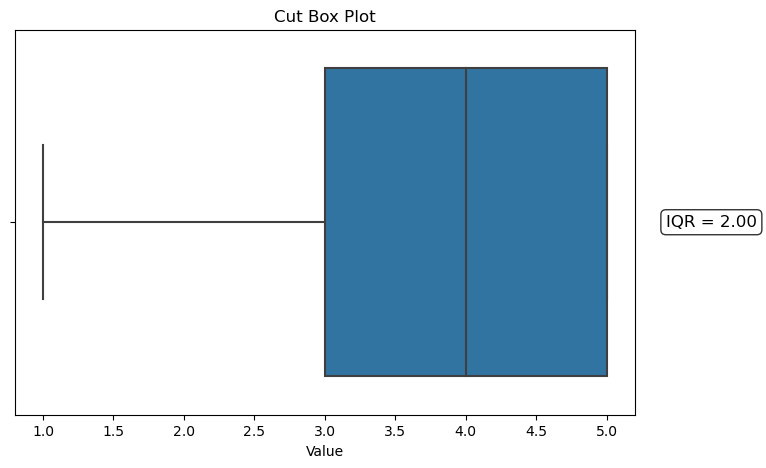

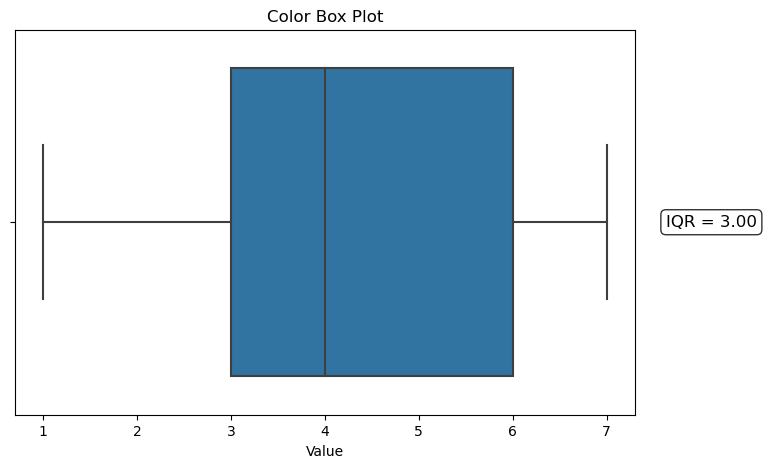

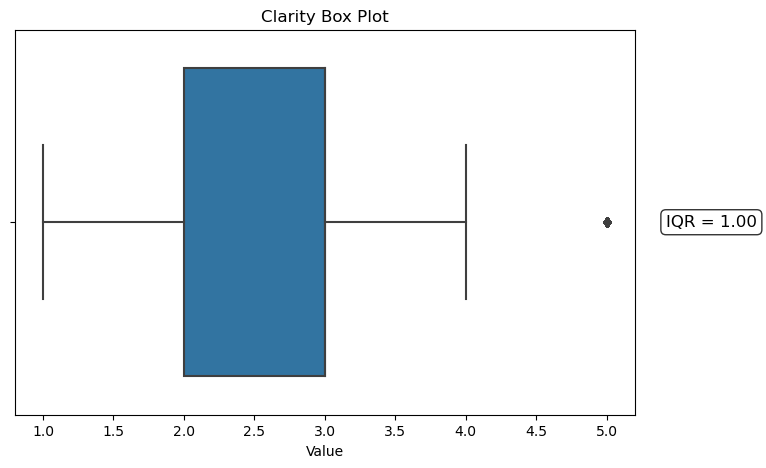

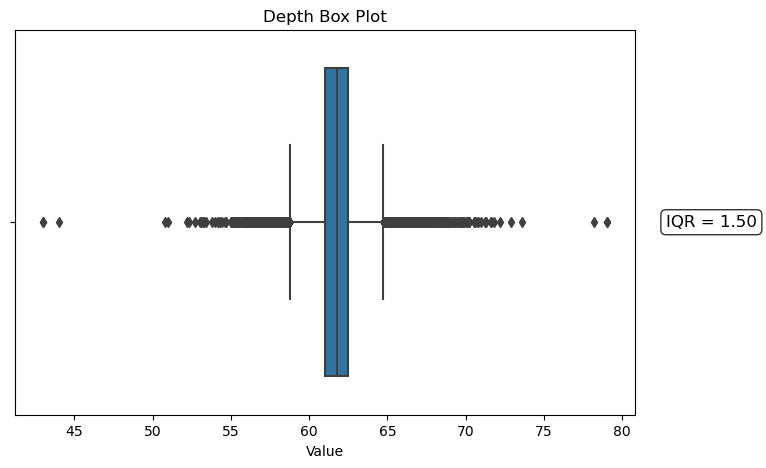

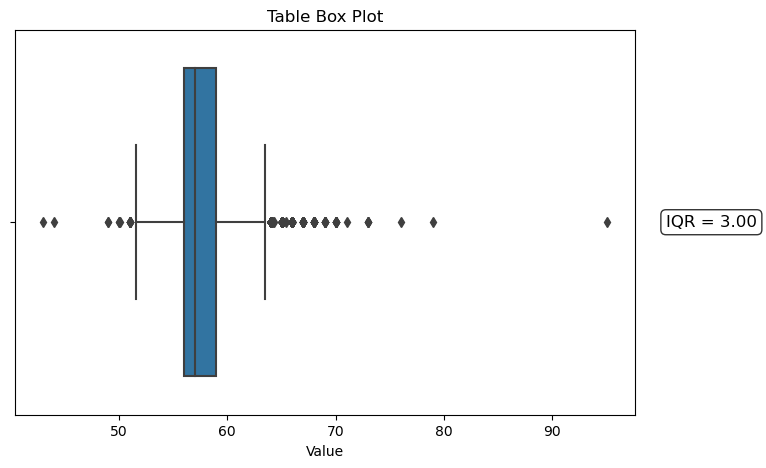

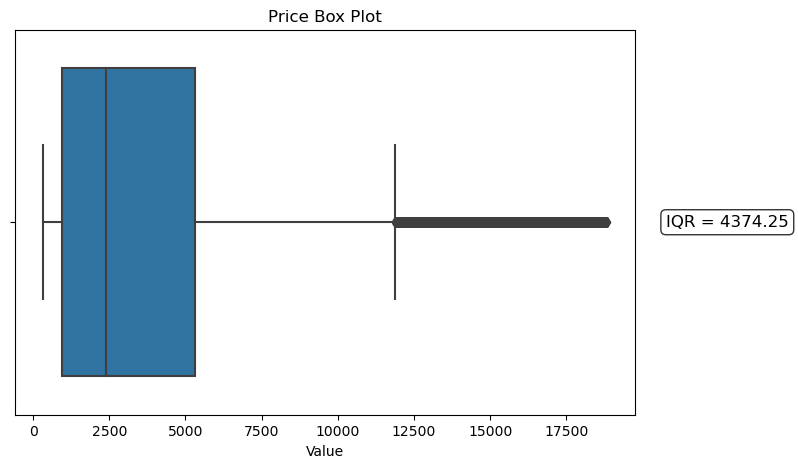

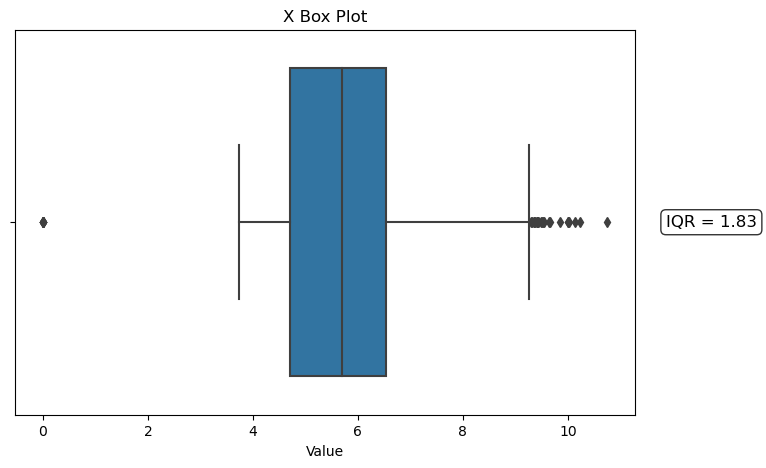

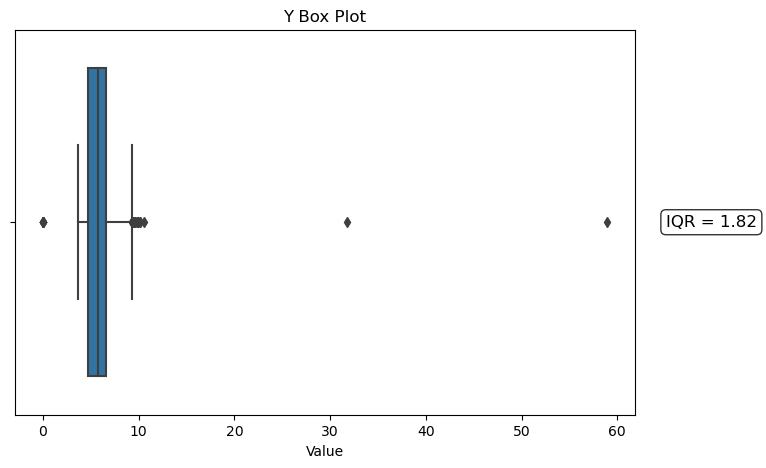

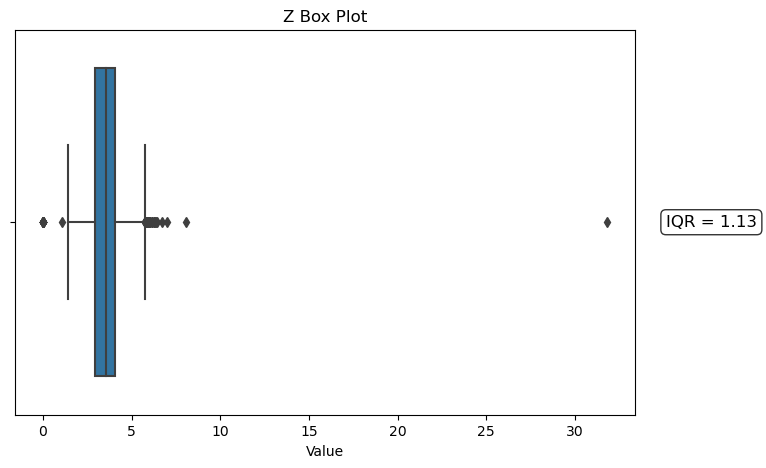

In [64]:
plot_boxplots_iqr(df)

In [65]:
# Create and apply a function that prints a short summary of our features 

def print_column_stats(df, column_name):
    column = df[column_name]
    print(f"Range of values in column '{column_name}': {column.max() - column.min()}")
    print(f"Top three highest values in column '{column_name}':")
    print(column.nlargest(3))
    print(f"Bottom three lowest values in column '{column_name}':")
    print(column.nsmallest(3))

In [66]:
print_column_stats(df, 'carat')

Range of values in column 'carat': 4.81
Top three highest values in column 'carat':
27415    5.01
27630    4.50
27130    4.13
Name: carat, dtype: float64
Bottom three lowest values in column 'carat':
14       0.2
31591    0.2
31592    0.2
Name: carat, dtype: float64


In [67]:
print_column_stats(df, 'cut')

Range of values in column 'cut': 4
Top three highest values in column 'cut':
0     5
11    5
13    5
Name: cut, dtype: int64
Bottom three lowest values in column 'cut':
8     1
91    1
97    1
Name: cut, dtype: int64


In [68]:
print_column_stats(df, 'color')

Range of values in column 'color': 6
Top three highest values in column 'color':
28    7
34    7
38    7
Name: color, dtype: int64
Bottom three lowest values in column 'color':
4     1
5     1
10    1
Name: color, dtype: int64


In [69]:
print_column_stats(df, 'clarity')

Range of values in column 'clarity': 4
Top three highest values in column 'clarity':
229    5
250    5
256    5
Name: clarity, dtype: int64
Bottom three lowest values in column 'clarity':
15     1
172    1
215    1
Name: clarity, dtype: int64


In [70]:
print_column_stats(df, 'depth')

Range of values in column 'depth': 36.0
Top three highest values in column 'depth':
52860    79.0
52861    79.0
41918    78.2
Name: depth, dtype: float64
Bottom three lowest values in column 'depth':
4518     43.0
10377    43.0
6341     44.0
Name: depth, dtype: float64


In [71]:
print_column_stats(df, 'table')

Range of values in column 'table': 52.0
Top three highest values in column 'table':
24932    95.0
50773    79.0
51342    76.0
Name: table, dtype: float64
Bottom three lowest values in column 'table':
11368    43.0
35633    44.0
5979     49.0
Name: table, dtype: float64


In [72]:
print_column_stats(df, 'price')

Range of values in column 'price': 18497
Top three highest values in column 'price':
27749    18823
27748    18818
27747    18806
Name: price, dtype: int64
Bottom three lowest values in column 'price':
0    326
1    326
2    327
Name: price, dtype: int64


In [73]:
print_column_stats(df, 'x')

Range of values in column 'x': 10.74
Top three highest values in column 'x':
27415    10.74
27630    10.23
25998    10.14
Name: x, dtype: float64
Bottom three lowest values in column 'x':
11182    0.0
11963    0.0
15951    0.0
Name: x, dtype: float64


In [74]:
print_column_stats(df, 'y')

Range of values in column 'y': 58.9
Top three highest values in column 'y':
24067    58.90
49189    31.80
27415    10.54
Name: y, dtype: float64
Bottom three lowest values in column 'y':
11963    0.0
15951    0.0
24520    0.0
Name: y, dtype: float64


In [75]:
print_column_stats(df, 'z')

Range of values in column 'z': 31.8
Top three highest values in column 'z':
48410    31.80
24067     8.06
27415     6.98
Name: z, dtype: float64
Bottom three lowest values in column 'z':
2207    0.0
2314    0.0
4791    0.0
Name: z, dtype: float64


### Anomaly Detection with Isolation Forest

In [76]:
# Use Isolation Forest to conduct Anomaly Detection

from sklearn.ensemble import IsolationForest

X = df[['price', 'x', 'y', 'z']]

isf = IsolationForest(n_estimators=100, max_samples='auto', contamination='auto', random_state=123)

isf.fit(X)

IsolationForest(random_state=123)

In [77]:
with open('../models/isolation_forest_model.pickle', 'wb') as f: 
    pickle.dump(isf, f)

In [78]:
outliers = isf.predict(X)

In [79]:
df_if = df.copy()

In [80]:
df_if 

,carat,cut,color,clarity,depth,table,price,x,y,z
0,0.23,5,6,2,61.5,55.0,326,3.95,3.98,2.43
1,0.21,4,6,2,59.8,61.0,326,3.89,3.84,2.31
2,0.23,2,6,3,56.9,65.0,327,4.05,4.07,2.31
3,0.29,4,2,3,62.4,58.0,334,4.20,4.23,2.63
4,0.31,2,1,2,63.3,58.0,335,4.34,4.35,2.75
...,...,...,...,...,...,...,...,...,...,...
53935,0.72,5,7,2,60.8,57.0,2757,5.75,5.76,3.50
53936,0.72,2,7,2,63.1,55.0,2757,5.69,5.75,3.61
53937,0.70,3,7,2,62.8,60.0,2757,5.66,5.68,3.56
53938,0.86,4,3,2,61.0,58.0,2757,6.15,6.12,3.74


In [81]:
df_if['outlier'] = outliers 

In [82]:
df_if.head()

,carat,cut,color,clarity,depth,table,price,x,y,z,outlier
0,0.23,5,6,2,61.5,55.0,326,3.95,3.98,2.43,-1
1,0.21,4,6,2,59.8,61.0,326,3.89,3.84,2.31,-1
2,0.23,2,6,3,56.9,65.0,327,4.05,4.07,2.31,-1
3,0.29,4,2,3,62.4,58.0,334,4.20,4.23,2.63,-1
4,0.31,2,1,2,63.3,58.0,335,4.34,4.35,2.75,1


In [83]:
print(df_if[df_if['outlier'] == -1])

       carat  cut  color  clarity  depth  table  price     x     y     z  \
0       0.23    5      6        2   61.5   55.0    326  3.95  3.98  2.43   
1       0.21    4      6        2   59.8   61.0    326  3.89  3.84  2.31   
2       0.23    2      6        3   56.9   65.0    327  4.05  4.07  2.31   
3       0.29    4      2        3   62.4   58.0    334  4.20  4.23  2.63   
5       0.24    3      1        4   62.8   57.0    336  3.94  3.96  2.48   
...      ...  ...    ...      ...    ...    ...    ...   ...   ...   ...   
52975   0.24    2      5        4   58.3   57.0    552  4.10  4.14  2.40   
52993   1.29    1      3        1   67.7   62.0   2596  6.69  6.59  4.50   
53146   1.20    1      5        1   65.7   56.0   2622  6.65  6.58  4.35   
53338   1.20    1      4        1   64.4   55.0   2655  6.77  6.61  4.31   
53456   0.48    3      7        5   60.6   55.0   2677  5.08  5.12  3.09   

       outlier  
0           -1  
1           -1  
2           -1  
3           -1  
5 

## Making Predictions

In [84]:
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler
from sklearn.linear_model import LinearRegression
from sklearn.neighbors import KNeighborsRegressor
from sklearn import neighbors
from sklearn.metrics import r2_score, mean_absolute_error, mean_squared_error, mean_squared_log_error, mean_squared_error, accuracy_score

In [85]:
df2.dtypes

carat      float64
cut          int64
color        int64
clarity      int64
depth      float64
table      float64
price        int64
x          float64
y          float64
z          float64
dtype: object

### X-y Split

In [86]:
X = df2.drop(['price'], axis=1)  
y = df2['price'] 

### Train-Test Split

In [87]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

In [88]:
print(X_train.shape)
print(X_test.shape)
print(y_train.shape)
print(y_test.shape)

(37758, 9)
(16182, 9)
(37758,)
(16182,)


In [89]:
y_train.isna().sum()

0

## MinMax Scaler

In [90]:
transformer = MinMaxScaler()
transformer.fit(X_train) 

X_train_normalized = transformer.transform(X_train)
X_test_normalized  = transformer.transform(X_test)

X_train_final = pd.DataFrame(X_train_normalized, columns = X_train.columns)
X_test_final = pd.DataFrame(X_test_normalized, columns = X_test.columns)

In [91]:
with open('../scalers/min_max_scaler.pickle', 'wb') as f: 
    pickle.dump(transformer, f)

In [92]:
X_test_final.columns

Index(['carat', 'cut', 'color', 'clarity', 'depth', 'table', 'x', 'y', 'z'], dtype='object')

In [93]:
X_train_final.columns

Index(['carat', 'cut', 'color', 'clarity', 'depth', 'table', 'x', 'y', 'z'], dtype='object')

### Linear Regression Model With MinMax Scaled Values

In [94]:
model = LinearRegression()
model.fit(X_train_final, y_train)

LinearRegression()

In [95]:
with open('../models/lr_min_max_model.pickle', 'wb') as f: 
    pickle.dump(model, f)

In [96]:
y_pred_train = model.predict(X_train_final) 
y_pred_test = model.predict(X_test_final) 
r2_score_train = r2_score(y_pred_train, y_train)
r2_score_test = r2_score(y_pred_test, y_test)

In [97]:
r2 = r2_score(y_test, y_pred_test)
mae = mean_absolute_error(y_test, y_pred_test)
mse = mean_squared_error(y_test, y_pred_test)
rmse = np.sqrt(mse)

print("The r2 of the model for the test set is: {:.3f}".format(r2))
print("The mean absolute error of the model for the test set is: {:.3f}".format(mae))
print("The mean squared error of the model for the test set is: {:.3f}".format(mse))
print("The root mean squared error of the model for the test set is: {:.3f}".format(rmse))

The r2 of the model for the test set is: 0.904
The mean absolute error of the model for the test set is: 815.570
The mean squared error of the model for the test set is: 1493244.403
The root mean squared error of the model for the test set is: 1221.984


In [98]:
r2 = r2_score(y_train, y_pred_train)
mae = mean_absolute_error(y_train, y_pred_train)
mse = mean_squared_error(y_train, y_pred_train)
rmse = np.sqrt(mse)


print("The r2 of the model for the train set is: {:.3f}".format(r2))
print("The mean absolute error of the model for the train set is: {:.3f}".format(mae))
print("The mean squared error of the model for the train set is: {:.3f}".format(mse))
print("The root mean squared error of the model for the train set is: {:.3f}".format(rmse))

The r2 of the model for the train set is: 0.903
The mean absolute error of the model for the train set is: 824.147
The mean squared error of the model for the train set is: 1553355.184
The root mean squared error of the model for the train set is: 1246.337


In [99]:
y_pred_mm = model.predict(X_test_final)

In [100]:
predictions = model.predict(X_test_final)
model.score(X_test_final, y_test)

0.9042544299200568

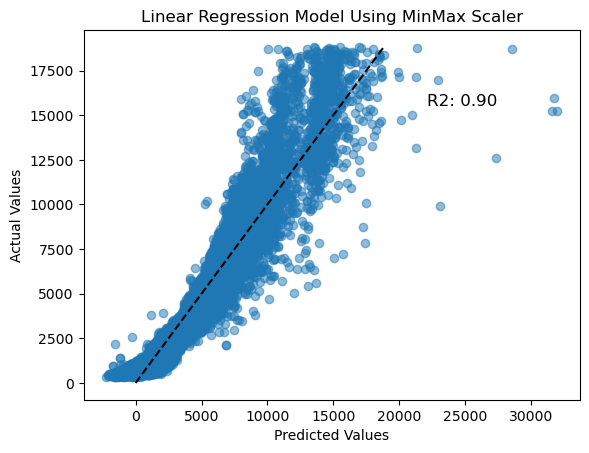

In [101]:
r2 = r2_score(y_test, y_pred_mm)

plt.scatter(y=y_test, x=y_pred_mm, alpha=0.5)

plt.title("Linear Regression Model Using MinMax Scaler")
plt.xlabel("Predicted Values")
plt.ylabel("Actual Values")

plt.plot([0, max(y_test)], [0, max(y_test)], '--k')

plt.text(max(y_test)+0.25*(max(y_pred_mm)-max(y_test)), max(y_test)-0.25*(max(y_pred_mm)-max(y_test)), 'R2: {:.2f}'.format(r2), fontsize=12, color='black')

plt.show()

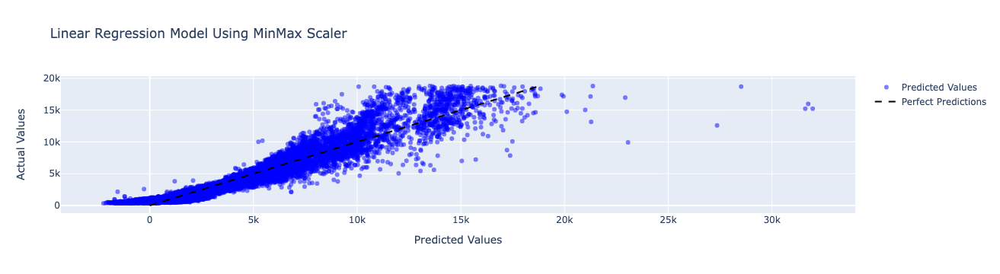

In [102]:
import plotly.graph_objs as go

fig = go.Figure()

fig.add_trace(go.Scatter(x=y_pred_mm, y=y_test, mode='markers',
                         marker=dict(color='blue', opacity=0.5),
                         name='Predicted Values'))

fig.add_trace(go.Scatter(x=[0, max(y_test)], y=[0, max(y_test)],
                         mode='lines', line=dict(color='black', dash='dash'),
                         name='Perfect Predictions'))

fig.update_layout(title='Linear Regression Model Using MinMax Scaler',
                  xaxis_title='Predicted Values', yaxis_title='Actual Values')
fig.show()

## Standard Scaler

### See if the performance of the model changes with the use of the Standard Scaler vs the MinMax Scaler

In [103]:
scaler = StandardScaler()
scaler.fit(X_train)

X_train_scaled = transformer.transform(X_train)
X_test_scaled  = transformer.transform(X_test)

X_train_final_scaled = pd.DataFrame(X_train_scaled, columns = X_train.columns)
X_test_final_scaled = pd.DataFrame(X_test_scaled, columns = X_test.columns)

In [104]:
with open('../scalers/standard_scaler.pickle', 'wb') as f: 
    pickle.dump(scaler, f)

### Linear Regression Model With StandardScaler Values

In [105]:
model = LinearRegression()
model.fit(X_train_final_scaled, y_train)

LinearRegression()

In [106]:
with open('../models/lr_standard_model.pickle', 'wb') as f: 
    pickle.dump(model, f)

In [107]:
y_pred_train_scaled = model.predict(X_train_final_scaled) 
y_pred_test_scaled = model.predict(X_test_final_scaled) 
r2_score_train = r2_score(y_pred_train, y_train)
r2_score_test = r2_score(y_pred_test, y_test)

In [108]:
r2 = r2_score(y_test, y_pred_test_scaled)
mae = mean_absolute_error(y_test, y_pred_test_scaled)
mse = mean_squared_error(y_test, y_pred_test_scaled)
rmse = np.sqrt(mse)

print("The r2 of the model for the test set is: {:.3f}".format(r2))
print("The mean absolute error of the model for the test set is: {:.3f}".format(mae))
print("The mean squared error of the model for the test set is: {:.3f}".format(mse))
print("The root mean squared error of the model for the test set is: {:.3f}".format(rmse))

The r2 of the model for the test set is: 0.904
The mean absolute error of the model for the test set is: 815.570
The mean squared error of the model for the test set is: 1493244.403
The root mean squared error of the model for the test set is: 1221.984


In [109]:
r2 = r2_score(y_train, y_pred_train_scaled)
mae = mean_absolute_error(y_train, y_pred_train_scaled)
mse = mean_squared_error(y_train, y_pred_train_scaled)
rmse = np.sqrt(mse)


print("The r2 of the model for the train set is: {:.3f}".format(r2))
print("The mean absolute error of the model for the train set is: {:.3f}".format(mae))
print("The mean squared error of the model for the train set is: {:.3f}".format(mse))
print("The root mean squared error of the model for the train set is: {:.3f}".format(rmse))

The r2 of the model for the train set is: 0.903
The mean absolute error of the model for the train set is: 824.147
The mean squared error of the model for the train set is: 1553355.184
The root mean squared error of the model for the train set is: 1246.337


In [110]:
y_pred_ss = model.predict(X_test_final_scaled)

In [111]:
predictions = model.predict(X_test_final_scaled)
model.score(X_test_final_scaled, y_test)

0.9042544299200568

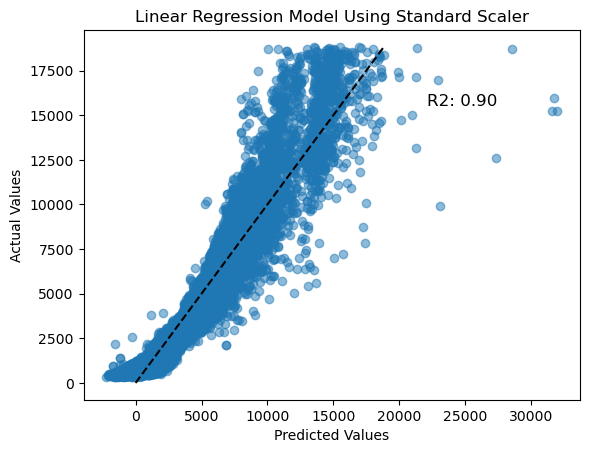

In [112]:
r2 = r2_score(y_test, y_pred_ss)

plt.scatter(y=y_test, x=y_pred_ss, alpha=0.5)

plt.title("Linear Regression Model Using Standard Scaler")
plt.xlabel("Predicted Values")
plt.ylabel("Actual Values")

plt.plot([0, max(y_test)], [0, max(y_test)], '--k')

plt.text(max(y_test)+0.25*(max(y_pred_ss)-max(y_test)), max(y_test)-0.25*(max(y_pred_ss)-max(y_test)), 'R2: {:.2f}'.format(r2), fontsize=12, color='black')

plt.show()

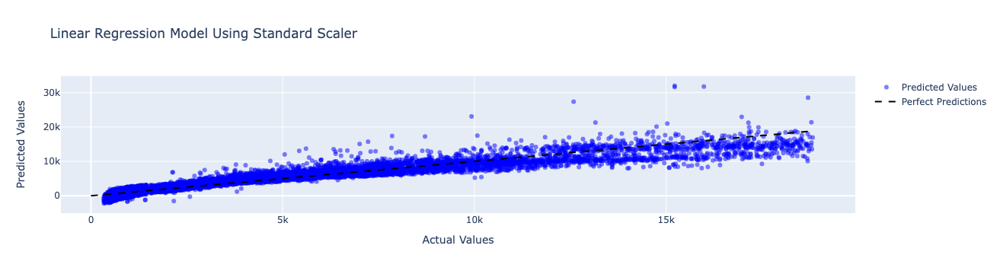

In [113]:
fig = go.Figure()

fig.add_trace(go.Scatter(x=y_test, y=y_pred_ss, mode='markers',
                         marker=dict(color='blue', opacity=0.5),
                         name='Predicted Values'))

fig.add_trace(go.Scatter(x=[0, max(y_test)], y=[0, max(y_test)],
                         mode='lines', line=dict(color='black', dash='dash'),
                         name='Perfect Predictions'))

fig.update_layout(title='Linear Regression Model Using Standard Scaler',
                  xaxis_title='Actual Values', yaxis_title='Predicted Values')
fig.show()

## KNNeighbours Model

### Apply a different machine learning algorithim to see if model performance improves

In [114]:
knn = KNeighborsRegressor(n_neighbors=6, weights='distance', algorithm='auto', leaf_size=30)
knn.fit(X_train_final, y_train) 

KNeighborsRegressor(n_neighbors=6, weights='distance')

In [115]:
with open('../models/knn.pickle', 'wb') as f: 
    pickle.dump(knn, f)

In [116]:
y_pred_imputed = knn.predict(X_test_final)

In [117]:
rmse_val = [] 
for K in range(30):
    K = K+1
    model = neighbors.KNeighborsRegressor(n_neighbors = K, weights='distance')

    model.fit(X_train_final, y_train)  
    y_pred_imputed = model.predict(X_test_final)
    error = np.sqrt(mean_squared_error(y_test,y_pred_imputed))
    rmse_val.append(error) 
    print('RMSE value for k= ' , K , 'is:', error)

RMSE value for k=  1 is: 939.4291115116433
RMSE value for k=  2 is: 833.2699267900227
RMSE value for k=  3 is: 789.5666011516684
RMSE value for k=  4 is: 770.5751872075725
RMSE value for k=  5 is: 746.929261135708
RMSE value for k=  6 is: 732.5273555590878
RMSE value for k=  7 is: 729.2291273077495
RMSE value for k=  8 is: 729.1008769000653
RMSE value for k=  9 is: 725.6352526433411
RMSE value for k=  10 is: 724.1410740545105
RMSE value for k=  11 is: 724.2205157925966
RMSE value for k=  12 is: 725.5490069984538
RMSE value for k=  13 is: 727.2409654121932
RMSE value for k=  14 is: 727.3419983103494
RMSE value for k=  15 is: 728.0145588620172
RMSE value for k=  16 is: 729.5252540128274
RMSE value for k=  17 is: 730.5512798864422
RMSE value for k=  18 is: 733.2089053587598
RMSE value for k=  19 is: 735.0914980169651
RMSE value for k=  20 is: 737.6502510981938
RMSE value for k=  21 is: 740.1748597525881
RMSE value for k=  22 is: 741.6353584677911
RMSE value for k=  23 is: 742.764318063513

In [118]:
r2 = r2_score(y_test, y_pred_imputed)
print("The r2 of the model is: {:.3f}".format(r2))

The r2 of the model is: 0.963


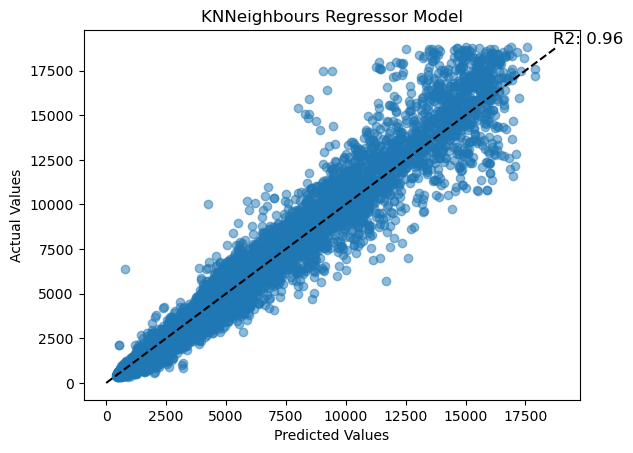

In [119]:
r2 = r2_score(y_test, y_pred_imputed)

plt.scatter(y=y_test, x=y_pred_imputed, alpha=0.5)

plt.title("KNNeighbours Regressor Model")
plt.xlabel("Predicted Values")
plt.ylabel("Actual Values")

plt.plot([0, max(y_test)], [0, max(y_test)], '--k')

plt.text(max(y_test)+0.2*(max(y_pred_imputed)-max(y_test)), max(y_test)-0.2*(max(y_pred_imputed)-max(y_test)), 'R2: {:.2f}'.format(r2), fontsize=12, color='black')

plt.show()

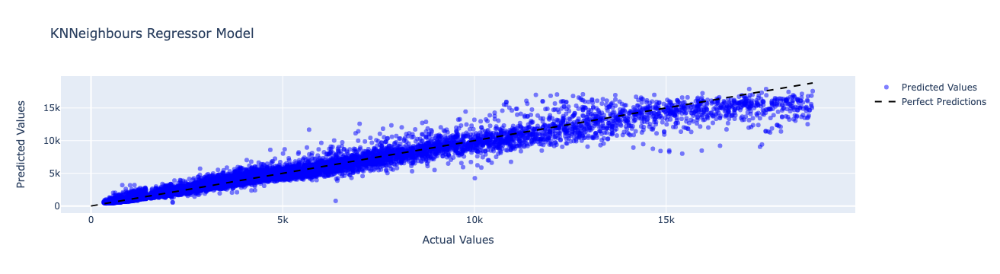

In [120]:
fig = go.Figure()

fig.add_trace(go.Scatter(x=y_test, y=y_pred_imputed, mode='markers',
                         marker=dict(color='blue', opacity=0.5),
                         name='Predicted Values'))

fig.add_trace(go.Scatter(x=[0, max(y_test)], y=[0, max(y_test)],
                         mode='lines', line=dict(color='black', dash='dash'),
                         name='Perfect Predictions'))

fig.update_layout(title='KNNeighbours Regressor Model',
                  xaxis_title='Actual Values', yaxis_title='Predicted Values')
fig.show()

## Clustering- Finding the Best Number of KNNeighbours

In [121]:
X_original = X.copy()

In [122]:
scaler = StandardScaler()
scaler.fit(X_original) 
X_scaled = scaler.transform(X_original)

In [123]:
with open('../scalers/scaler_clusters.pickle', 'wb') as f: 
    pickle.dump(scaler, f)

In [124]:
X_scaled_df = pd.DataFrame(X_scaled, columns = X_original.columns)
display(X_original.head())

display(X_scaled_df.head())

,carat,cut,color,clarity,depth,table,x,y,z
0,0.23,5,6,2,61.5,55.0,3.95,3.98,2.43
1,0.21,4,6,2,59.8,61.0,3.89,3.84,2.31
2,0.23,2,6,3,56.9,65.0,4.05,4.07,2.31
3,0.29,4,2,3,62.4,58.0,4.20,4.23,2.63
4,0.31,2,1,2,63.3,58.0,4.34,4.35,2.75


,carat,cut,color,clarity,depth,table,x,y,z
0,-1.198168,0.981473,0.937163,-0.930471,-0.174092,-1.099672,-1.587837,-1.536196,-1.571129
1,-1.240361,0.085889,0.937163,-0.930471,-1.360738,1.585529,-1.641325,-1.658774,-1.741175
2,-1.198168,-1.705279,0.937163,0.250461,-3.385019,3.375663,-1.498691,-1.457395,-1.741175
3,-1.071587,0.085889,-1.414272,0.250461,0.454133,0.242928,-1.364971,-1.317305,-1.287720
4,-1.029394,-1.705279,-2.002131,-0.930471,1.082358,0.242928,-1.240167,-1.212238,-1.117674


In [125]:
kmeans = KMeans(n_clusters=7, random_state=1234)
kmeans.fit(X_scaled_df)

/Users/aloaskari/opt/anaconda3/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



KMeans(n_clusters=7, random_state=1234)

In [126]:
with open('../models/kmeans.pickle', 'wb') as f: 
    pickle.dump(kmeans, f)

In [127]:
clusters = kmeans.predict(X_scaled_df)

In [128]:
pd.Series(clusters).value_counts().sort_index() 

0     8199
1     6140
2     8915
3     8757
4     5857
5     5555
6    10517
dtype: int64

In [129]:
X_original['clusters'] = clusters

X_original.head()

,carat,cut,color,clarity,depth,table,x,y,z,clusters
0,0.23,5,6,2,61.5,55.0,3.95,3.98,2.43,3
1,0.21,4,6,2,59.8,61.0,3.89,3.84,2.31,2
2,0.23,2,6,3,56.9,65.0,4.05,4.07,2.31,2
3,0.29,4,2,3,62.4,58.0,4.20,4.23,2.63,2
4,0.31,2,1,2,63.3,58.0,4.34,4.35,2.75,2


In [130]:
pd.DataFrame(scaler.inverse_transform(kmeans.cluster_centers_), columns=X_original.columns[:-1])

,carat,cut,color,clarity,depth,table,x,y,z
0,0.395258,4.651883,3.961253,3.977093,61.714098,56.030523,4.676942,4.691790,2.890116
1,0.912875,2.305926,4.414849,2.398567,63.703745,57.628460,6.073844,6.073455,3.868507
2,0.384612,3.293411,4.888091,2.837580,61.678123,58.490381,4.628224,4.636858,2.854658
3,0.486868,4.844784,5.612646,2.570075,61.712748,55.883782,5.011720,5.018702,3.093848
4,1.767901,3.735772,3.082379,2.392241,61.725175,58.242044,7.721407,7.722181,4.766701
5,0.907932,3.122078,4.734268,2.455412,59.814779,60.543402,6.231260,6.226061,3.724833
6,1.056795,4.495289,3.895498,2.622537,61.763167,56.836671,6.516384,6.511486,4.021301


In [131]:
kmeans.inertia_

204825.59324854164

In [132]:
with open('../inertia/kmeans_inertia.pickle', 'wb') as f: 
    pickle.dump(kmeans.inertia_, f)

Training a K-Means model with 2 clusters! 

Initialization complete
Iteration 0, inertia 570340.4022903007.
Iteration 1, inertia 342622.4767226411.
Iteration 2, inertia 326293.3956973794.
Iteration 3, inertia 322849.7809468264.
Iteration 4, inertia 322405.82369066874.
Iteration 5, inertia 322300.39317275025.
Iteration 6, inertia 322268.9004869104.
Iteration 7, inertia 322260.21464169427.
Converged at iteration 7: center shift 4.996936317022971e-05 within tolerance 0.00010000000000001444.
Initialization complete
Iteration 0, inertia 535566.4785055923.
Iteration 1, inertia 354617.17142657505.
Iteration 2, inertia 337432.6700803995.
Iteration 3, inertia 325372.6403271983.
Iteration 4, inertia 322780.8942779946.
Iteration 5, inertia 322395.0610862321.
Iteration 6, inertia 322297.36334583117.
Iteration 7, inertia 322268.33803656814.
Iteration 8, inertia 322260.0630981001.
Converged at iteration 8: center shift 4.4246128764759234e-05 within tolerance 0.00010000000000001444.
Initialization co

/Users/aloaskari/opt/anaconda3/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



Training a K-Means model with 3 clusters! 

Initialization complete
Iteration 0, inertia 534145.8164452969.
Iteration 1, inertia 311155.6945859747.
Iteration 2, inertia 293436.1172516917.
Iteration 3, inertia 290224.49968316697.
Iteration 4, inertia 289489.13724150363.
Iteration 5, inertia 289074.4565431121.
Iteration 6, inertia 288750.2114597652.
Iteration 7, inertia 288429.4776285433.
Iteration 8, inertia 288095.11368069565.
Iteration 9, inertia 287661.8249712353.
Iteration 10, inertia 287258.33249053074.
Iteration 11, inertia 286902.86512275826.
Iteration 12, inertia 286617.6311169633.
Iteration 13, inertia 286403.6500194997.
Iteration 14, inertia 286253.464055404.
Iteration 15, inertia 286138.68432654487.
Iteration 16, inertia 286048.138909383.
Iteration 17, inertia 285989.43472990196.
Iteration 18, inertia 285946.43278917146.
Iteration 19, inertia 285917.54480557784.
Iteration 20, inertia 285899.79023291904.
Iteration 21, inertia 285886.2445688037.
Iteration 22, inertia 285872.963

/Users/aloaskari/opt/anaconda3/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



Training a K-Means model with 4 clusters! 

Initialization complete
Iteration 0, inertia 421873.75270968716.
Iteration 1, inertia 281766.08194316423.
Iteration 2, inertia 265761.4554642253.
Iteration 3, inertia 262808.20573831117.
Iteration 4, inertia 261526.29264928665.
Iteration 5, inertia 260925.9179075098.
Iteration 6, inertia 260695.48892786293.
Iteration 7, inertia 260568.29028392202.
Iteration 8, inertia 260480.05874367888.
Iteration 9, inertia 260419.29004405538.
Iteration 10, inertia 260373.45197710305.
Iteration 11, inertia 260338.03480762197.
Iteration 12, inertia 260314.49129181824.
Iteration 13, inertia 260295.59527836405.
Iteration 14, inertia 260281.31626975973.
Iteration 15, inertia 260269.7492537376.
Iteration 16, inertia 260262.92473369333.
Iteration 17, inertia 260257.72409073205.
Iteration 18, inertia 260253.95749543377.
Iteration 19, inertia 260251.55811879804.
Converged at iteration 19: center shift 8.625022761356341e-05 within tolerance 0.00010000000000001444.
In

/Users/aloaskari/opt/anaconda3/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



Iteration 11, inertia 261125.54803050772.
Iteration 12, inertia 261101.73282728367.
Iteration 13, inertia 261088.12019521353.
Iteration 14, inertia 261080.9093272802.
Iteration 15, inertia 261077.17964694326.
Iteration 16, inertia 261074.40672113255.
Converged at iteration 16: center shift 9.317319606240028e-05 within tolerance 0.00010000000000001444.
Initialization complete
Iteration 0, inertia 473113.2885293929.
Iteration 1, inertia 278436.00387178856.
Iteration 2, inertia 269020.78929021937.
Iteration 3, inertia 265315.746136236.
Iteration 4, inertia 263738.34368745366.
Iteration 5, inertia 263331.7453939504.
Iteration 6, inertia 263223.9278504392.
Iteration 7, inertia 263175.2320956496.
Iteration 8, inertia 263146.2609802722.
Iteration 9, inertia 263130.8007369203.
Iteration 10, inertia 263121.1440173649.
Iteration 11, inertia 263113.8821370669.
Iteration 12, inertia 263108.33959429024.
Iteration 13, inertia 263104.0229453616.
Iteration 14, inertia 263098.77798682026.
Iteration 15,

/Users/aloaskari/opt/anaconda3/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



Initialization complete
Iteration 0, inertia 354063.92182359926.
Iteration 1, inertia 263353.9297075657.
Iteration 2, inertia 257758.89375060293.
Iteration 3, inertia 254763.40658672352.
Iteration 4, inertia 251912.49120936776.
Iteration 5, inertia 248973.10650978686.
Iteration 6, inertia 246528.58791453482.
Iteration 7, inertia 244798.77919203008.
Iteration 8, inertia 243510.52911355835.
Iteration 9, inertia 242577.75193820128.
Iteration 10, inertia 241911.5953721589.
Iteration 11, inertia 241297.2050328568.
Iteration 12, inertia 240725.7393086928.
Iteration 13, inertia 240289.8319770646.
Iteration 14, inertia 239993.46489133814.
Iteration 15, inertia 239812.86857717633.
Iteration 16, inertia 239711.32286405555.
Iteration 17, inertia 239646.4749476356.
Iteration 18, inertia 239618.18995835487.
Iteration 19, inertia 239604.95034762938.
Iteration 20, inertia 239599.33415615693.
Iteration 21, inertia 239597.45712131035.
Converged at iteration 21: center shift 7.513017190557504e-05 within

/Users/aloaskari/opt/anaconda3/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



Initialization complete
Iteration 0, inertia 344289.33027613023.
Iteration 1, inertia 252239.63070854472.
Iteration 2, inertia 243997.9883922059.
Iteration 3, inertia 239467.52298715134.
Iteration 4, inertia 236921.7257771968.
Iteration 5, inertia 235098.40906724485.
Iteration 6, inertia 232697.75959015425.
Iteration 7, inertia 228565.21432087952.
Iteration 8, inertia 223756.42731612446.
Iteration 9, inertia 220645.54074019552.
Iteration 10, inertia 219258.94333948081.
Iteration 11, inertia 218775.45017043455.
Iteration 12, inertia 218612.3382274149.
Iteration 13, inertia 218531.42765466217.
Iteration 14, inertia 218442.58815503723.
Iteration 15, inertia 218417.92273044903.
Iteration 16, inertia 218378.48659645088.
Iteration 17, inertia 218324.6790658718.
Iteration 18, inertia 218290.57883198292.
Iteration 19, inertia 218278.48634264737.
Iteration 20, inertia 218259.2045728206.
Iteration 21, inertia 218242.60960069182.
Iteration 22, inertia 218233.57948004917.
Iteration 23, inertia 218

/Users/aloaskari/opt/anaconda3/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



Iteration 22, inertia 204875.5410208946.
Iteration 23, inertia 204855.78753675745.
Iteration 24, inertia 204844.81924306415.
Iteration 25, inertia 204836.7091508197.
Iteration 26, inertia 204831.67640130775.
Iteration 27, inertia 204828.87643041165.
Iteration 28, inertia 204826.85678442847.
Converged at iteration 28: center shift 8.698103242008245e-05 within tolerance 0.00010000000000001444.
Initialization complete
Iteration 0, inertia 278012.7031580822.
Iteration 1, inertia 231288.049454751.
Iteration 2, inertia 222272.50166166853.
Iteration 3, inertia 216382.1421818965.
Iteration 4, inertia 211626.10835511793.
Iteration 5, inertia 209408.9603107445.
Iteration 6, inertia 208300.41010414727.
Iteration 7, inertia 207557.1155975142.
Iteration 8, inertia 206901.23632840026.
Iteration 9, inertia 206294.48214130537.
Iteration 10, inertia 205819.17392666303.
Iteration 11, inertia 205520.91344217825.
Iteration 12, inertia 205315.1939052636.
Iteration 13, inertia 205190.55000565603.
Iteration 

/Users/aloaskari/opt/anaconda3/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



Initialization complete
Iteration 0, inertia 268061.1511852065.
Iteration 1, inertia 209794.0262471914.
Iteration 2, inertia 204643.65743920996.
Iteration 3, inertia 202860.18478152598.
Iteration 4, inertia 201886.07157511625.
Iteration 5, inertia 201279.86709670362.
Iteration 6, inertia 200884.63666301884.
Iteration 7, inertia 200613.1831797746.
Iteration 8, inertia 200388.0452121227.
Iteration 9, inertia 200220.30310467732.
Iteration 10, inertia 200095.53093796558.
Iteration 11, inertia 200001.65006700964.
Iteration 12, inertia 199923.8057653415.
Iteration 13, inertia 199858.237014692.
Iteration 14, inertia 199809.11848622083.
Iteration 15, inertia 199778.45607581994.
Iteration 16, inertia 199753.35819677621.
Iteration 17, inertia 199733.40984575477.
Iteration 18, inertia 199715.7291390365.
Iteration 19, inertia 199698.47971288027.
Iteration 20, inertia 199681.20195939997.
Iteration 21, inertia 199665.7455745826.
Iteration 22, inertia 199649.05218562158.
Iteration 23, inertia 199629.

/Users/aloaskari/opt/anaconda3/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



Iteration 90, inertia 185864.38793712668.
Iteration 91, inertia 185862.00141312057.
Iteration 92, inertia 185860.01115462638.
Iteration 93, inertia 185858.67340816098.
Converged at iteration 93: center shift 7.455817600377056e-05 within tolerance 0.00010000000000001444.
Initialization complete
Iteration 0, inertia 249849.45557206.
Iteration 1, inertia 209392.32682969485.
Iteration 2, inertia 200729.78554366023.
Iteration 3, inertia 196056.8936059216.
Iteration 4, inertia 193505.73190168734.
Iteration 5, inertia 192131.03734177307.
Iteration 6, inertia 191094.36491022175.
Iteration 7, inertia 190237.72903854432.
Iteration 8, inertia 189556.76249476423.
Iteration 9, inertia 189079.0496627974.
Iteration 10, inertia 188761.43386451824.
Iteration 11, inertia 188533.30026032805.
Iteration 12, inertia 188323.13090700156.
Iteration 13, inertia 188083.43609035295.
Iteration 14, inertia 187822.44149882183.
Iteration 15, inertia 187488.72857147877.
Iteration 16, inertia 187121.85763623094.
Iterat

/Users/aloaskari/opt/anaconda3/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



Iteration 15, inertia 183042.43934741087.
Iteration 16, inertia 182939.83307970501.
Iteration 17, inertia 182866.16093013526.
Iteration 18, inertia 182818.4834262214.
Iteration 19, inertia 182768.7940559602.
Iteration 20, inertia 182742.78054520616.
Iteration 21, inertia 182727.83679167635.
Iteration 22, inertia 182711.3610764671.
Iteration 23, inertia 182696.92417916667.
Iteration 24, inertia 182688.8934021693.
Iteration 25, inertia 182683.54675273865.
Iteration 26, inertia 182681.33685858554.
Iteration 27, inertia 182679.90692937974.
Iteration 28, inertia 182678.4406514504.
Iteration 29, inertia 182677.2746322059.
Iteration 30, inertia 182676.05760123808.
Iteration 31, inertia 182674.31287562556.
Iteration 32, inertia 182672.23157180063.
Iteration 33, inertia 182670.11343466514.
Iteration 34, inertia 182668.57828679876.
Iteration 35, inertia 182667.0640385116.
Iteration 36, inertia 182665.28522522157.
Iteration 37, inertia 182662.8464541568.
Iteration 38, inertia 182658.88478774298.


/Users/aloaskari/opt/anaconda3/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



Iteration 20, inertia 172629.17676967807.
Iteration 21, inertia 172587.51243303277.
Iteration 22, inertia 172542.27586098597.
Iteration 23, inertia 172501.1612417589.
Iteration 24, inertia 172460.00888675073.
Iteration 25, inertia 172417.71000893507.
Iteration 26, inertia 172370.31273446034.
Iteration 27, inertia 172333.37015885508.
Iteration 28, inertia 172305.1710496389.
Iteration 29, inertia 172284.9581766925.
Iteration 30, inertia 172266.47879071318.
Iteration 31, inertia 172253.6955743385.
Iteration 32, inertia 172245.98187538295.
Iteration 33, inertia 172241.23044546536.
Iteration 34, inertia 172238.26383718182.
Iteration 35, inertia 172236.21468575852.
Iteration 36, inertia 172235.2859654288.
Converged at iteration 36: center shift 5.779691363014073e-05 within tolerance 0.00010000000000001444.
Initialization complete
Iteration 0, inertia 226598.6721836251.
Iteration 1, inertia 194243.58359475163.
Iteration 2, inertia 189021.2991845604.
Iteration 3, inertia 185504.35103003462.
It

/Users/aloaskari/opt/anaconda3/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



Iteration 44, inertia 167929.375156025.
Iteration 45, inertia 167915.04757263634.
Iteration 46, inertia 167903.6853536389.
Iteration 47, inertia 167894.26066959946.
Iteration 48, inertia 167887.1864289224.
Iteration 49, inertia 167881.30070230854.
Iteration 50, inertia 167876.3591963622.
Iteration 51, inertia 167872.59282858262.
Iteration 52, inertia 167867.5633876378.
Iteration 53, inertia 167860.19420825224.
Iteration 54, inertia 167839.61051741726.
Iteration 55, inertia 167777.61635781146.
Iteration 56, inertia 167732.92863808837.
Iteration 57, inertia 167710.0177761967.
Iteration 58, inertia 167699.76033698657.
Iteration 59, inertia 167696.63546524823.
Iteration 60, inertia 167695.36237244462.
Converged at iteration 60: center shift 7.528199751412633e-05 within tolerance 0.00010000000000001444.
Initialization complete
Iteration 0, inertia 217569.39566309482.
Iteration 1, inertia 186730.89462221903.
Iteration 2, inertia 181104.19087683284.
Iteration 3, inertia 178053.6251866161.
Ite

/Users/aloaskari/opt/anaconda3/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



Iteration 31, inertia 163691.2676433702.
Iteration 32, inertia 163689.38349568995.
Iteration 33, inertia 163687.7027824795.
Iteration 34, inertia 163686.27551091593.
Iteration 35, inertia 163684.29227470065.
Iteration 36, inertia 163681.64773016656.
Iteration 37, inertia 163678.87456406787.
Iteration 38, inertia 163677.4768827311.
Iteration 39, inertia 163675.81217015572.
Iteration 40, inertia 163674.3508390879.
Iteration 41, inertia 163673.1108502285.
Iteration 42, inertia 163671.71895182278.
Iteration 43, inertia 163669.87670479045.
Iteration 44, inertia 163668.52579631488.
Iteration 45, inertia 163667.3863522876.
Iteration 46, inertia 163665.96955256257.
Iteration 47, inertia 163664.66641527275.
Iteration 48, inertia 163663.56664231024.
Iteration 49, inertia 163662.2633470557.
Iteration 50, inertia 163660.76615968652.
Iteration 51, inertia 163659.21975307405.
Iteration 52, inertia 163656.99356282872.
Iteration 53, inertia 163653.81262916687.
Iteration 54, inertia 163647.5982963357.


/Users/aloaskari/opt/anaconda3/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



Iteration 14, inertia 163388.552968233.
Iteration 15, inertia 163340.22533797464.
Iteration 16, inertia 163291.41035675997.
Iteration 17, inertia 163231.4293058953.
Iteration 18, inertia 163168.72555463022.
Iteration 19, inertia 163096.47208814608.
Iteration 20, inertia 163001.4965809901.
Iteration 21, inertia 162881.0366632539.
Iteration 22, inertia 162726.31573148994.
Iteration 23, inertia 162542.7005191387.
Iteration 24, inertia 162334.29236783425.
Iteration 25, inertia 162123.6792197624.
Iteration 26, inertia 161932.7392262576.
Iteration 27, inertia 161773.65813270072.
Iteration 28, inertia 161622.39312563906.
Iteration 29, inertia 161480.69921989.
Iteration 30, inertia 161351.4639864376.
Iteration 31, inertia 161237.6568198183.
Iteration 32, inertia 161133.92993206767.
Iteration 33, inertia 161034.61945409648.
Iteration 34, inertia 160959.9102970058.
Iteration 35, inertia 160889.6106866608.
Iteration 36, inertia 160818.5054795415.
Iteration 37, inertia 160756.7972848731.
Iteration

/Users/aloaskari/opt/anaconda3/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



Iteration 102, inertia 153799.91612570218.
Iteration 103, inertia 153793.37002921692.
Iteration 104, inertia 153788.6231694349.
Iteration 105, inertia 153783.2362250946.
Iteration 106, inertia 153778.31759903138.
Iteration 107, inertia 153772.75975983686.
Iteration 108, inertia 153766.19647108822.
Iteration 109, inertia 153760.26508952223.
Iteration 110, inertia 153754.69255058368.
Iteration 111, inertia 153750.39083163888.
Iteration 112, inertia 153747.66109771113.
Iteration 113, inertia 153745.4150320291.
Iteration 114, inertia 153743.58257482835.
Iteration 115, inertia 153741.7048881659.
Iteration 116, inertia 153740.06857793048.
Iteration 117, inertia 153738.89235580876.
Iteration 118, inertia 153737.82889045312.
Iteration 119, inertia 153736.97714704167.
Converged at iteration 119: center shift 6.616642415638787e-05 within tolerance 0.00010000000000001444.
Initialization complete
Iteration 0, inertia 213639.55632378085.
Iteration 1, inertia 173161.54007374513.
Iteration 2, inertia

/Users/aloaskari/opt/anaconda3/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



Iteration 48, inertia 151692.23699555174.
Iteration 49, inertia 151691.0669657696.
Iteration 50, inertia 151689.78264500815.
Iteration 51, inertia 151688.13563022524.
Iteration 52, inertia 151686.38762499954.
Iteration 53, inertia 151684.34028494306.
Iteration 54, inertia 151681.62145809544.
Iteration 55, inertia 151679.54183979213.
Iteration 56, inertia 151677.70244121348.
Iteration 57, inertia 151674.89017199975.
Iteration 58, inertia 151671.83275638687.
Iteration 59, inertia 151668.80879741267.
Iteration 60, inertia 151665.43279420864.
Iteration 61, inertia 151663.48009358492.
Iteration 62, inertia 151661.40365298552.
Iteration 63, inertia 151658.43856265163.
Iteration 64, inertia 151654.79335879307.
Iteration 65, inertia 151650.07981697787.
Iteration 66, inertia 151643.89406991724.
Iteration 67, inertia 151637.0222026402.
Iteration 68, inertia 151626.47239906585.
Iteration 69, inertia 151612.08559551797.
Iteration 70, inertia 151597.6092871654.
Iteration 71, inertia 151585.56409325

/Users/aloaskari/opt/anaconda3/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



Iteration 19, inertia 147713.9573059007.
Iteration 20, inertia 147637.18076532477.
Iteration 21, inertia 147563.95560637797.
Iteration 22, inertia 147549.77156524913.
Iteration 23, inertia 147543.18859655704.
Iteration 24, inertia 147538.11416135952.
Iteration 25, inertia 147534.87004726287.
Iteration 26, inertia 147532.0615070187.
Iteration 27, inertia 147529.9331349363.
Iteration 28, inertia 147528.24563620257.
Iteration 29, inertia 147527.20592965497.
Iteration 30, inertia 147526.30207127915.
Converged at iteration 30: center shift 7.218267438977453e-05 within tolerance 0.00010000000000001444.
Initialization complete
Iteration 0, inertia 193476.974591587.
Iteration 1, inertia 163088.83232791795.
Iteration 2, inertia 157617.58704459958.
Iteration 3, inertia 155936.99570570735.
Iteration 4, inertia 154911.95570091147.
Iteration 5, inertia 153982.48540473136.
Iteration 6, inertia 153032.8187998662.
Iteration 7, inertia 152155.10847788292.
Iteration 8, inertia 151546.9888957038.
Iterati

/Users/aloaskari/opt/anaconda3/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



Initialization complete
Iteration 0, inertia 194882.09746688593.
Iteration 1, inertia 157167.1578843601.
Iteration 2, inertia 152517.4005462015.
Iteration 3, inertia 150152.09140013368.
Iteration 4, inertia 148748.6157445637.
Iteration 5, inertia 147882.4293861456.
Iteration 6, inertia 147359.09447979045.
Iteration 7, inertia 146973.51846594585.
Iteration 8, inertia 146661.39830695902.
Iteration 9, inertia 146340.2283322151.
Iteration 10, inertia 146016.97540832162.
Iteration 11, inertia 145734.87753996832.
Iteration 12, inertia 145550.9140766728.
Iteration 13, inertia 145433.9151177556.
Iteration 14, inertia 145347.8155344127.
Iteration 15, inertia 145288.44871225656.
Iteration 16, inertia 145240.23724855107.
Iteration 17, inertia 145192.04949356648.
Iteration 18, inertia 145147.65782270345.
Iteration 19, inertia 145103.85428688079.
Iteration 20, inertia 145067.38860565235.
Iteration 21, inertia 145038.63880501903.
Iteration 22, inertia 145013.2182528042.
Iteration 23, inertia 144990.

/Users/aloaskari/opt/anaconda3/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



Iteration 71, inertia 142312.7286158019.
Iteration 72, inertia 142301.2287287733.
Iteration 73, inertia 142290.94373576186.
Iteration 74, inertia 142281.80294275883.
Iteration 75, inertia 142275.09678642324.
Iteration 76, inertia 142271.03123167116.
Iteration 77, inertia 142268.66799362627.
Iteration 78, inertia 142267.5252122207.
Converged at iteration 78: center shift 8.969407469052178e-05 within tolerance 0.00010000000000001444.
Initialization complete
Iteration 0, inertia 181096.48678852018.
Iteration 1, inertia 156337.94860446738.
Iteration 2, inertia 152399.8495396006.
Iteration 3, inertia 150258.3821362735.
Iteration 4, inertia 148790.29308736927.
Iteration 5, inertia 147235.2895090299.
Iteration 6, inertia 145607.60995570038.
Iteration 7, inertia 144658.89512807986.
Iteration 8, inertia 143862.9002780532.
Iteration 9, inertia 143407.17956472328.
Iteration 10, inertia 143047.679181011.
Iteration 11, inertia 142835.7944485342.
Iteration 12, inertia 142684.35339444104.
Iteration 1

/Users/aloaskari/opt/anaconda3/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



Initialization complete
Iteration 0, inertia 176668.17127165364.
Iteration 1, inertia 154849.06288388115.
Iteration 2, inertia 149679.81969590535.
Iteration 3, inertia 147183.59419917892.
Iteration 4, inertia 145323.15186678857.
Iteration 5, inertia 143773.80494811357.
Iteration 6, inertia 142519.27021436795.
Iteration 7, inertia 141726.9555719174.
Iteration 8, inertia 141275.64779562573.
Iteration 9, inertia 140922.561193661.
Iteration 10, inertia 140592.33033225522.
Iteration 11, inertia 140294.569547265.
Iteration 12, inertia 140045.18492328993.
Iteration 13, inertia 139851.64027836206.
Iteration 14, inertia 139699.51069522725.
Iteration 15, inertia 139564.96262152115.
Iteration 16, inertia 139442.42682326623.
Iteration 17, inertia 139317.76990722964.
Iteration 18, inertia 139191.23145404583.
Iteration 19, inertia 139070.49159461056.
Iteration 20, inertia 138979.60872570972.
Iteration 21, inertia 138895.14916221815.
Iteration 22, inertia 138824.85979673878.
Iteration 23, inertia 138

Text(0.5, 1.0, 'Silhouette Method showing the optimal k')

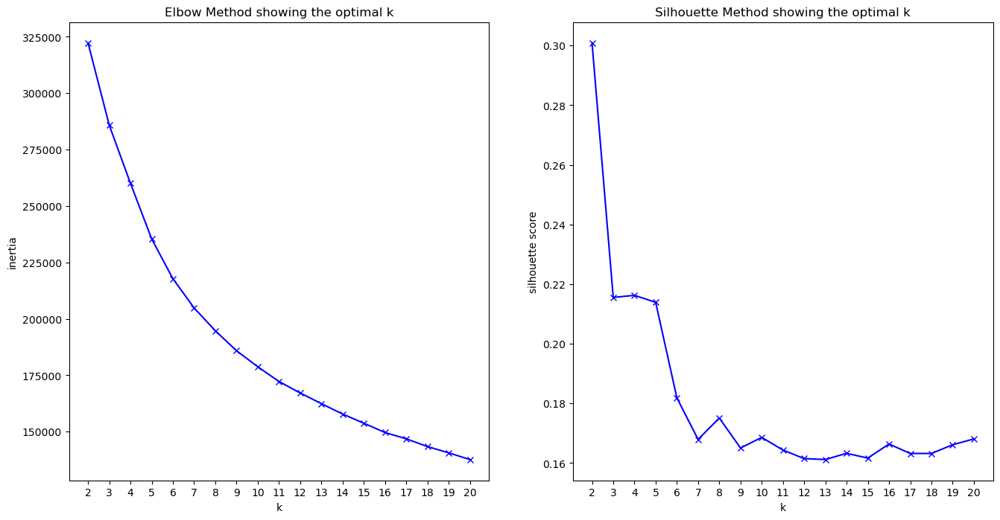

In [133]:
K = range(2, 21)

inertia = []
silhouette = []

for k in K:
    print("Training a K-Means model with {} clusters! ".format(k))
    print()
    kmeans = KMeans(n_clusters=k,
                    random_state=1234,
                    verbose=1)
    kmeans.fit(X_scaled_df)

    inertia.append(kmeans.inertia_)
    silhouette.append(silhouette_score(X_scaled_df, kmeans.predict(X_scaled_df)))


import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

fig, ax = plt.subplots(1,2,figsize=(16,8))
ax[0].plot(K, inertia, 'bx-')
ax[0].set_xlabel('k')
ax[0].set_ylabel('inertia')
ax[0].set_xticks(np.arange(min(K), max(K)+1, 1.0))
ax[0].set_title('Elbow Method showing the optimal k')
ax[1].plot(K, silhouette, 'bx-')
ax[1].set_xlabel('k')
ax[1].set_ylabel('silhouette score')
ax[1].set_xticks(np.arange(min(K), max(K)+1, 1.0))
ax[1].set_title('Silhouette Method showing the optimal k')

## KNNeighbours Regressor: 7 Neighbours

### Using the graph of the silhouette score find the optimal number of neighbours and test them

In [134]:
knn2 = KNeighborsRegressor(n_neighbors=7, weights='distance', algorithm='auto', leaf_size=30)
knn2.fit(X_train_final, y_train) 

KNeighborsRegressor(n_neighbors=7, weights='distance')

In [135]:
with open('../models/knn2_7neighbours_model.pickle', 'wb') as f: 
    pickle.dump(knn2, f)

In [136]:
y_pred_imputed_2 = knn2.predict(X_test_final)

In [137]:
rmse_val = [] 
for K in range(30):
    K = K+1
    model = neighbors.KNeighborsRegressor(n_neighbors = K, weights='distance')

    model.fit(X_train_final, y_train)  
    y_pred_imputed_2 = model.predict(X_test_final)
    error = np.sqrt(mean_squared_error(y_test,y_pred_imputed_2))
    rmse_val.append(error) 
    print('RMSE value for k= ' , K , 'is:', error)

RMSE value for k=  1 is: 939.4291115116433
RMSE value for k=  2 is: 833.2699267900227
RMSE value for k=  3 is: 789.5666011516684
RMSE value for k=  4 is: 770.5751872075725
RMSE value for k=  5 is: 746.929261135708
RMSE value for k=  6 is: 732.5273555590878
RMSE value for k=  7 is: 729.2291273077495
RMSE value for k=  8 is: 729.1008769000653
RMSE value for k=  9 is: 725.6352526433411
RMSE value for k=  10 is: 724.1410740545105
RMSE value for k=  11 is: 724.2205157925966
RMSE value for k=  12 is: 725.5490069984538
RMSE value for k=  13 is: 727.2409654121932
RMSE value for k=  14 is: 727.3419983103494
RMSE value for k=  15 is: 728.0145588620172
RMSE value for k=  16 is: 729.5252540128274
RMSE value for k=  17 is: 730.5512798864422
RMSE value for k=  18 is: 733.2089053587598
RMSE value for k=  19 is: 735.0914980169651
RMSE value for k=  20 is: 737.6502510981938
RMSE value for k=  21 is: 740.1748597525881
RMSE value for k=  22 is: 741.6353584677911
RMSE value for k=  23 is: 742.764318063513

In [138]:
r2 = r2_score(y_test, y_pred_imputed_2)
print("The r2 of the model is: {:.3f}".format(r2))

The r2 of the model is: 0.963


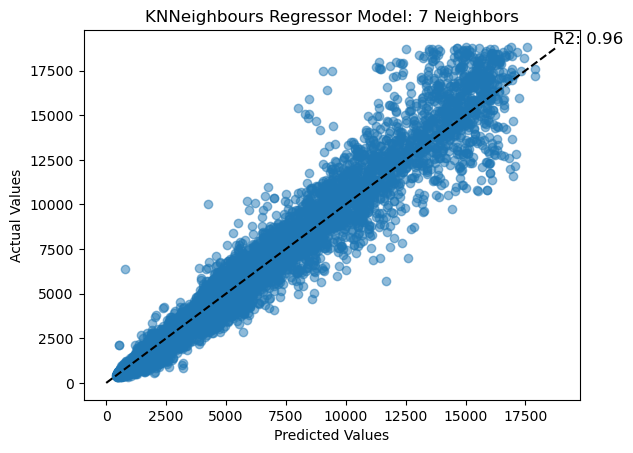

In [139]:
r2 = r2_score(y_test, y_pred_imputed_2)

plt.scatter(y=y_test, x=y_pred_imputed_2, alpha=0.5)

plt.title("KNNeighbours Regressor Model: 7 Neighbors")
plt.xlabel("Predicted Values")
plt.ylabel("Actual Values")

plt.plot([0, max(y_test)], [0, max(y_test)], '--k')

plt.text(max(y_test)+0.2*(max(y_pred_imputed_2)-max(y_test)), max(y_test)-0.2*(max(y_pred_imputed_2)-max(y_test)), 'R2: {:.2f}'.format(r2), fontsize=12, color='black')

plt.show()

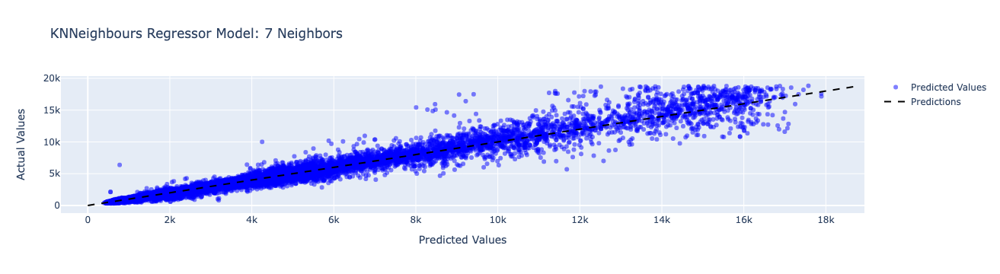

In [140]:
fig = go.Figure()

fig.add_trace(go.Scatter(y=y_test, x=y_pred_imputed_2, mode='markers',
                         marker=dict(color='blue', opacity=0.5),
                         name='Predicted Values'))

fig.add_trace(go.Scatter(x=[0, max(y_test)], y=[0, max(y_test)],
                         mode='lines', line=dict(color='black', dash='dash'),
                         name='Predictions'))

fig.update_layout(title='KNNeighbours Regressor Model: 7 Neighbors',
                  xaxis_title='Predicted Values', yaxis_title='Actual Values')
fig.show()

### KNNeighbours Regressor: 8 Neighbours

In [141]:
knn3 = KNeighborsRegressor(n_neighbors=8, weights='distance', algorithm='auto', leaf_size=30)
knn3.fit(X_train_final, y_train) 

KNeighborsRegressor(n_neighbors=8, weights='distance')

In [142]:
with open('../models/knn3_8neighbours_model.pickle', 'wb') as f: 
    pickle.dump(knn3, f)

In [143]:
y_pred_imputed_3 = knn3.predict(X_test_final)

In [144]:
rmse_val = [] 
for K in range(30):
    K = K+1
    model = neighbors.KNeighborsRegressor(n_neighbors = K, weights='distance')

    model.fit(X_train_final, y_train)  
    y_pred_imputed_3 = model.predict(X_test_final)
    error = np.sqrt(mean_squared_error(y_test,y_pred_imputed_3))
    rmse_val.append(error) 
    print('RMSE value for k= ' , K , 'is:', error)

RMSE value for k=  1 is: 939.4291115116433
RMSE value for k=  2 is: 833.2699267900227
RMSE value for k=  3 is: 789.5666011516684
RMSE value for k=  4 is: 770.5751872075725
RMSE value for k=  5 is: 746.929261135708
RMSE value for k=  6 is: 732.5273555590878
RMSE value for k=  7 is: 729.2291273077495
RMSE value for k=  8 is: 729.1008769000653
RMSE value for k=  9 is: 725.6352526433411
RMSE value for k=  10 is: 724.1410740545105
RMSE value for k=  11 is: 724.2205157925966
RMSE value for k=  12 is: 725.5490069984538
RMSE value for k=  13 is: 727.2409654121932
RMSE value for k=  14 is: 727.3419983103494
RMSE value for k=  15 is: 728.0145588620172
RMSE value for k=  16 is: 729.5252540128274
RMSE value for k=  17 is: 730.5512798864422
RMSE value for k=  18 is: 733.2089053587598
RMSE value for k=  19 is: 735.0914980169651
RMSE value for k=  20 is: 737.6502510981938
RMSE value for k=  21 is: 740.1748597525881
RMSE value for k=  22 is: 741.6353584677911
RMSE value for k=  23 is: 742.764318063513

In [145]:
r2 = r2_score(y_test, y_pred_imputed_3)
print("The r2 of the model is: {:.3f}".format(r2))

The r2 of the model is: 0.963


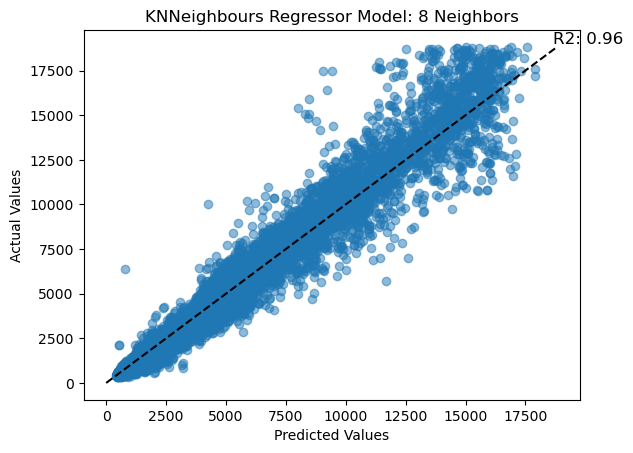

In [146]:
r2 = r2_score(y_test, y_pred_imputed_3)

plt.scatter(y=y_test, x=y_pred_imputed_3, alpha=0.5)

plt.title("KNNeighbours Regressor Model: 8 Neighbors")
plt.xlabel("Predicted Values")
plt.ylabel("Actual Values")

plt.plot([0, max(y_test)], [0, max(y_test)], '--k')

plt.text(max(y_test)+0.2*(max(y_pred_imputed_3)-max(y_test)), max(y_test)-0.2*(max(y_pred_imputed_3)-max(y_test)), 'R2: {:.2f}'.format(r2), fontsize=12, color='black')

plt.show()

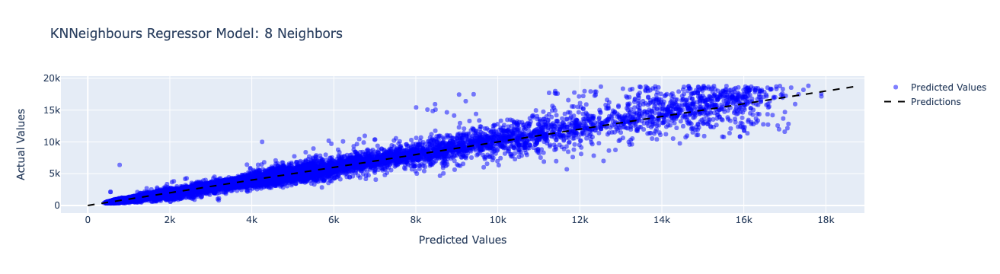

In [147]:
fig = go.Figure()

fig.add_trace(go.Scatter(y=y_test, x=y_pred_imputed_3, mode='markers',
                         marker=dict(color='blue', opacity=0.5),
                         name='Predicted Values'))

fig.add_trace(go.Scatter(x=[0, max(y_test)], y=[0, max(y_test)],
                         mode='lines', line=dict(color='black', dash='dash'),
                         name='Predictions'))

fig.update_layout(title='KNNeighbours Regressor Model: 8 Neighbors',
                  xaxis_title='Predicted Values', yaxis_title='Actual Values')
fig.show()

### KNNeighbours Regressor: 9 Neighbours 

In [148]:
knn4 = KNeighborsRegressor(n_neighbors=9, weights='distance', algorithm='auto', leaf_size=30)
knn4.fit(X_train_final, y_train) 

KNeighborsRegressor(n_neighbors=9, weights='distance')

In [149]:
with open('../models/knn4_9neighbours_model.pickle', 'wb') as f: 
    pickle.dump(knn4, f)

In [150]:
y_pred_imputed_4 = knn4.predict(X_test_final)

In [151]:
rmse_val = [] 
for K in range(30):
    K = K+1
    model = neighbors.KNeighborsRegressor(n_neighbors = K, weights='distance')

    model.fit(X_train_final, y_train)  
    y_pred_imputed_4 = model.predict(X_test_final)
    error = np.sqrt(mean_squared_error(y_test,y_pred_imputed_4))
    rmse_val.append(error) 
    print('RMSE value for k= ' , K , 'is:', error)

RMSE value for k=  1 is: 939.4291115116433
RMSE value for k=  2 is: 833.2699267900227
RMSE value for k=  3 is: 789.5666011516684
RMSE value for k=  4 is: 770.5751872075725
RMSE value for k=  5 is: 746.929261135708
RMSE value for k=  6 is: 732.5273555590878
RMSE value for k=  7 is: 729.2291273077495
RMSE value for k=  8 is: 729.1008769000653
RMSE value for k=  9 is: 725.6352526433411
RMSE value for k=  10 is: 724.1410740545105
RMSE value for k=  11 is: 724.2205157925966
RMSE value for k=  12 is: 725.5490069984538
RMSE value for k=  13 is: 727.2409654121932
RMSE value for k=  14 is: 727.3419983103494
RMSE value for k=  15 is: 728.0145588620172
RMSE value for k=  16 is: 729.5252540128274
RMSE value for k=  17 is: 730.5512798864422
RMSE value for k=  18 is: 733.2089053587598
RMSE value for k=  19 is: 735.0914980169651
RMSE value for k=  20 is: 737.6502510981938
RMSE value for k=  21 is: 740.1748597525881
RMSE value for k=  22 is: 741.6353584677911
RMSE value for k=  23 is: 742.764318063513

In [152]:
r2 = r2_score(y_test, y_pred_imputed_4)
print("The r2 of the model is: {:.3f}".format(r2))

The r2 of the model is: 0.963


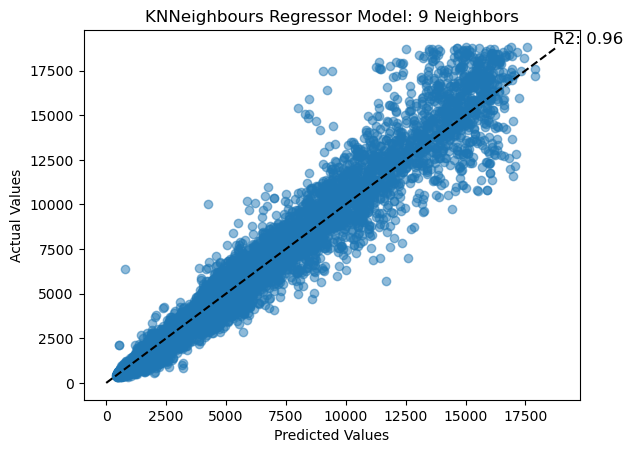

The r2 of the model is: 0.963


In [153]:
r2 = r2_score(y_test, y_pred_imputed_4)

plt.scatter(y=y_test, x=y_pred_imputed_4, alpha=0.5)

plt.title("KNNeighbours Regressor Model: 9 Neighbors")
plt.xlabel("Predicted Values")
plt.ylabel("Actual Values")

plt.plot([0, max(y_test)], [0, max(y_test)], '--k')

plt.text(max(y_test)+0.2*(max(y_pred_imputed_4)-max(y_test)), max(y_test)-0.2*(max(y_pred_imputed_4)-max(y_test)), 'R2: {:.2f}'.format(r2), fontsize=12, color='black')

plt.show()

r2 = r2_score(y_test, y_pred_imputed_4)
print("The r2 of the model is: {:.3f}".format(r2))

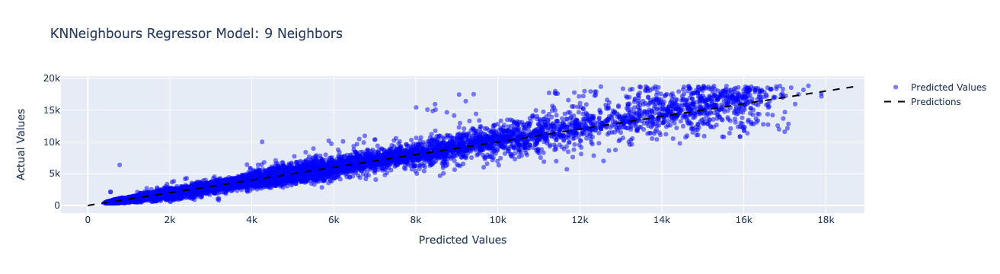

In [154]:
fig = go.Figure()

fig.add_trace(go.Scatter(y=y_test, x=y_pred_imputed_4, mode='markers',
                         marker=dict(color='blue', opacity=0.5),
                         name='Predicted Values'))

fig.add_trace(go.Scatter(x=[0, max(y_test)], y=[0, max(y_test)],
                         mode='lines', line=dict(color='black', dash='dash'),
                         name='Predictions'))

fig.update_layout(title='KNNeighbours Regressor Model: 9 Neighbors',
                  xaxis_title='Predicted Values', yaxis_title='Actual Values')
fig.show()

### KNNeighbours Regressor: 16 Neighbours  

In [155]:
knn5 = KNeighborsRegressor(n_neighbors=16, weights='distance', algorithm='auto', leaf_size=30)
knn5.fit(X_train_final, y_train) 

KNeighborsRegressor(n_neighbors=16, weights='distance')

In [156]:
with open('../models/knn5_16neighbours_model.pickle', 'wb') as f: 
    pickle.dump(knn5, f)

In [157]:
y_pred_imputed_5 = knn5.predict(X_test_final)

In [158]:
rmse_val = [] 
for K in range(30):
    K = K+1
    model = neighbors.KNeighborsRegressor(n_neighbors = K, weights='distance')

    model.fit(X_train_final, y_train)  
    y_pred_imputed_5 = model.predict(X_test_final)
    error = np.sqrt(mean_squared_error(y_test,y_pred_imputed_5))
    rmse_val.append(error) 
    print('RMSE value for k= ' , K , 'is:', error)

RMSE value for k=  1 is: 939.4291115116433
RMSE value for k=  2 is: 833.2699267900227
RMSE value for k=  3 is: 789.5666011516684
RMSE value for k=  4 is: 770.5751872075725
RMSE value for k=  5 is: 746.929261135708
RMSE value for k=  6 is: 732.5273555590878
RMSE value for k=  7 is: 729.2291273077495
RMSE value for k=  8 is: 729.1008769000653
RMSE value for k=  9 is: 725.6352526433411
RMSE value for k=  10 is: 724.1410740545105
RMSE value for k=  11 is: 724.2205157925966
RMSE value for k=  12 is: 725.5490069984538
RMSE value for k=  13 is: 727.2409654121932
RMSE value for k=  14 is: 727.3419983103494
RMSE value for k=  15 is: 728.0145588620172
RMSE value for k=  16 is: 729.5252540128274
RMSE value for k=  17 is: 730.5512798864422
RMSE value for k=  18 is: 733.2089053587598
RMSE value for k=  19 is: 735.0914980169651
RMSE value for k=  20 is: 737.6502510981938
RMSE value for k=  21 is: 740.1748597525881
RMSE value for k=  22 is: 741.6353584677911
RMSE value for k=  23 is: 742.764318063513

In [159]:
r2 = r2_score(y_test, y_pred_imputed_5)
print("The r2 of the model is: {:.3f}".format(r2))

The r2 of the model is: 0.963


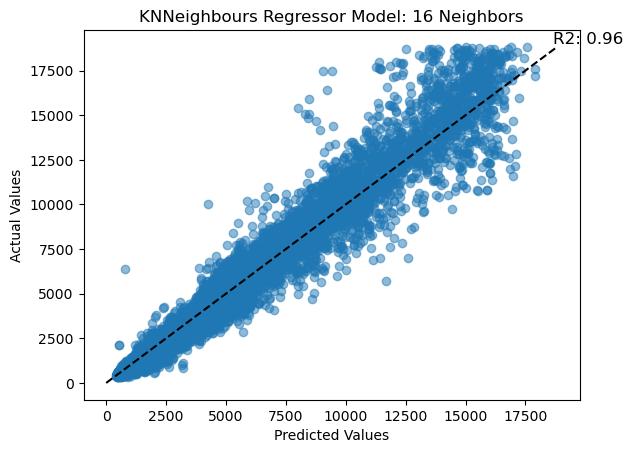

In [160]:
r2 = r2_score(y_test, y_pred_imputed_5)

plt.scatter(y=y_test, x=y_pred_imputed_5, alpha=0.5)

plt.title("KNNeighbours Regressor Model: 16 Neighbors")
plt.xlabel("Predicted Values")
plt.ylabel("Actual Values")

plt.plot([0, max(y_test)], [0, max(y_test)], '--k')

plt.text(max(y_test)+0.2*(max(y_pred_imputed_5)-max(y_test)), max(y_test)-0.2*(max(y_pred_imputed_5)-max(y_test)), 'R2: {:.2f}'.format(r2), fontsize=12, color='black')

plt.show()

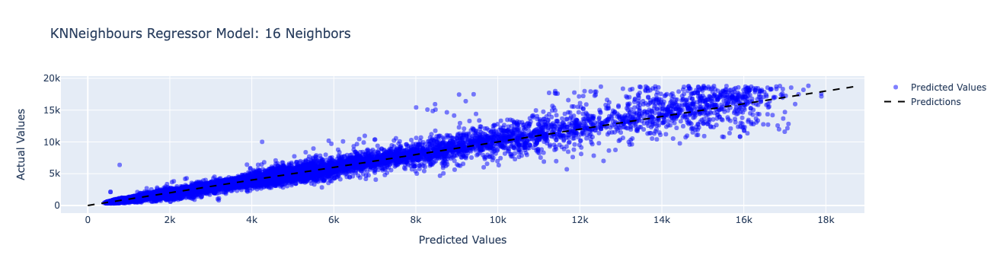

In [161]:
fig = go.Figure()

fig.add_trace(go.Scatter(y=y_test, x=y_pred_imputed_5, mode='markers',
                         marker=dict(color='blue', opacity=0.5),
                         name='Predicted Values'))

fig.add_trace(go.Scatter(x=[0, max(y_test)], y=[0, max(y_test)],
                         mode='lines', line=dict(color='black', dash='dash'),
                         name='Predictions'))

fig.update_layout(title='KNNeighbours Regressor Model: 16 Neighbors',
                  xaxis_title='Predicted Values', yaxis_title='Actual Values')
fig.show()

## Random Forest Regressor 

In [162]:
rf_model = RandomForestRegressor(n_estimators=100, random_state=42)

rf_model.fit(X_train_final, y_train)

y_pred_rf = rf_model.predict(X_test_final)

r2 = r2_score(y_test, y_pred_rf)
print("The r2 of the model is: {:.3f}".format(r2))

The r2 of the model is: 0.975


In [163]:
with open('../models/random_forest.pickle', 'wb') as f: 
    pickle.dump(rf_model, f)

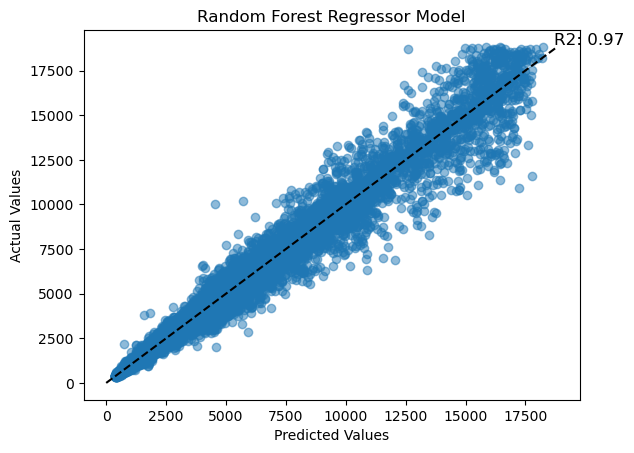

In [164]:
r2 = r2_score(y_test, y_pred_rf)

plt.scatter(y=y_test, x=y_pred_rf, alpha=0.5)

plt.title("Random Forest Regressor Model")
plt.xlabel("Predicted Values")
plt.ylabel("Actual Values")

plt.plot([0, max(y_test)], [0, max(y_test)], '--k')

plt.text(max(y_test)+0.25*(max(y_pred_rf)-max(y_test)), max(y_test)-0.25*(max(y_pred_rf)-max(y_test)), 'R2: {:.2f}'.format(r2), fontsize=12, color='black')

plt.show()

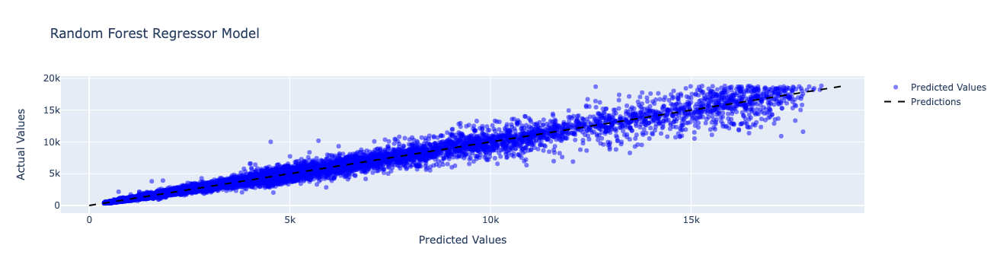

In [165]:
fig = go.Figure()

fig.add_trace(go.Scatter(y=y_test, x=y_pred_rf, mode='markers',
                         marker=dict(color='blue', opacity=0.5),
                         name='Predicted Values'))

fig.add_trace(go.Scatter(x=[0, max(y_test)], y=[0, max(y_test)],
                         mode='lines', line=dict(color='black', dash='dash'),
                         name='Predictions'))

fig.update_layout(title='Random Forest Regressor Model',
                  xaxis_title='Predicted Values', yaxis_title='Actual Values')
fig.show()

## Gradient Boosting Regressor

In [166]:
gb_model = GradientBoostingRegressor(n_estimators=100, random_state=42)

gb_model.fit(X_train_final, y_train)

y_pred_gb = gb_model.predict(X_test_final)

r2 = r2_score(y_test, y_pred_gb)
print("The r2 of the model is: {:.3f}".format(r2))

The r2 of the model is: 0.971


In [167]:
with open('models', 'wb') as f: 
    pickle.dump(gb_model, f)

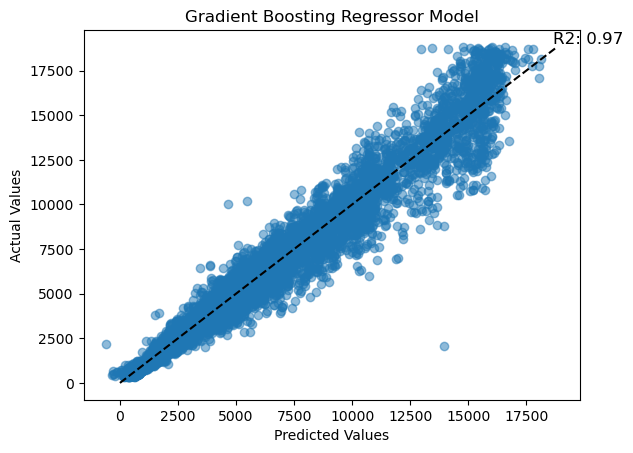

In [168]:
r2 = r2_score(y_test, y_pred_gb)

plt.scatter(y=y_test, x=y_pred_gb, alpha=0.5)

plt.title("Gradient Boosting Regressor Model")
plt.xlabel("Predicted Values")
plt.ylabel("Actual Values")

plt.plot([0, max(y_test)], [0, max(y_test)], '--k')

plt.text(max(y_test)+0.25*(max(y_pred_gb)-max(y_test)), max(y_test)-0.25*(max(y_pred_gb)-max(y_test)), 'R2: {:.2f}'.format(r2), fontsize=12, color='black')

plt.show()

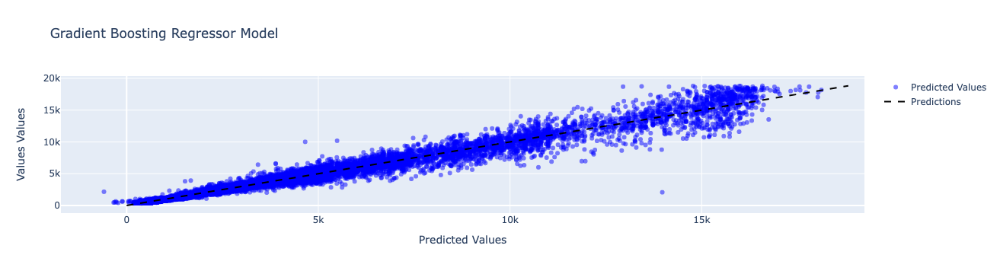

In [169]:
fig = go.Figure()

fig.add_trace(go.Scatter(y=y_test, x=y_pred_gb, mode='markers',
                         marker=dict(color='blue', opacity=0.5),
                         name='Predicted Values'))

fig.add_trace(go.Scatter(x=[0, max(y_test)], y=[0, max(y_test)],
                         mode='lines', line=dict(color='black', dash='dash'),
                         name='Predictions'))

fig.update_layout(title='Gradient Boosting Regressor Model',
                  xaxis_title='Predicted Values', yaxis_title='Values Values')
fig.show()

## Decision Tree Regressor

In [170]:
from sklearn.tree import DecisionTreeRegressor

regr = DecisionTreeRegressor(max_depth=5)
dt_model = regr.fit(X_train_final, y_train)

In [171]:
with open('../models/decisiontree_model.pickle', 'wb') as f: 
    pickle.dump(dt_model, f)

In [172]:
print("The r2 score on the test set: {:.2f} ".format(regr.score(X_train_final, y_train)))
print("The r2 score on the test set: {:.2f}".format(regr.score(X_test_final, y_test)))

The r2 score on the test set: 0.94 
The r2 score on the test set: 0.94


In [173]:
regr = DecisionTreeRegressor(max_depth=10,
                             criterion = 'squared_error',
                             min_samples_split=2,
                             min_samples_leaf = 1,
                             max_features = 6)
regr.fit(X_train, y_train)
print("The r2 score on the test set: {:.2f}".format(regr.score(X_train_final, y_train)))
print("The r2 score on the test set: {:.2f}".format(regr.score(X_test_final, y_test)))

The r2 score on the test set: -0.76
The r2 score on the test set: -0.76


In [174]:
y_pred_dt = dt_model.predict(X_test_final) 

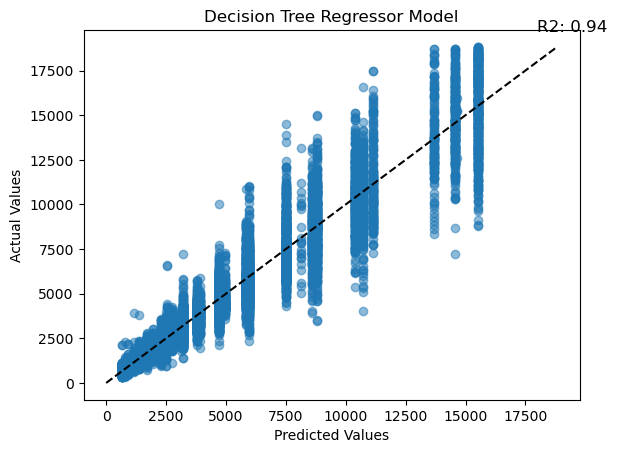

In [175]:
r2 = r2_score(y_test, y_pred_dt)

plt.scatter(y = y_test, x = y_pred_dt, alpha=0.5)

plt.title("Decision Tree Regressor Model")
plt.xlabel("Predicted Values")
plt.ylabel("Actual Values")

plt.plot([0, max(y_test)], [0, max(y_test)], '--k')

plt.text(max(y_test)+0.25*(max(y_pred_dt)-max(y_test)), max(y_test)-0.25*(max(y_pred_dt)-max(y_test)), 'R2: {:.2f}'.format(r2), fontsize=12, color='black')

plt.show()

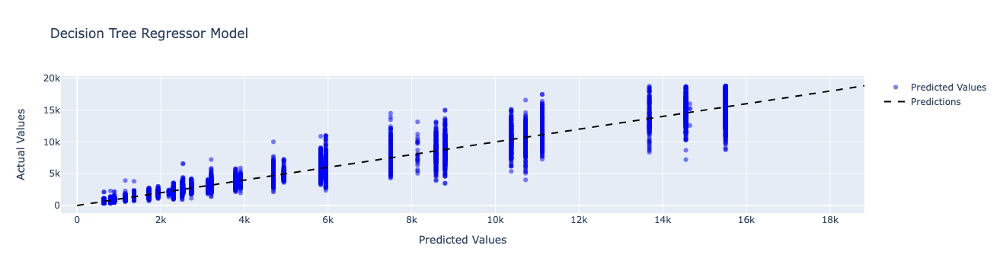

In [176]:
fig = go.Figure()

fig.add_trace(go.Scatter(y=y_test, x=y_pred_dt, mode='markers',
                         marker=dict(color='blue', opacity=0.5),
                         name='Predicted Values'))

fig.add_trace(go.Scatter(x=[0, max(y_test)], y=[0, max(y_test)],
                         mode='lines', line=dict(color='black', dash='dash'),
                         name='Predictions'))

fig.update_layout(title='Decision Tree Regressor Model',
                  xaxis_title='Predicted Values', yaxis_title='Actual Values')
fig.show()

## Finding Best Parameters Using Ensemble Learning

In [177]:
from sklearn.model_selection import GridSearchCV

model = RandomForestRegressor(random_state=42)

param_grid = {
    'n_estimators': [50, 100, 150],
    'max_depth': [5, 10, 15],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4]
}

scoring = 'neg_mean_squared_error'

grid_search = GridSearchCV(estimator=model, param_grid=param_grid, scoring=scoring, cv=5)

scaler = StandardScaler()
X_train_scaled_grid_search = scaler.fit_transform(X_train)
X_test_scaled_grid_search = scaler.transform(X_test)

grid_search.fit(X_train_scaled_grid_search, y_train)

print("Best Hyperparameters: ", grid_search.best_params_)
print("Best Score: ", np.sqrt(-grid_search.best_score_))

y_pred_gs = grid_search.predict(X_test_scaled_grid_search)

Best Hyperparameters:  {'max_depth': 15, 'min_samples_leaf': 1, 'min_samples_split': 10, 'n_estimators': 150}
Best Score:  648.7877782689055


In [178]:
with open('../models/bestparams_model.pickle', 'wb') as f: 
    pickle.dump(model, f)

## Gradient Boosting Regressor Using Best Hyperparameters 

In [179]:
gb_model_gs = GradientBoostingRegressor(max_depth=15, min_samples_leaf=1, min_samples_split=10, n_estimators=150, random_state=42)

scaler = MinMaxScaler()
scaler.fit(X_train)

X_train_gb_gs_scaled = scaler.transform(X_train)
X_test_gb_gs_scaled  = scaler.transform(X_test)

gb_model_gs.fit(X_train_gb_gs_scaled, y_train)

y_pred_gb_gs = gb_model_gs.predict(X_test_gb_gs_scaled)

r2 = r2_score(y_test, y_pred_gb_gs)
print("The r2 of the model is: {:.3f}".format(r2))

The r2 of the model is: 0.972


In [180]:
with open('../models/gradientboosting_bestparams_model.pickle', 'wb') as f: 
    pickle.dump(gb_model_gs, f)

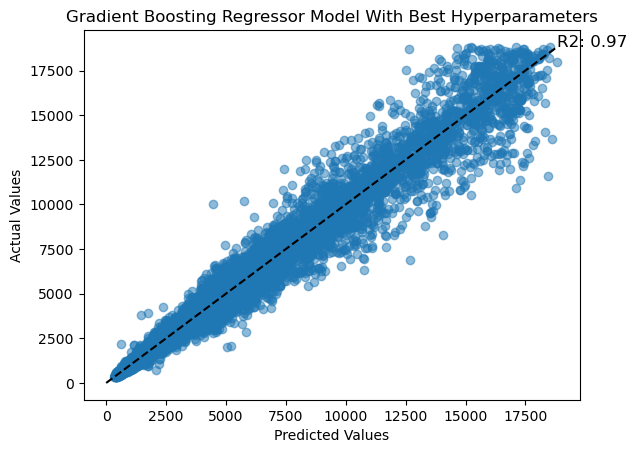

In [181]:
r2 = r2_score(y_test, y_pred_gb_gs)

plt.scatter(y=y_test, x=y_pred_gb_gs, alpha=0.5)

plt.title("Gradient Boosting Regressor Model With Best Hyperparameters")
plt.xlabel("Predicted Values")
plt.ylabel("Actual Values")

plt.plot([0, max(y_test)], [0, max(y_test)], '--k')

plt.text(max(y_test)+0.25*(max(y_pred_gb_gs)-max(y_test)), max(y_test)-0.25*(max(y_pred_gb_gs)-max(y_test)), 'R2: {:.2f}'.format(r2), fontsize=12, color='black')

plt.show()

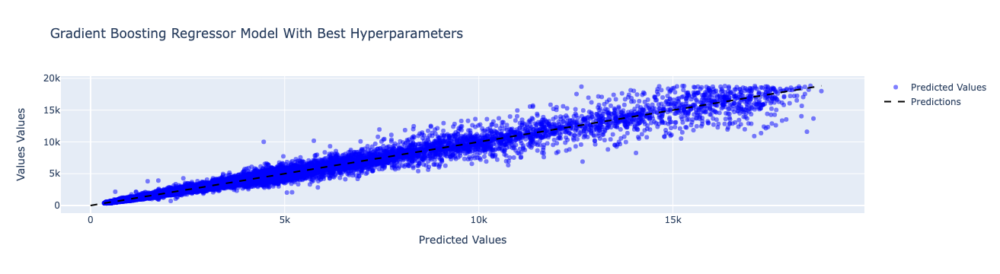

In [182]:
fig = go.Figure()

fig.add_trace(go.Scatter(y=y_test, x=y_pred_gb_gs, mode='markers',
                         marker=dict(color='blue', opacity=0.5),
                         name='Predicted Values'))

fig.add_trace(go.Scatter(x=[0, max(y_test)], y=[0, max(y_test)],
                         mode='lines', line=dict(color='black', dash='dash'),
                         name='Predictions'))

fig.update_layout(title='Gradient Boosting Regressor Model With Best Hyperparameters',
                  xaxis_title='Predicted Values', yaxis_title='Values Values')
fig.show()

## Random Forest Regressor Using Best Hyperparameters 

In [183]:
rf_gs_model = RandomForestRegressor(max_depth=15, min_samples_leaf=1, min_samples_split=10, n_estimators=150, random_state=42)

scaler = MinMaxScaler()
scaler.fit(X_train)

X_train_rf_gs_scaled = scaler.transform(X_train)
X_test_rf_gs_scaled  = scaler.transform(X_test)

rf_gs_model.fit(X_train_rf_gs_scaled, y_train)

y_pred_rf_gs = rf_gs_model.predict(X_test_rf_gs_scaled)

r2 = r2_score(y_test, y_pred_rf_gs)
print("The r2 of the model is: {:.3f}".format(r2))

The r2 of the model is: 0.975


In [184]:
with open('../models/randomforest_bestparams_model.pickle', 'wb') as f: 
    pickle.dump(rf_gs_model, f)

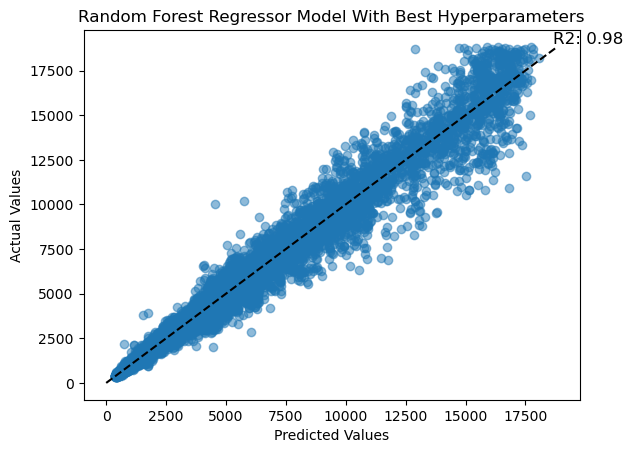

In [185]:
r2 = r2_score(y_test, y_pred_rf_gs)

plt.scatter(y=y_test, x=y_pred_rf_gs, alpha=0.5)

plt.title("Random Forest Regressor Model With Best Hyperparameters")
plt.xlabel("Predicted Values")
plt.ylabel("Actual Values")

plt.plot([0, max(y_test)], [0, max(y_test)], '--k')

plt.text(max(y_test)+0.25*(max(y_pred_rf_gs)-max(y_test)), max(y_test)-0.25*(max(y_pred_rf_gs)-max(y_test)), 'R2: {:.2f}'.format(r2), fontsize=12, color='black')

plt.show()

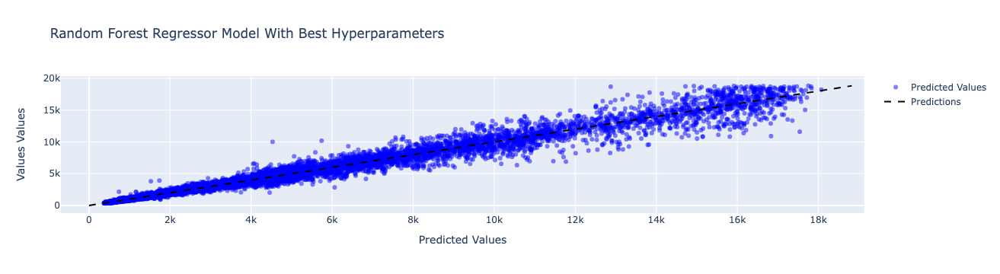

In [186]:
fig = go.Figure()

fig.add_trace(go.Scatter(y=y_test, x=y_pred_rf_gs, mode='markers',
                         marker=dict(color='blue', opacity=0.5),
                         name='Predicted Values'))

fig.add_trace(go.Scatter(x=[0, max(y_test)], y=[0, max(y_test)],
                         mode='lines', line=dict(color='black', dash='dash'),
                         name='Predictions'))

fig.update_layout(title='Random Forest Regressor Model With Best Hyperparameters',
                  xaxis_title='Predicted Values', yaxis_title='Values Values')
fig.show()

## Decision Tree Regressor Using Best Hyperparameters

In [187]:
dt_reg = DecisionTreeRegressor(max_depth=15,
                             criterion = 'squared_error',
                             min_samples_split=10,
                             min_samples_leaf = 1,
                             max_features = 6)

scaler = MinMaxScaler()
scaler.fit(X_train)

X_train_dt_gs_scaled = scaler.transform(X_train)
X_test_dt_gs_scaled  = scaler.transform(X_test)

dt_reg.fit(X_train_dt_gs_scaled, y_train)

print("The r2 score on the train set: {:.2f}".format(dt_reg.score(X_train_dt_gs_scaled, y_train)))
print("The r2 score on the test set: {:.2f}".format(dt_reg.score(X_test_dt_gs_scaled, y_test)))

The r2 score on the train set: 0.99
The r2 score on the test set: 0.96


In [188]:
y_pred_dt_gs = dt_reg.predict(X_test_dt_gs_scaled)

In [189]:
with open('../models/decisiontree_model_best_parameters.pickle', 'wb') as f: 
    pickle.dump(dt_reg, f)

In [190]:
r2 = r2_score(y_test, y_pred_dt_gs)
print("The r2 of the model is: {:.3f}".format(r2))

The r2 of the model is: 0.965


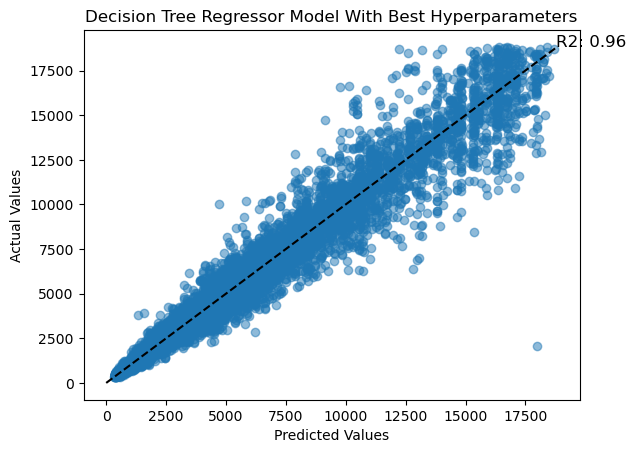

In [191]:
r2 = r2_score(y_test, y_pred_dt_gs)

plt.scatter(y=y_test, x=y_pred_dt_gs, alpha=0.5)

plt.title("Decision Tree Regressor Model With Best Hyperparameters")
plt.xlabel("Predicted Values")
plt.ylabel("Actual Values")

plt.plot([0, max(y_test)], [0, max(y_test)], '--k')

plt.text(max(y_test)+0.25*(max(y_pred_dt_gs)-max(y_test)), max(y_test)-0.25*(max(y_pred_dt_gs)-max(y_test)), 'R2: {:.2f}'.format(r2), fontsize=12, color='black')

plt.show()

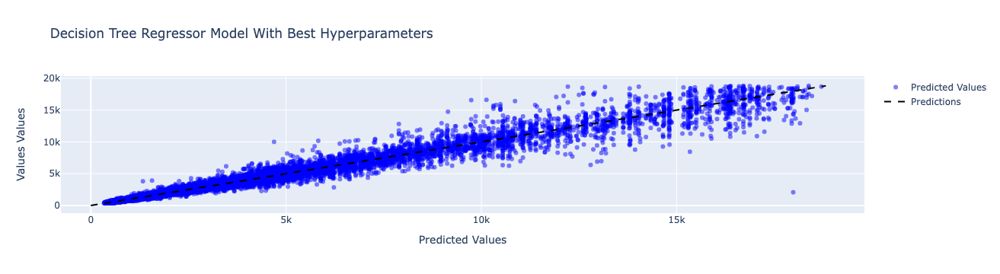

In [192]:
fig = go.Figure()

fig.add_trace(go.Scatter(y=y_test, x=y_pred_dt_gs, mode='markers',
                         marker=dict(color='blue', opacity=0.5),
                         name='Predicted Values'))

fig.add_trace(go.Scatter(x=[0, max(y_test)], y=[0, max(y_test)],
                         mode='lines', line=dict(color='black', dash='dash'),
                         name='Predictions'))

fig.update_layout(title='Decision Tree Regressor Model With Best Hyperparameters',
                  xaxis_title='Predicted Values', yaxis_title='Values Values')
fig.show()

## Neural Networks- MLP (Multi-Layer Perceptron) Regression Model 

In [193]:
from sklearn.neural_network import MLPRegressor
from sklearn.metrics import mean_squared_error, r2_score

# Scale the input features
scaler = StandardScaler()
X_train_nn_scaled = scaler.fit_transform(X_train)
X_test_nn_scaled = scaler.transform(X_test)

# Train the MLP regressor
mlp = MLPRegressor(hidden_layer_sizes=(100, 50), activation='relu', solver='adam',
                   max_iter=500, random_state=42)
mlp.fit(X_train_nn_scaled, y_train)

# Make predictions on the test data
y_pred_nn = mlp.predict(X_test_nn_scaled)

# Evaluate the performance using mean squared error and r2 score
mse = mean_squared_error(y_test, y_pred_nn)
r2 = r2_score(y_test, y_pred_nn)
print("Mean squared error: ", mse)
print("The r2 of the model is: {:.3f}".format(r2))

Mean squared error:  428561.04971047235
The r2 of the model is: 0.973


In [194]:
with open('../models/mlp_model.pickle', 'wb') as f: 
    pickle.dump(mlp, f)

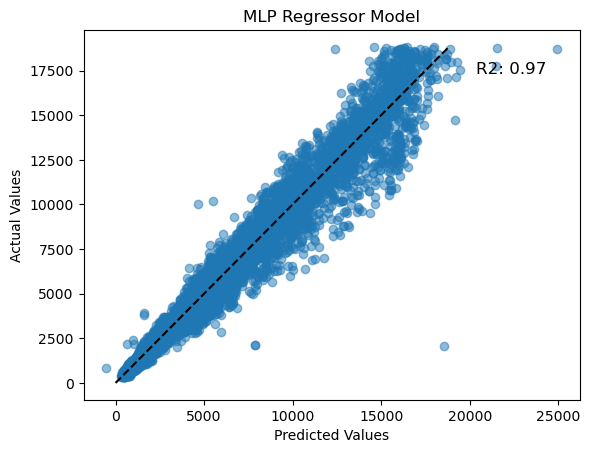

In [195]:
r2 = r2_score(y_test, y_pred_nn)

plt.scatter(y=y_test, x=y_pred_nn, alpha=0.5)

plt.title("MLP Regressor Model")
plt.xlabel("Predicted Values")
plt.ylabel("Actual Values")

plt.plot([0, max(y_test)], [0, max(y_test)], '--k')

plt.text(max(y_test)+0.25*(max(y_pred_nn)-max(y_test)), max(y_test)-0.25*(max(y_pred_nn)-max(y_test)), 'R2: {:.2f}'.format(r2), fontsize=12, color='black')

plt.show()

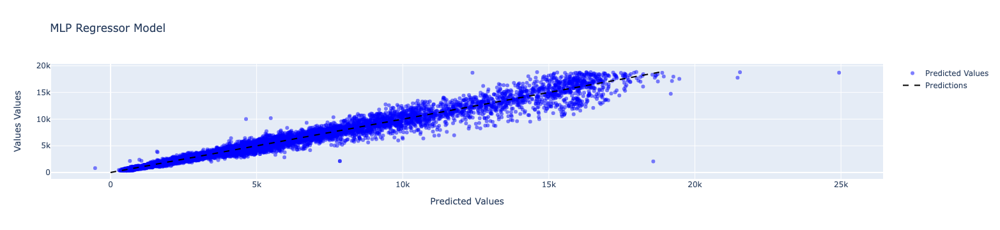

In [196]:
fig = go.Figure()

fig.add_trace(go.Scatter(y=y_test, x=y_pred_nn, mode='markers',
                         marker=dict(color='blue', opacity=0.5),
                         name='Predicted Values'))

fig.add_trace(go.Scatter(x=[0, max(y_test)], y=[0, max(y_test)],
                         mode='lines', line=dict(color='black', dash='dash'),
                         name='Predictions'))

fig.update_layout(title='MLP Regressor Model',
                  xaxis_title='Predicted Values', yaxis_title='Values Values')
fig.show()

## Regularization- L1 (Lasso) & L2 (Ridge) Regularization

### Apply regularization to mitigate against overfitting

### Lasso Regularization (L1 Regularization)

In [197]:
from sklearn.linear_model import Lasso 

lasso = Lasso(alpha=0.1)

lasso.fit(X_train, y_train) 

y_pred = lasso.predict(X_test) 

print("The r2 of the model is:", lasso.score(X_test, y_test))

The r2 of the model is: 0.9042497230734465


In [198]:
with open('../models/l1_reg_model.pickle', 'wb') as f: 
    pickle.dump(lasso, f)

### Ridge Regularization (L2 Regularization) 

In [199]:
from sklearn.linear_model import Ridge 

ridge = Ridge(alpha=0.1) 

ridge.fit(X_train, y_train) 

y_pred = ridge.predict(X_test)

print("The r2 of the model is:", ridge.score(X_test, y_test))

The r2 of the model is: 0.9042538072085935


In [200]:
with open('../models/l2_reg_model.pickle', 'wb') as f: 
    pickle.dump(ridge, f)

## Feature Engineering 

### Transform the data to asssess whether there is model improvement or any other discernible relationships

In [201]:
df_feature_engineering = df.copy() 

df_feature_engineering.head()

,carat,cut,color,clarity,depth,table,price,x,y,z
0,0.23,5,6,2,61.5,55.0,326,3.95,3.98,2.43
1,0.21,4,6,2,59.8,61.0,326,3.89,3.84,2.31
2,0.23,2,6,3,56.9,65.0,327,4.05,4.07,2.31
3,0.29,4,2,3,62.4,58.0,334,4.20,4.23,2.63
4,0.31,2,1,2,63.3,58.0,335,4.34,4.35,2.75


In [202]:
df_feature_engineering['price_per_carat'] = (df_feature_engineering['price'] / df_feature_engineering['carat']).round(3)
df_feature_engineering['price_per_cut'] = (df_feature_engineering['price'] / df_feature_engineering['cut']).round(3)
df_feature_engineering['price_per_color'] = (df_feature_engineering['price'] / df_feature_engineering['color']).round(3)
df_feature_engineering['price_per_clarity'] = (df_feature_engineering['price'] / df_feature_engineering['clarity']).round(3)
df_feature_engineering['total_depth_by_price'] = (df_feature_engineering['price'] / df_feature_engineering['depth']).round(3)
df_feature_engineering['table_by_price'] = (df_feature_engineering['price'] / df_feature_engineering['table']).round(3)
df_feature_engineering['length_by_price'] = (df_feature_engineering['price'] / df_feature_engineering['x']).round(3)
df_feature_engineering['width_by_price'] = (df_feature_engineering['price'] / df_feature_engineering['y']).round(3)
df_feature_engineering['depth_by_price'] = (df_feature_engineering['price'] / df_feature_engineering['z']).round(3)

In [203]:
df_feature_engineering.head()

,carat,cut,color,clarity,depth,table,price,x,y,z,price_per_carat,price_per_cut,price_per_color,price_per_clarity,total_depth_by_price,table_by_price,length_by_price,width_by_price,depth_by_price
0,0.23,5,6,2,61.5,55.0,326,3.95,3.98,2.43,1417.391,65.2,54.333,163.000,5.301,5.927,82.532,81.910,134.156
1,0.21,4,6,2,59.8,61.0,326,3.89,3.84,2.31,1552.381,81.5,54.333,163.000,5.452,5.344,83.805,84.896,141.126
2,0.23,2,6,3,56.9,65.0,327,4.05,4.07,2.31,1421.739,163.5,54.500,109.000,5.747,5.031,80.741,80.344,141.558
3,0.29,4,2,3,62.4,58.0,334,4.20,4.23,2.63,1151.724,83.5,167.000,111.333,5.353,5.759,79.524,78.960,126.996
4,0.31,2,1,2,63.3,58.0,335,4.34,4.35,2.75,1080.645,167.5,335.000,167.500,5.292,5.776,77.189,77.011,121.818


In [204]:
df_feature_engineering = df_feature_engineering.drop(['carat', 'cut', 'color', 'clarity', 'depth', 'table', 'x', 'y', 'z'], axis=1)

In [205]:
df_feature_engineering.head()

,price,price_per_carat,price_per_cut,price_per_color,price_per_clarity,total_depth_by_price,table_by_price,length_by_price,width_by_price,depth_by_price
0,326,1417.391,65.2,54.333,163.000,5.301,5.927,82.532,81.910,134.156
1,326,1552.381,81.5,54.333,163.000,5.452,5.344,83.805,84.896,141.126
2,327,1421.739,163.5,54.500,109.000,5.747,5.031,80.741,80.344,141.558
3,334,1151.724,83.5,167.000,111.333,5.353,5.759,79.524,78.960,126.996
4,335,1080.645,167.5,335.000,167.500,5.292,5.776,77.189,77.011,121.818


In [206]:
new_cols = ['price', 'price_per_carat', 'price_per_cut', 'price_per_color',
       'price_per_clarity', 'total_depth_by_price', 'table_by_price', 'length_by_price', 'width_by_price',
       'depth_by_price']

df_feature_engineering = df_feature_engineering.reindex(columns=new_cols)

df_feature_engineering.head()

,price,price_per_carat,price_per_cut,price_per_color,price_per_clarity,total_depth_by_price,table_by_price,length_by_price,width_by_price,depth_by_price
0,326,1417.391,65.2,54.333,163.000,5.301,5.927,82.532,81.910,134.156
1,326,1552.381,81.5,54.333,163.000,5.452,5.344,83.805,84.896,141.126
2,327,1421.739,163.5,54.500,109.000,5.747,5.031,80.741,80.344,141.558
3,334,1151.724,83.5,167.000,111.333,5.353,5.759,79.524,78.960,126.996
4,335,1080.645,167.5,335.000,167.500,5.292,5.776,77.189,77.011,121.818


In [207]:
X_fe = df_feature_engineering.drop(['price'], axis=1)  
y_fe = df_feature_engineering['price'] 

In [208]:
X_train_fe, X_test_fe, y_train_fe, y_test_fe = train_test_split(X_fe, y_fe, test_size=0.3, random_state=42)

In [209]:
inf_mask = np.isinf(X_train_fe)
print(inf_mask.any())

price_per_carat         False
price_per_cut           False
price_per_color         False
price_per_clarity       False
total_depth_by_price    False
table_by_price          False
length_by_price          True
width_by_price           True
depth_by_price           True
dtype: bool


In [210]:
inf_mask = np.isinf(X_test_fe)
print(inf_mask.any())

price_per_carat         False
price_per_cut           False
price_per_color         False
price_per_clarity       False
total_depth_by_price    False
table_by_price          False
length_by_price          True
width_by_price           True
depth_by_price           True
dtype: bool


In [211]:
cols_with_inf = X_train_fe.columns[np.isinf(X_train_fe).any()].tolist()
cols_with_inf

['length_by_price', 'width_by_price', 'depth_by_price']

In [212]:
for col in cols_with_inf:
    col_max = np.max(np.isfinite(X_train_fe[col]))
    X_train_fe[col][np.isinf(X_train_fe[col])] = col_max 

/var/folders/zh/vb5lf3750v95681z25hzkm9c0000gn/T/ipykernel_57626/1548972431.py:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/zh/vb5lf3750v95681z25hzkm9c0000gn/T/ipykernel_57626/1548972431.py:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [213]:
for col in cols_with_inf:
    col_max = np.max(np.isfinite(X_test_fe[col]))
    X_test_fe[col][np.isinf(X_test_fe[col])] = col_max 

/var/folders/zh/vb5lf3750v95681z25hzkm9c0000gn/T/ipykernel_57626/2587681772.py:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/zh/vb5lf3750v95681z25hzkm9c0000gn/T/ipykernel_57626/2587681772.py:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [214]:
X_train_fe = X_train_fe.apply(pd.to_numeric, errors='coerce')
X_train_fe.isna().sum()

price_per_carat         0
price_per_cut           0
price_per_color         0
price_per_clarity       0
total_depth_by_price    0
table_by_price          0
length_by_price         0
width_by_price          0
depth_by_price          0
dtype: int64

In [215]:
X_test_fe = X_test_fe.apply(pd.to_numeric, errors='coerce')
X_train_fe.isna().sum()

price_per_carat         0
price_per_cut           0
price_per_color         0
price_per_clarity       0
total_depth_by_price    0
table_by_price          0
length_by_price         0
width_by_price          0
depth_by_price          0
dtype: int64

In [216]:
X_train_fe = X_train_fe.reset_index(drop=True)
X_test_fe = X_test_fe.reset_index(drop=True)

In [217]:
# Have to scale and process the data again as done previously to prepare it for model training   

scaler = MinMaxScaler()
scaler.fit(X_train_fe)

X_train_fe_scaled = scaler.transform(X_train_fe)
X_test_fe_scaled  = scaler.transform(X_test_fe)

X_train_fe_final_scaled = pd.DataFrame(X_train_fe_scaled, columns =X_train_fe.columns)
X_test_fe_final_scaled = pd.DataFrame(X_test_fe_scaled, columns =X_test_fe.columns)

In [218]:
model_fe = LinearRegression()
model_fe.fit(X_train_fe_final_scaled, y_train_fe)

LinearRegression()

In [219]:
with open('../models/feature_engineering_model.pickle', 'wb') as f: 
    pickle.dump(model_fe, f)

In [220]:
y_pred_train_fe_scaled = model_fe.predict(X_train_fe_final_scaled) 
y_pred_test_fe_scaled = model_fe.predict(X_test_fe_final_scaled) 
r2_score_train_fe = r2_score(y_pred_train_fe_scaled, y_train_fe)
r2_score_test_fe = r2_score(y_pred_test_fe_scaled, y_test_fe)

In [221]:
r2 = r2_score(y_test_fe, y_pred_test_fe_scaled)
mae = mean_absolute_error(y_test_fe, y_pred_test_fe_scaled)
mse = mean_squared_error(y_test_fe, y_pred_test_fe_scaled)
rmse = np.sqrt(mse)

print("The r2 of the model for the test set is: {:.3f}".format(r2))
print("The mean absolute error of the model for the test set is: {:.3f}".format(mae))
print("The mean squared error of the model for the test set is: {:.3f}".format(mse))
print("The root mean squared error of the model for the test set is: {:.3f}".format(rmse))

The r2 of the model for the test set is: 1.000
The mean absolute error of the model for the test set is: 35.965
The mean squared error of the model for the test set is: 4075.264
The root mean squared error of the model for the test set is: 63.838


In [222]:
r2 = r2_score(y_train_fe, y_pred_train_fe_scaled)
mae = mean_absolute_error(y_train_fe, y_pred_train_fe_scaled)
mse = mean_squared_error(y_train_fe, y_pred_train_fe_scaled)
rmse = np.sqrt(mse)

print("The r2 of the model for the train set is: {:.3f}".format(r2))
print("The mean absolute error of the model for the train set is: {:.3f}".format(mae))
print("The mean squared error of the model for the train set is: {:.3f}".format(mse))
print("The root mean squared error of the model for the train set is: {:.3f}".format(rmse))

The r2 of the model for the train set is: 1.000
The mean absolute error of the model for the train set is: 36.301
The mean squared error of the model for the train set is: 4872.717
The root mean squared error of the model for the train set is: 69.805


In [223]:
y_pred_fe = model_fe.predict(X_test_fe_final_scaled)

In [224]:
predictions = model_fe.predict(X_test_fe_final_scaled)
model_fe.score(X_test_fe_final_scaled, y_test) 

0.999738697494096

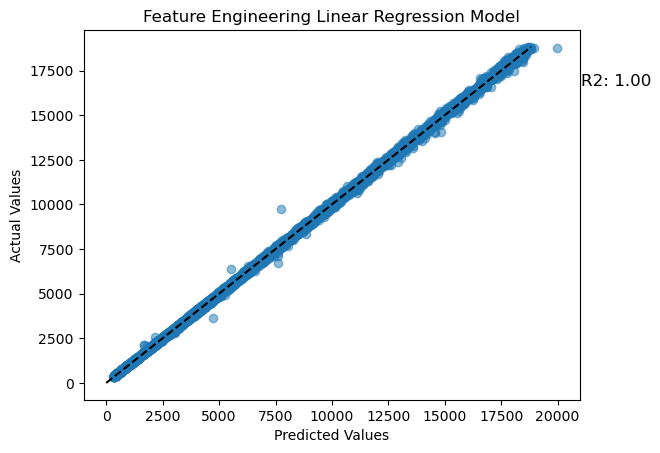

In [225]:
r2 = r2_score(y_test, y_pred_fe)

plt.scatter(y = y_test, x = y_pred_fe, alpha=0.5)

plt.title("Feature Engineering Linear Regression Model")
plt.xlabel("Predicted Values")
plt.ylabel("Actual Values")

plt.plot([0, max(y_test)], [0, max(y_test)], '--k')

plt.text(max(y_test)+1.9*(max(y_pred_fe)-max(y_test)), max(y_test)-1.9*(max(y_pred_fe)-max(y_test)), 'R2: {:.2f}'.format(r2), fontsize=12, color='black')

plt.show()

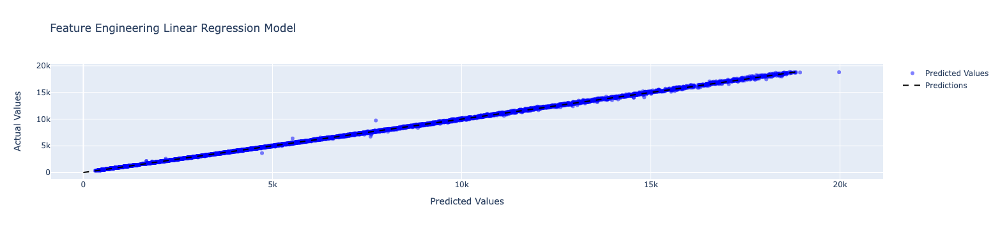

In [226]:
fig = go.Figure()

fig.add_trace(go.Scatter(y=y_test, x=y_pred_fe, mode='markers',
                         marker=dict(color='blue', opacity=0.5),
                         name='Predicted Values'))

fig.add_trace(go.Scatter(x=[0, max(y_test)], y=[0, max(y_test)],
                         mode='lines', line=dict(color='black', dash='dash'),
                         name='Predictions'))

fig.update_layout(title='Feature Engineering Linear Regression Model',
                  xaxis_title='Predicted Values', yaxis_title='Actual Values')
fig.show()

### Feature Selection

In [227]:
from sklearn.feature_selection import SelectKBest
from sklearn.feature_selection import chi2

scaler = MinMaxScaler()
X_train_scaled_feature_selection = scaler.fit_transform(X_train)
X_test_scaled_feature_selection = scaler.transform(X_test)

selector = SelectKBest(chi2, k=4) 
X_train_selected = selector.fit_transform(X_train_scaled_feature_selection, y_train)
X_test_selected = selector.transform(X_test_scaled_feature_selection)

selected_feature_names = X.columns[selector.get_support(indices=True)]

model = LinearRegression()
model.fit(X_train_selected, y_train)

y_pred_fs = model.predict(X_test_selected)
mse = mean_squared_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)

print("The r2 of the model is: {:.3f}".format(r2))
print("The mean absolute error of the model is: {:.3f}".format(mae))
print("The mean squared error of the model is: {:.3f}".format(mse))
print("The root mean squared error of the model is: {:.3f}".format(rmse))

The r2 of the model is: 0.904
The mean absolute error of the model is: 36.301
The mean squared error of the model is: 1493254.114
The root mean squared error of the model is: 69.805


In [228]:
with open('../models/feature_selection_model.pickle', 'wb') as f: 
    pickle.dump(model, f)

In [229]:
predictions = model.predict(X_test_selected)
model.score(X_test_selected, y_test) 

0.9009525573224262

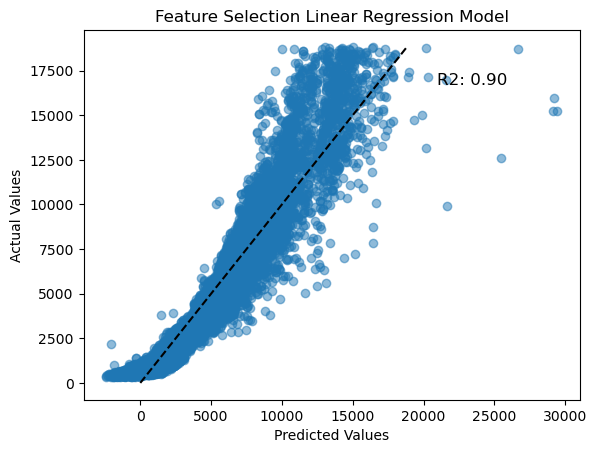

In [230]:
r2 = r2_score(y_test, y_pred_fs)

plt.scatter(y=y_test, x=y_pred_fs, alpha=0.5)

plt.title("Feature Selection Linear Regression Model")
plt.xlabel("Predicted Values")
plt.ylabel("Actual Values")

plt.plot([0, max(y_test)], [0, max(y_test)], '--k')

plt.text(max(y_test)+0.2*(max(y_pred_fs)-max(y_test)), max(y_test)-0.2*(max(y_pred_fs)-max(y_test)), 'R2: {:.2f}'.format(r2), fontsize=12, color='black')

plt.show()

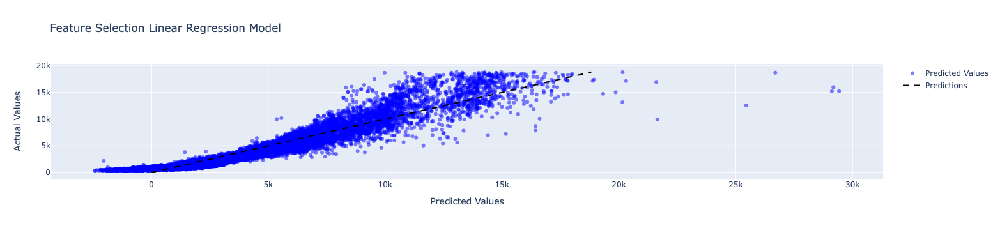

In [231]:
fig = go.Figure()

fig.add_trace(go.Scatter(y=y_test, x=y_pred_fs, mode='markers',
                         marker=dict(color='blue', opacity=0.5),
                         name='Predicted Values'))

fig.add_trace(go.Scatter(x=[0, max(y_test)], y=[0, max(y_test)],
                         mode='lines', line=dict(color='black', dash='dash'),
                         name='Predictions'))

fig.update_layout(title='Feature Selection Linear Regression Model',
                  xaxis_title='Predicted Values', yaxis_title='Actual Values')
fig.show()

## Hypothesis Testing- the "Null Hypothesis" (H0) assumes there is no significant relationships between variables, the "Alternative Hypothesis" (H1) is the opposite of the Null Hypothesis

### Null Hypothesis (H0): Dimensions (length, width and depth) have no impact on a diamond's price 
### Alternative Hypothesis (H1): Dimensions (length, width and depth) have an impact on a diamond's price 

In [232]:
import statsmodels.api as sm

X = df[['x', 'y', 'z']]
y = df['price']

X = sm.add_constant(X)
model = sm.OLS(y, X).fit()

with open('../models/hypothesis1_model.pickle', 'wb') as f: 
    pickle.dump(model, f)
    
print(model.summary())

ttest = model.t_test(np.array([0, 1, 0, 0]).reshape(1,-1))
tvalue = ttest.tvalue[0][0]
pvalue = ttest.pvalue

if pvalue < 0.05:
    print('Reject null hypothesis for "width"')
else:
    print('Fail to reject null hypothesis for "width"')

ttest = model.t_test(np.array([0, 0, 1, 0]).reshape(1,-1))
tvalue = ttest.tvalue[0][0]
pvalue = ttest.pvalue

if pvalue < 0.05:
    print('Reject null hypothesis for "depth"')
else:
    print('Fail to reject null hypothesis for "depth"')

ttest = model.t_test(np.array([0, 0, 0, 1]).reshape(1,-1))
tvalue = ttest.tvalue[0][0]
pvalue = ttest.pvalue

if pvalue < 0.05:
    print('Reject null hypothesis for "length"')
else:
    print('Fail to reject null hypothesis for "length"')

                            OLS Regression Results                            
Dep. Variable:                  price   R-squared:                       0.783
Model:                            OLS   Adj. R-squared:                  0.783
Method:                 Least Squares   F-statistic:                 6.470e+04
Date:                Thu, 09 Mar 2023   Prob (F-statistic):               0.00
Time:                        12:19:15   Log-Likelihood:            -4.8263e+05
No. Observations:               53940   AIC:                         9.653e+05
Df Residuals:                   53936   BIC:                         9.653e+05
Df Model:                           3                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const      -1.411e+04     41.763   -337.936      0.0

### Null Hypothesis (H0): Carats, total depth percentage (total depth percentage = z / mean(x, y) = 2 * z / (x + y)), and table (width of top of diamond relative to widest point) have no impact on a diamond's price 
### Alternative Hypothesis (H1): Carats, total depth percentage (total depth percentage = z / mean(x, y) = 2 * z / (x + y)), and table (width of top of diamond relative to widest point) have an impact on a diamond's price 

In [233]:
X = df[['carat', 'depth', 'table']]
y = df['price']

X = sm.add_constant(X)
model = sm.OLS(y, X).fit()

with open('../models/hypothesis2_model.pickle', 'wb') as f: 
    pickle.dump(model, f)

print(model.summary())

ttest = model.t_test(np.array([0, 1, 0, 0]).reshape(1,-1))
tvalue = ttest.tvalue[0][0]
pvalue = ttest.pvalue

if pvalue < 0.05:
    print('Reject null hypothesis for "total depth percentage"')
else:
    print('Fail to reject null hypothesis for "total depth percentage"')

ttest = model.t_test(np.array([0, 0, 1, 0]).reshape(1,-1))
tvalue = ttest.tvalue[0][0]
pvalue = ttest.pvalue

if pvalue < 0.05:
    print('Reject null hypothesis for "table"')
else:
    print('Fail to reject null hypothesis for "table"')

ttest = model.t_test(np.array([0, 0, 0, 1]).reshape(1,-1))
tvalue = ttest.tvalue[0][0]
pvalue = ttest.pvalue

if pvalue < 0.05:
    print('Reject null hypothesis for "carat"')
else:
    print('Fail to reject null hypothesis for "carat"')

                            OLS Regression Results                            
Dep. Variable:                  price   R-squared:                       0.854
Model:                            OLS   Adj. R-squared:                  0.854
Method:                 Least Squares   F-statistic:                 1.049e+05
Date:                Thu, 09 Mar 2023   Prob (F-statistic):               0.00
Time:                        12:19:15   Log-Likelihood:            -4.7194e+05
No. Observations:               53940   AIC:                         9.439e+05
Df Residuals:                   53936   BIC:                         9.439e+05
Df Model:                           3                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         1.3e+04    390.918     33.264      0.0

## Diamond Quote Predictor
### Create an application that effectively provides an estimated quote for a diamond using multiple machine learning models and basing the prediction on the values inputted by the user 

In [ ]:
# scaler = StandardScaler()
X_train_scaled_predictor = scaler.fit_transform(X_train)
X_test_scaled_predictor = scaler.transform(X_test)

# Model 1- Stacking: Gradient Boosting and Random Forest Regressor
gb = GradientBoostingRegressor(max_depth=15, min_samples_leaf=1, min_samples_split=10, n_estimators=150, random_state=42)
gb.fit(X_train_scaled_predictor, y_train)

rf = RandomForestRegressor(max_depth=15, min_samples_leaf=1, min_samples_split=10, n_estimators=150, random_state=42)
rf.fit(X_train_scaled_predictor, y_train)

gb_pred = gb.predict(X_test_scaled_predictor)
rf_pred = rf.predict(X_test_scaled_predictor)

X_stacked = np.column_stack((gb_pred, rf_pred, X_test_scaled_predictor))

stacked_model = LinearRegression()
stacked_model.fit(X_stacked, y_test)

# Model 2- Random Forest Regressor
rf_model = RandomForestRegressor(max_depth=15, min_samples_leaf=1, min_samples_split=10, n_estimators=150, random_state=42)

rf_model.fit(X_train_scaled_predictor, y_train)

# Model 3- Gradient Boosting 
gb_model = GradientBoostingRegressor(max_depth=15, min_samples_leaf=1, min_samples_split=10, n_estimators=150, random_state=42)

gb_model.fit(X_train_scaled_predictor, y_train)

# Model 4- KNNeighbours Regressor 
knn2 = KNeighborsRegressor(n_neighbors=7, weights='distance', algorithm='auto', leaf_size=30)
knn2.fit(X_train_scaled_predictor, y_train)

# Train the MLP regressor
mlp = MLPRegressor(hidden_layer_sizes=(100, 50), activation='relu', solver='adam',
                   max_iter=500, random_state=0)
mlp.fit(X_train_scaled_predictor, y_train)

valid_input = False
while not valid_input:
    try:
        carat = float(input("Enter the carat weight of the diamond: "))
        cut = int(input("Enter the cut of the diamond (1-5): "))
        color = int(input("Enter the color of the diamond (1-7): "))
        clarity = int(input("Enter the clarity of the diamond (1-5): "))
        depth = float(input("Enter the total depth percentage of the diamond: "))
        table = float(input("Enter the table of the diamond: "))
        x = float(input("Enter the length of the diamond: "))
        y = float(input("Enter the width of the diamond: "))
        z = float(input("Enter the depth of the diamond: "))
        
        # Check if inputs are valid
        if (1 <= cut <= 5 and 1 <= color <= 7 and 1 <= clarity <= 5 and
            0 < depth < 100 and 0 < table < 100 and x > 0 and y > 0 and z > 0):
            valid_input = True
        else:
            print("Invalid input values, please check your input and try again.")
    except ValueError:
        print("Wrong input- check your input and try again")

# Create the "new_data" a dataframe with the valid inputs

new_data = pd.DataFrame({
    'carat': [carat],
    'cut': [cut],
    'color': [color],
    'clarity': [clarity],
    'depth': [depth],
    'table': [table],
    'x': [x],
    'y': [y],
    'z': [z]
})

# Use the "new_data" dataframe to make predictions
        
new_data = pd.DataFrame({
    'carat': [carat],
    'cut': [cut],
    'color': [color],
    'clarity': [clarity],
    'depth': [depth],
    'table': [table],
    'x': [x],
    'y': [y],
    'z': [z]
})

# Remove feature names to avoid UserWarning
new_data.columns = None

# Make a prediction using Model 1 (Stacked Model- Gradient Boosting and Random Forest, R2 Score: 0.976)
X_new = new_data.copy()
gb_pred = gb.predict(X_new)
rf_pred = rf.predict(X_new)
X_stacked = np.column_stack((gb_pred, rf_pred, X_new))
y_pred1 = stacked_model.predict(X_stacked)[0]

# Make a prediction using Model 2 (Random Forest, R2 Score: 0.975)
y_pred2 = rf_model.predict(X_new)[0]

# Make a prediction using Model 3 (Gradient Boosting, R2 Score: 0.972)
y_pred3 = gb_model.predict(X_new)[0]

# Make a prediction using Model 4 (KNNeighbours: 7 Neighbours, R2 Score: 0.963)
y_pred4 = knn2.predict(X_new)[0]

#Make a prediction using Model 5 (MLP Neural Network: R2 Score: 0.97)
y_pred5 = mlp.predict(X_new)[0]

# Aggregate the predictions
y_pred = (y_pred1 + y_pred2 + y_pred3 + y_pred4 + y_pred5) / 5

# Present the result
print("The predicted price of the diamond is: {:.2f}".format(y_pred))